# COVID-19 DATA ANALYSIS 

Name - Debanjan Das. <br>
Student Number - 17202833. <br>
Project completed under the supervision of Professor Barry Smith with adequate guidance from Elayne Ruane, Pheobe Wenyi Sun and Abeba Birhane. 

# Content And Approach

* <b>Introduction </b>
  1. Age Distribution of affected people.
  2. List of the countries most impacted.
  3. Comparison of New cases, deaths and recoveries over time.
  
* <b>Research Question 1: What are some factors that affect the severity of Covid-19 outbreak within a country? </b>
  
  1. Data Collection (Various factors) and Visualization.
     * Doctors Per 1000
     * Beds Per 1000
     * Cases Per Million
     * Testing Per 1000 (Initial)
     * Deaths Per Million
     * Population % of countries aged > 70
     * World Testing Levels (Current)
     * Mean Temperature 
     * Drop in Mobility in Countries
     * Population Density of Countries
  2. Collective Analysis.
     * Checking Co-relation of different factors 
     * Seperating datasets of countries based on testing levels and checking their growth rates.
     * Observing the impact of various factors on countries.
     * Plotting scatter plots for every observation. 
     * Performing Multiple Linear Regression on the dataset to observe the factors with high impact.
  3. Case Study.
     * Germany Vs Italy 
     * France Vs Iran 
     * Effect of Testing on Number of cases per day.
     
* <b>Research Question 2: Have lockdown and social distancing measures reduced the number of novel cases globally? </b>
  
  1. Data Collection and Visualization.
     * Datasets collected for every country. 
     * Datasets divided on the basis of before and lockdown.
     * Comparison made between those datasets through effective visualizations.
     * A time series visualization has been produced showing the growth rate for every country.
  2. Collective Analysis.
     * A dataset has been produced having the growth rates before and after lockdown.
     * Time taken to implement a lockdown has also been taken into account.
     * Multiple observations have been made based on the data.
     
* <b>Research Question 3: Why has there been a sharp rise in the number of cases in US? </b>
  
  1. Data Collection and Visualization.
     * Collecting Mobility Data of US from csv file parsed from Google Mobility Report.
     * Read Population Dataset for every state.
     * Reading US Cases and Deaths from John Hopkins Git Repository.
     * Extracting testing data for US states from an API (The Covid Tracking Project)
  2. Collective Analysis
     * Calculating Growth Rate, recovery and death rate for states. 
     * Putting all variables in one dataframe and comparing each of them through scatter plots.
     * Checking if the observations (Testing and Mobility) made in RQ 1 and 2 holds true in United States.
     * Detailed Analysis of Testing and Drop in Mobility in United States. 
     
  
* <b>Conclusion </b>
  
  1. Ethical Considerations.
  2. Data Reproducibility and Data Quality.
  3. Final Conclusion.
  

In [1]:
# Importing all packages needed for this project.

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import time
from sklearn.linear_model import LinearRegression, BayesianRidge
from sklearn.model_selection import RandomizedSearchCV, train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error
import datetime

In [2]:
from urllib.request import urlopen
from bs4 import BeautifulSoup

## Introduction:


What's the situation like across the globe? Let's have a look at the age distribution of affected people and also the list of highly affected countries.



In [3]:
# Reading CSV
corona_cases = pd.read_csv('latestdata.csv')
corona_cases.head()

C:\Users\User\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3058: DtypeWarning: Columns (1,2,9,10,12,13,14,15,16,17,19,21,22,23,24,25,26,27,31,32) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,ID,age,sex,city,province,country,latitude,longitude,geo_resolution,date_onset_symptoms,...,date_death_or_discharge,notes_for_discussion,location,admin3,admin2,admin1,country_new,admin_id,data_moderator_initials,travel_history_binary
0,000-1-1,NaN,male,Shek Lei,Hong Kong,China,22.365019,114.133808,point,NaN,...,NaN,NaN,Shek Lei,NaN,NaN,Hong Kong,China,8051.0,NaN,NaN
1,000-1-10,78,male,Vo Euganeo,Veneto,Italy,45.297748,11.658382,point,NaN,...,22.02.2020,NaN,Vo' Euganeo,NaN,NaN,Veneto,Italy,8978.0,NaN,NaN
2,000-1-100,61,female,NaN,NaN,Singapore,1.353460,103.815100,admin0,NaN,...,17.02.2020,NaN,NaN,NaN,NaN,NaN,Singapore,201.0,NaN,NaN
3,000-1-1000,NaN,NaN,Zhengzhou City,Henan,China,34.629310,113.468000,admin2,NaN,...,NaN,NaN,NaN,NaN,Zhengzhou City,Henan,China,10115.0,NaN,NaN
4,000-1-10000,NaN,NaN,Pingxiang City,Jiangxi,China,27.513560,113.902900,admin2,NaN,...,NaN,NaN,NaN,NaN,Pingxiang City,Jiangxi,China,7079.0,NaN,NaN


In [4]:
def clean(x): # Function to clean the dataset
    if x == 'death' or x == 'died' or x == 'Death':
        return 'death'
    elif x == 'discharged' or x=='discharge':
        return 'discharge'
    elif x == 'recovered' or x=='stable':
        return 'recovered'
    else:
        return np.nan

In [5]:
def apply_int(x):# Function to return integer value
    try:
        y = int(x)
        return y
    except:
        return np.nan

## Age Distribution of affected people.

C:\Users\User\Anaconda3\lib\site-packages\statsmodels\nonparametric\kde.py:447: RuntimeWarning: invalid value encountered in greater
  X = X[np.logical_and(X > clip[0], X < clip[1])] # won't work for two columns.
C:\Users\User\Anaconda3\lib\site-packages\statsmodels\nonparametric\kde.py:447: RuntimeWarning: invalid value encountered in less
  X = X[np.logical_and(X > clip[0], X < clip[1])] # won't work for two columns.
C:\Users\User\Anaconda3\lib\site-packages\statsmodels\nonparametric\kde.py:447: RuntimeWarning: invalid value encountered in greater
  X = X[np.logical_and(X > clip[0], X < clip[1])] # won't work for two columns.
C:\Users\User\Anaconda3\lib\site-packages\statsmodels\nonparametric\kde.py:447: RuntimeWarning: invalid value encountered in less
  X = X[np.logical_and(X > clip[0], X < clip[1])] # won't work for two columns.


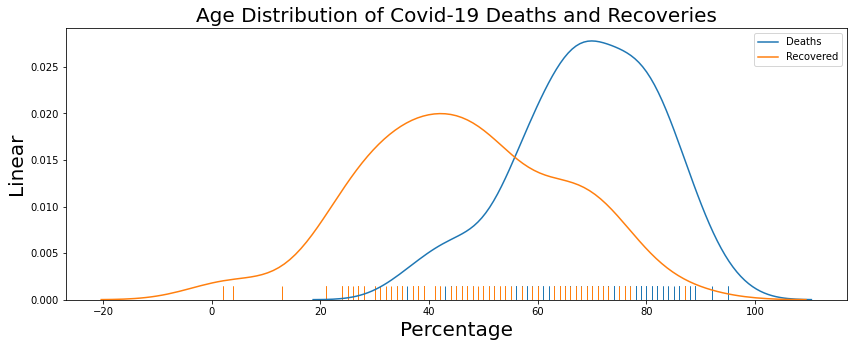

In [6]:
#Plotting a graph to check age distribution for the deaths and recoveries.

import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(14,5))
sns.distplot(corona_cases[corona_cases['outcome'].apply(clean)=='death']
['age'].apply(apply_int),hist=False,rug=True,label='Deaths')
sns.distplot(corona_cases[corona_cases['outcome'].apply(clean)=='recovered']
['age'].apply(apply_int),hist=False,rug=True,label='Recovered')
plt.title('Age Distribution of Covid-19 Deaths and Recoveries', fontsize =20)
plt.xlabel('Age', fontsize =20)
plt.xlabel('Percentage', fontsize =20)
plt.ylabel('Linear', fontsize =20)
plt.legend()
plt.show()

<div style="font-size: 15px">
We can see that people aged around 70-80 have a higher chance of death and while most people aged around 40's have recovered. 
    </div>

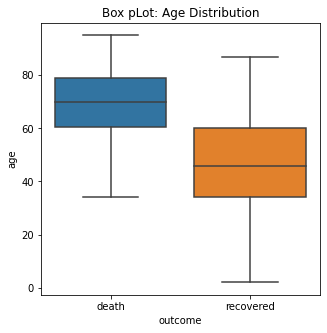

In [8]:
#Plotting a Box Plot 
df1 = pd.DataFrame(corona_cases[corona_cases['outcome'].apply(clean)=='death']['age'].apply(apply_int)).assign(outcome='death')
df2 = pd.DataFrame(corona_cases[corona_cases['outcome'].apply(clean)=='recovered']['age'].apply(apply_int)).assign(outcome='recovered')
cdf = pd.concat([df1, df2])
plt.figure(figsize=(5,5))
plt.title('Box pLot: Age Distribution')
sns.boxplot(x="outcome", y="age", data=cdf)  # RUN PLOT   
plt.show()

In [9]:
covid = pd.read_csv('https://opendata.ecdc.europa.eu/covid19/casedistribution/csv') #Reading a CSV
covid.head()

,dateRep,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2018,continentExp
0,10/05/2020,10,5,2020,255,6,Afghanistan,AF,AFG,37172386.0,Asia
1,09/05/2020,9,5,2020,215,3,Afghanistan,AF,AFG,37172386.0,Asia
2,08/05/2020,8,5,2020,171,2,Afghanistan,AF,AFG,37172386.0,Asia
3,07/05/2020,7,5,2020,168,9,Afghanistan,AF,AFG,37172386.0,Asia
4,06/05/2020,6,5,2020,330,5,Afghanistan,AF,AFG,37172386.0,Asia


In [10]:
covid_2 = covid.groupby('countriesAndTerritories').sum() #Grouping all countries
covid_2 = covid_2.drop(['day', 'month', 'year'], axis=1)
covid_2.head()

,cases,deaths,popData2018
countriesAndTerritories,,,
Afghanistan,4033,115,4.535031e+09
Albania,856,31,1.805817e+08
Algeria,5558,494,5.363010e+09
Andorra,754,48,4.466348e+06
Angola,43,2,1.540488e+09


In [11]:
covid_2 = covid_2.drop(['popData2018'], axis=1)
covid_2 = covid_2.reset_index()
covid_2 = covid_2.sort_values(['cases']).reset_index(drop=True)
#covid_2.filter(["Cases"] > 50)
covid_2 = covid_2[covid_2['cases'] > 50000] #Putting a filter of 50000 cases
covid_2.head()

,countriesAndTerritories,cases,deaths
194,Belgium,52596,8581
195,India,62939,2109
196,Peru,65015,1814
197,Canada,67702,4693
198,China,83991,4637


## List of the countries most impacted.

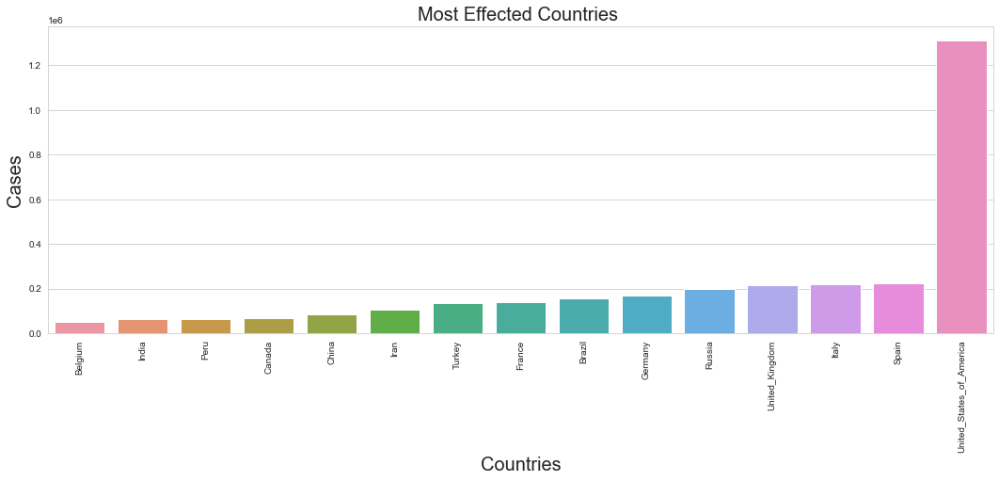

In [12]:
fig = plt.figure(figsize=(18,6))
sns.set_style('whitegrid')
ax = sns.barplot(x=covid_2['countriesAndTerritories'], y=covid_2['cases'])
plt.xticks(rotation=90)
plt.title('Most Effected Countries ', fontsize =20)
plt.xlabel('Countries', fontsize =20)
plt.ylabel('Cases', fontsize =20)
plt.show()

## <b> Comparison of New cases, deaths and recoveries over time. <b>

In [13]:
confirmed_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv')
deaths_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv')
recoveries_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_recovered_global.csv')

In [14]:
confirmed_df ## Shows details of confirmed cases

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
0,NaN,Afghanistan,33.000000,65.000000,0,0,0,0,0,0,...,2171,2335,2469,2704,2894,3224,3392,3563,3778,4033
1,NaN,Albania,41.153300,20.168300,0,0,0,0,0,0,...,773,782,789,795,803,820,832,842,850,856
2,NaN,Algeria,28.033900,1.659600,0,0,0,0,0,0,...,4006,4154,4295,4474,4648,4838,4997,5182,5369,5558
3,NaN,Andorra,42.506300,1.521800,0,0,0,0,0,0,...,745,745,747,748,750,751,751,752,752,754
4,NaN,Angola,-11.202700,17.873900,0,0,0,0,0,0,...,27,30,35,35,35,36,36,36,43,43
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,NaN,Western Sahara,24.215500,-12.885800,0,0,0,0,0,0,...,6,6,6,6,6,6,6,6,6,6
262,NaN,Sao Tome and Principe,0.186360,6.613081,0,0,0,0,0,0,...,14,16,16,16,23,174,174,187,208,208
263,NaN,Yemen,15.552727,48.516388,0,0,0,0,0,0,...,6,7,10,10,12,22,25,25,34,34
264,NaN,Comoros,-11.645500,43.333300,0,0,0,0,0,0,...,1,1,3,3,3,3,8,8,8,11


In [15]:
cols = confirmed_df.keys()
confirmed = confirmed_df.loc[:, cols[4]:cols[-1]]
deaths = deaths_df.loc[:, cols[4]:cols[-1]]
recoveries = recoveries_df.loc[:, cols[4]:cols[-1]]

In [16]:
confirmed

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
0,0,0,0,0,0,0,0,0,0,0,...,2171,2335,2469,2704,2894,3224,3392,3563,3778,4033
1,0,0,0,0,0,0,0,0,0,0,...,773,782,789,795,803,820,832,842,850,856
2,0,0,0,0,0,0,0,0,0,0,...,4006,4154,4295,4474,4648,4838,4997,5182,5369,5558
3,0,0,0,0,0,0,0,0,0,0,...,745,745,747,748,750,751,751,752,752,754
4,0,0,0,0,0,0,0,0,0,0,...,27,30,35,35,35,36,36,36,43,43
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,0,0,0,0,0,0,0,0,0,0,...,6,6,6,6,6,6,6,6,6,6
262,0,0,0,0,0,0,0,0,0,0,...,14,16,16,16,23,174,174,187,208,208
263,0,0,0,0,0,0,0,0,0,0,...,6,7,10,10,12,22,25,25,34,34
264,0,0,0,0,0,0,0,0,0,0,...,1,1,3,3,3,3,8,8,8,11


In [17]:
dates = confirmed.keys()
world_cases = []
total_deaths = [] 
total_recovered = [] 
total_active = [] 

for i in dates:
    confirmed_sum = confirmed[i].sum()
    death_sum = deaths[i].sum()
    recovered_sum = recoveries[i].sum()
    world_cases.append(confirmed_sum)  #List of cases everyday 
    total_deaths.append(death_sum) # List of deaths everyday
    total_recovered.append(recovered_sum) # List of recoveries everyday
    total_active.append(confirmed_sum-death_sum-recovered_sum)

In [18]:
days_since_1_22 = np.array([i for i in range(len(dates))]).reshape(-1, 1)
world_cases = np.array(world_cases).reshape(-1, 1)
total_deaths = np.array(total_deaths).reshape(-1, 1)
total_recovered = np.array(total_recovered).reshape(-1, 1)

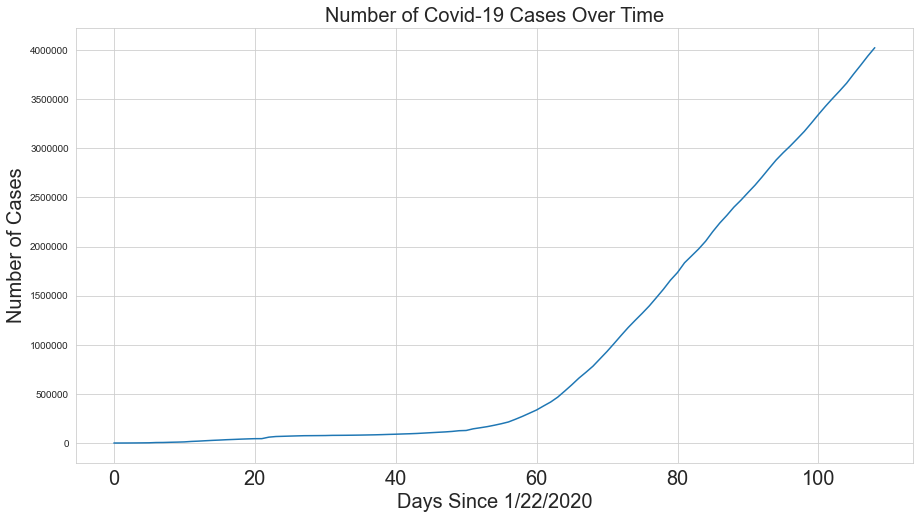

In [19]:
# Plotting a graph of covid-19 cases over time
plt.figure(figsize=(15, 8))
plt.plot(days_since_1_22, world_cases)
plt.title('Number of Covid-19 Cases Over Time', size=20)
plt.xlabel('Days Since 1/22/2020', size=20)
plt.ylabel('Number of Cases', size=20)
plt.xticks(size=20)
plt.ticklabel_format(style = 'plain')
plt.show()

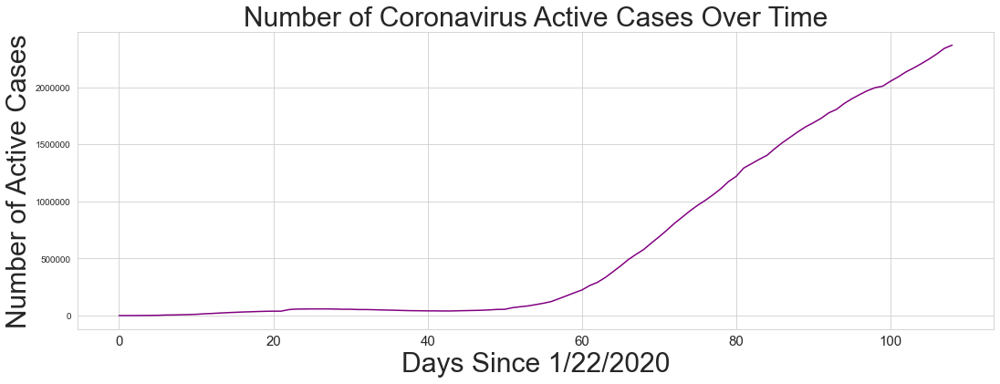

In [20]:
# Plotting a graph of active covid-19 cases over time
plt.figure(figsize=(18, 6))
plt.plot(days_since_1_22, total_active, color='purple')
plt.title('Number of Coronavirus Active Cases Over Time', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('Number of Active Cases', size=30)
plt.xticks(size=15)
plt.ticklabel_format(style = 'plain')
plt.show()

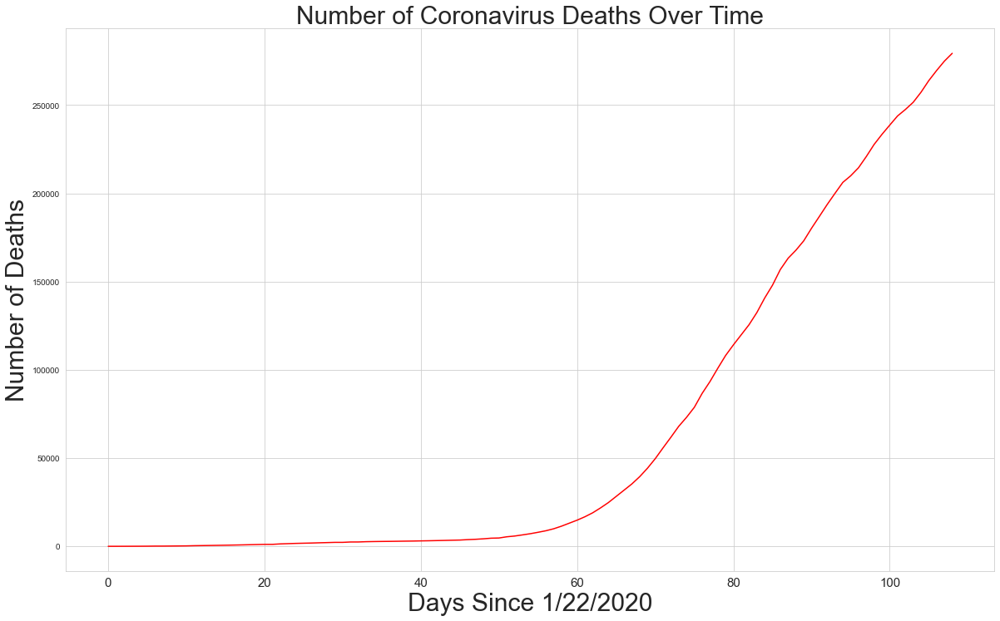

In [21]:
# Plotting a graph of covid-19 deaths over time
plt.figure(figsize=(20, 12))
plt.plot(days_since_1_22, total_deaths, color='red')
plt.title('Number of Coronavirus Deaths Over Time', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('Number of Deaths', size=30)
plt.xticks(size=15)
plt.ticklabel_format(style = 'plain')
plt.show()

In [22]:
rates = confirmed_df.copy()
rates.drop(rates.iloc[:, 0:4], inplace = True, axis = 1)
rates.loc['Total']= rates.sum()
rates = rates.iloc[len(rates)-1:]
rates =rates.T[rates.any()].T
rates

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
Total,555,654,941,1434,2118,2927,5578,6166,8234,9927,...,3256910,3343777,3427584,3506729,3583055,3662691,3756069,3845718,3938064,4024009


In [23]:
recov_rates = recoveries.copy()
recov_rates.loc['Total']= recov_rates.sum()
recov_rates = recov_rates.iloc[len(recov_rates)-1:]
recov_rates =recov_rates.T[recov_rates.any()].T
recov_rates

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
Total,28,30,36,39,52,61,107,126,143,222,...,1013886,1052415,1093137,1125236,1162724,1198832,1245413,1284741,1322050,1375624


In [24]:
death_rates = deaths.copy()
death_rates.loc['Total']= death_rates.sum()
death_rates = death_rates.iloc[len(death_rates)-1:]
death_rates =death_rates.T[death_rates.any()].T
death_rates

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
Total,17,18,26,42,56,82,131,133,171,213,...,233360,238619,243813,247470,251537,257239,263855,269567,274898,279311


In [25]:
rates2 = rates.copy()
column_list = []
length = len(rates2.columns)
for i in range(length):
    if(i>0):
        rates2.iloc[0,i] = rates2.iloc[0,i] - rates.iloc[0,i-1] # Getting the number of new cases per day
        

In [26]:
recov_rates2 = recov_rates.copy()
column_list = []
length = len(recov_rates2.columns)
for i in range(length):
    if(i>0):
        recov_rates2.iloc[0,i] = recov_rates2.iloc[0,i] - recov_rates.iloc[0,i-1] # Getting the number of new recoveries per day

In [27]:
death_rates2 = death_rates.copy()
column_list = []
length = len(death_rates2.columns)
for i in range(length):
    if(i>0):
        death_rates2.iloc[0,i] = death_rates2.iloc[0,i] - death_rates.iloc[0,i-1] # Getting the number of new deaths per day

In [28]:
World_cases = []
recovered_cases = []
death_cases = []
dates = rates2.keys()

for i in dates:
    confirmed_sum_World = rates2[i].sum()
    World_cases.append(confirmed_sum_World)
    recovered_sum_World = recov_rates2[i].sum()
    recovered_cases.append(recovered_sum_World)
    death_sum_World = death_rates2[i].sum()
    death_cases.append(death_sum_World)
    

In [29]:
World_dates = np.array([i for i in range(len(dates))]).reshape(-1, 1)

Text(0, 0.5, 'Number of New Cases')

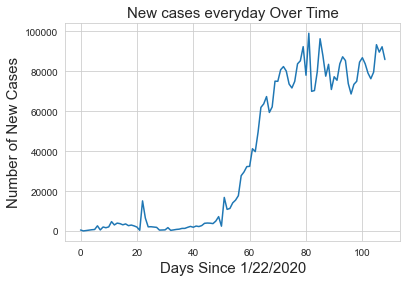

In [30]:
plt.plot(World_dates, World_cases)
plt.title('New cases everyday Over Time', size=15)
plt.xlabel('Days Since 1/22/2020', size=15)
plt.ylabel('Number of New Cases', size=15)


A glimpse of hope as the number of new cases per day has stopped increasing on a large scale. Major factors contributing to this would be discussed later in this project. 

Text(0, 0.5, '# of New Cases')

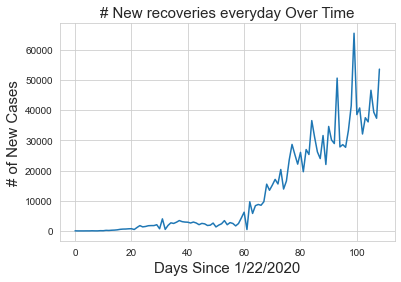

In [31]:
plt.plot(World_dates, recovered_cases)
plt.title('# New recoveries everyday Over Time', size=15)
plt.xlabel('Days Since 1/22/2020', size=15)
plt.ylabel('# of New Cases', size=15)

Text(0, 0.5, '# of New Cases')

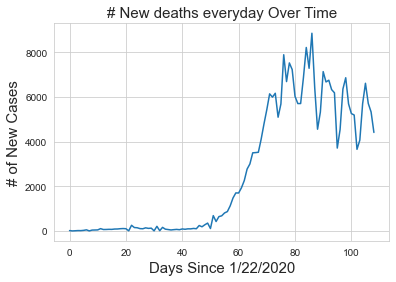

In [32]:
plt.plot(World_dates, death_cases)
plt.title('# New deaths everyday Over Time', size=15)
plt.xlabel('Days Since 1/22/2020', size=15)
plt.ylabel('# of New Cases', size=15)

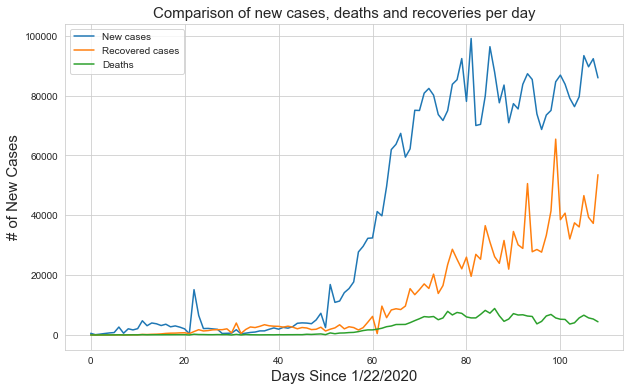

In [33]:
plt.figure(figsize = (10,6))
plt.plot(World_dates, World_cases)
plt.plot(World_dates, recovered_cases)
plt.plot(World_dates, death_cases)
plt.title('Comparison of new cases, deaths and recoveries per day', size=15)
plt.xlabel('Days Since 1/22/2020', size=15)
plt.ylabel('# of New Cases', size=15)
plt.legend(['New cases', 'Recovered cases', 'Deaths'])

A quick comparison of new cases, death and recoveries per day.

# <B> Research Question 1: What are some factors that affect the severity of Covid-19 outbreak within a country? <B>

## Data Collection and Visualization

In [34]:
doctor_per_1000 = pd.read_csv('doctors.csv') # Reading a csv file to look into the health care capacity for every country
doctor_per_1000 = doctor_per_1000.drop(['Code'], axis=1)
doctor_per_1000.head()

,Entity,Year,"Physicians (per 1,000 people) (per 1,000 people)"
0,Afghanistan,1960,0.035
1,Afghanistan,1965,0.063
2,Afghanistan,1970,0.065
3,Afghanistan,1981,0.077
4,Afghanistan,1986,0.183


In [35]:
doctor = doctor_per_1000.groupby('Entity').agg(
    
    Year=('Year', max),
    
)
doctor

,Year
Entity,
Afghanistan,2016
Albania,2013
Algeria,2010
American Samoa,1999
Andorra,2015
...,...
Vietnam,2016
World,2013
Yemen,2014


In [36]:
# Transforming the table to make sure only the latest data is taken into account 

doctor = doctor.reset_index()
doctor["Physicians (per 1,000 people)"] = ''

doctorlist = []
for i,rows in doctor.iterrows():
    for j,row in doctor_per_1000.iterrows():
        if rows['Entity'] == row['Entity'] and rows['Year'] == row['Year']:
            rows['Physicians (per 1,000 people)'] = row['Physicians (per 1,000 people) (per 1,000 people)']
            doctorlist.append([rows['Physicians (per 1,000 people)']])
            
            
doctor['Physicians (per 1,000 people)'] = doctorlist

In [37]:
#Making the column numeric 
doctor['Physicians (per 1,000 people)'] = pd.to_numeric(doctor["Physicians (per 1,000 people)"].str[0], errors='ignore')
doctor

,Entity,Year,"Physicians (per 1,000 people)"
0,Afghanistan,2016,0.295000
1,Albania,2013,1.286000
2,Algeria,2010,1.207000
3,American Samoa,1999,0.781000
4,Andorra,2015,3.690000
...,...,...,...
248,Vietnam,2016,0.821000
249,World,2013,1.489021
250,Yemen,2014,0.311000
251,Zambia,2016,0.091000


In [38]:
def doctors(str): # Function to return the number of doctors 
     val = doctor.loc[doctor['Entity'] == str, 'Physicians (per 1,000 people)']
        
     return(val.to_numpy()) 

In [39]:
doctor = doctor.reset_index()
doctors("Vietnam")

array([0.821])

In [40]:
import geopandas as gpd # importing a package to see a world map visualization
#Read shapefile using Geopandas
gdf = gpd.read_file('Countries_WGS84.shp')[['CNTRY_NAME', 'geometry']]
#Rename columns.
gdf.columns = ['country', 'geometry']
gdf

,country,geometry
0,Aruba,"POLYGON ((-69.88223 12.41111, -69.94695 12.436..."
1,Antigua and Barbuda,"MULTIPOLYGON (((-61.73889 17.54055, -61.75195 ..."
2,Afghanistan,"POLYGON ((61.27656 35.60725, 61.29638 35.62853..."
3,Algeria,"POLYGON ((-5.15213 30.18047, -5.13917 30.19236..."
4,Azerbaijan,"MULTIPOLYGON (((45.02583 41.03055, 45.00999 41..."
...,...,...
246,Western Samoa,"MULTIPOLYGON (((-172.59650 -13.50911, -172.551..."
247,Swaziland,"POLYGON ((30.89944 -26.77195, 30.88028 -26.793..."
248,Yemen,"MULTIPOLYGON (((48.68639 14.03750, 48.61000 14..."
249,Zambia,"POLYGON ((30.21302 -14.98172, 30.21917 -15.096..."


In [41]:
gdf = gdf.drop(gdf.index[14])
merged = gdf.merge(doctor, left_on = 'country', right_on = 'Entity')
import json
#Read data to json.
merged_json = json.loads(merged.to_json())
#Convert to String like object.
json_data = json.dumps(merged_json)

In [42]:
merged

,country,geometry,index,Entity,Year,"Physicians (per 1,000 people)"
0,Aruba,"POLYGON ((-69.88223 12.41111, -69.94695 12.436...",10,Aruba,1995,1.120
1,Antigua and Barbuda,"MULTIPOLYGON (((-61.73889 17.54055, -61.75195 ...",6,Antigua and Barbuda,1999,0.158
2,Afghanistan,"POLYGON ((61.27656 35.60725, 61.29638 35.62853...",0,Afghanistan,2016,0.295
3,Algeria,"POLYGON ((-5.15213 30.18047, -5.13917 30.19236...",2,Algeria,2010,1.207
4,Azerbaijan,"MULTIPOLYGON (((45.02583 41.03055, 45.00999 41...",13,Azerbaijan,2014,3.402
...,...,...,...,...,...,...
181,Namibia,"POLYGON ((14.52485 -22.69207, 14.52740 -22.667...",160,Namibia,2010,0.374
182,Swaziland,"POLYGON ((30.89944 -26.77195, 30.88028 -26.793...",222,Swaziland,2009,0.147
183,Yemen,"MULTIPOLYGON (((48.68639 14.03750, 48.61000 14...",250,Yemen,2014,0.311
184,Zambia,"POLYGON ((30.21302 -14.98172, 30.21917 -15.096...",251,Zambia,2016,0.091


In [43]:
from bokeh.io import output_notebook, show, output_file
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar
from bokeh.palettes import brewer
#Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = json_data)
#Define a sequential multi-hue color palette.
palette = brewer['YlGnBu'][8]
#Reverse color order so that dark blue is highest obesity.
palette = palette[::-1]
#Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
color_mapper = LinearColorMapper(palette = palette, low = 0, high = 6)
#Define custom tick labels for color bar.
tick_labels = {'0': '0', '1': '1', '2':'2', '3':'3', '4':'4', '5':'5', '6':'>6'}
#Create color bar. 
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels)
#Create figure object.
p = figure(title = 'Number of doctors per 1000 people, 2014', plot_height = 600 , plot_width = 950, toolbar_location = None)
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None
#Add patch renderer to figure. 
p.patches('xs','ys', source = geosource,fill_color = {'field' :'Physicians (per 1,000 people)', 'transform' : color_mapper},
          line_color = 'black', line_width = 0.25, fill_alpha = 1)
#Specify figure layout.
p.add_layout(color_bar, 'below')
#Display figure inline in Jupyter Notebook.
output_notebook()
#Display figure.
show(p)

Loading BokehJS ...

<b> A quick visualization to check the healthcare capacity in countries. A comparison would be made later in relation to how effected these countries have been. </b>

In [44]:
beds_per_1000 = pd.read_csv('hospital-beds-per-1000-people.csv') # Reading a csv file to check availability of hospital beds
beds_per_1000

,Entity,Code,Year,"Hospital beds (per 1,000 people) (per 1,000 people)"
0,Afghanistan,AFG,1960,0.170627
1,Afghanistan,AFG,1970,0.199000
2,Afghanistan,AFG,1981,0.275600
3,Afghanistan,AFG,1987,0.309100
4,Afghanistan,AFG,1990,0.249800
...,...,...,...,...
3523,Zimbabwe,ZWE,1985,1.393600
3524,Zimbabwe,ZWE,1987,1.940800
3525,Zimbabwe,ZWE,1990,0.510500
3526,Zimbabwe,ZWE,2006,3.000000


In [46]:
beds = beds_per_1000.groupby('Entity').agg(
    
    Year=('Year', max),
   
)
beds

,Year
Entity,
Afghanistan,2012
Albania,2012
Algeria,2004
Andorra,2009
Angola,2005
...,...
Vietnam,2010
World,2005
Yemen,2012


In [47]:
#Transforming the table to make sure only latest data has been taken into account (Drawback: takes 3 minutes to run)
beds = beds.reset_index()
beds["hospital_beds"] = ''

bedlist = []
for i,rows in beds.iterrows():
    for j,row in beds_per_1000.iterrows():
        if rows['Entity'] == row['Entity'] and rows['Year'] == row['Year']:
            rows['hospital_beds'] = row['Hospital beds (per 1,000 people) (per 1,000 people)']
            bedlist.append([rows['hospital_beds']])
            
            
beds['hospital_beds'] = bedlist

In [48]:
beds["hospital_beds"] = pd.to_numeric(beds["hospital_beds"].str[0], errors='ignore') # Making the column numeric 
beds

,Entity,Year,hospital_beds
0,Afghanistan,2012,0.500000
1,Albania,2012,2.600000
2,Algeria,2004,1.700000
3,Andorra,2009,2.500000
4,Angola,2005,0.800000
...,...,...,...
240,Vietnam,2010,2.000000
241,World,2005,2.919069
242,Yemen,2012,0.700000
243,Zambia,2010,2.000000


In [49]:
def hospital_beds(str): # A function to return the number of hospital beds per 1000 people for a country
     val = beds.loc[beds['Entity'] == str, 'hospital_beds']
        
     return(val.to_numpy()) 

In [50]:
hospital_beds("Afghanistan")

array([0.5])

In [51]:
merged2 = gdf.merge(beds, left_on = 'country', right_on = 'Entity')

In [52]:
import json
#Read data to json.
merged_json2 = json.loads(merged2.to_json())
#Convert to String like object.
json_data2 = json.dumps(merged_json2)

In [53]:
from bokeh.io import output_notebook, show, output_file
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar
from bokeh.palettes import brewer
#Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = json_data2)
#Define a sequential multi-hue color palette.
palette = brewer['YlGnBu'][8]
#Reverse color order so that dark blue is highest obesity.
palette = palette[::-1]
#Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
color_mapper = LinearColorMapper(palette = palette, low = 0, high = 15)
#Define custom tick labels for color bar.
tick_labels = {'0': '0', '1': '1', '3':'3', '5':'5', '7':'7', '9':'9', '9':'9','11':'11','15':'>15'}
#Create color bar. 
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels)
#Create figure object.
p = figure(title = 'Number of hospital beds per 1000 people, 2014', plot_height = 600 , plot_width = 950, toolbar_location = None)
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None
#Add patch renderer to figure. 
p.patches('xs','ys', source = geosource,fill_color = {'field' :'hospital_beds', 'transform' : color_mapper},
          line_color = 'black', line_width = 0.25, fill_alpha = 1)
#Specify figure layout.
p.add_layout(color_bar, 'below')
#Display figure inline in Jupyter Notebook.
output_notebook()
#Display figure.
show(p)

Loading BokehJS ...

A quick visualization to check the healthcare capacity in countries. A comparison would be made later in relation to how effected these countries have been.

In [54]:
cases_per_million = pd.read_csv('cases per million.csv') # Reading Csv file containing cases for every million people per country
cases_per_million

,Entity,Code,Date,Total confirmed cases of COVID-19 per million people (cases per million)
0,Afghanistan,AFG,"Feb 25, 2020",0.025688
1,Afghanistan,AFG,"Feb 26, 2020",0.025688
2,Afghanistan,AFG,"Feb 27, 2020",0.025688
3,Afghanistan,AFG,"Feb 28, 2020",0.025688
4,Afghanistan,AFG,"Feb 29, 2020",0.025688
...,...,...,...,...
11165,Zimbabwe,ZWE,"Apr 24, 2020",1.951163
11166,Zimbabwe,ZWE,"Apr 25, 2020",1.951163
11167,Zimbabwe,ZWE,"Apr 26, 2020",2.085726
11168,Zimbabwe,ZWE,"Apr 27, 2020",2.085726


In [55]:
cases = cases_per_million.groupby('Entity').max() # Making sure only the latest data is taken into account
cases = cases.reset_index()
cases

,Entity,Code,Date,Total confirmed cases of COVID-19 per million people (cases per million)
0,Afghanistan,AFG,"Mar 8, 2020",43.747048
1,Africa,NaN,"Mar 9, 2020",24.738212
2,Albania,ALB,"Mar 9, 2020",255.750921
3,Algeria,DZA,"Mar 9, 2020",80.203337
4,Andorra,AND,"Mar 31, 2020",9616.255743
...,...,...,...,...
206,Western Sahara,ESH,"Apr 28, 2020",10.044699
207,World,OWID_WRL,"Mar 9, 2020",382.651060
208,Yemen,YEM,"Apr 28, 2020",0.033528
209,Zambia,ZMB,"Mar 31, 2020",4.841178


In [56]:
def cases_per_million(str): #Function to return cases per million for every country 
     val = cases.loc[cases['Entity'] == str, 'Total confirmed cases of COVID-19 per million people (cases per million)']
        
     return(val.to_numpy()) 

In [57]:
cases_per_million("Afghanistan")

array([43.74704794])

In [58]:
merged3 = gdf.merge(cases, left_on = 'country', right_on = 'Entity')

In [59]:
import json
#Read data to json.
merged_json3 = json.loads(merged3.to_json())
#Convert to String like object.
json_data3 = json.dumps(merged_json3)

In [60]:
from bokeh.io import output_notebook, show, output_file
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar
from bokeh.palettes import brewer
#Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = json_data3)
#Define a sequential multi-hue color palette.
palette = brewer['YlGnBu'][8]
#Reverse color order so that dark blue is highest obesity.
palette = palette[::-1]
#Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
color_mapper = LinearColorMapper(palette = palette, low = 0, high = 2000)
#Define custom tick labels for color bar.
tick_labels = {'0': '0', '80':'80','100':'100','500':'500', '1000':'1000', '2000':'>2000'}
#Create color bar. 
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels)
#Create figure object.
p = figure(title = 'Number of cases per million people', plot_height = 600 , plot_width = 950, toolbar_location = None)
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None
#Add patch renderer to figure. 
p.patches('xs','ys', source = geosource,fill_color = {'field' :'Total confirmed cases of COVID-19 per million people (cases per million)', 'transform' : color_mapper},
          line_color = 'black', line_width = 0.25, fill_alpha = 1)
#Specify figure layout.
p.add_layout(color_bar, 'below')
#Display figure inline in Jupyter Notebook.
output_notebook()
#Display figure.
show(p)

Loading BokehJS ...

A visualization to see the cases per million for every country.

In [61]:
testing = pd.read_csv('full-list-cumulative-total-tests-per-thousand (1).csv') # Reading csv file only for initial testing stages
testing

,Entity,Code,Date,Cumulative total tests per thousand
0,Australia,AUS,"Mar 22, 2020",5.632530
1,Australia,AUS,"Mar 29, 2020",8.317959
2,Australia,AUS,"Apr 2, 2020",10.276328
3,Australia,AUS,"Apr 3, 2020",10.917240
4,Australia,AUS,"Apr 6, 2020",11.920501
...,...,...,...,...
1320,Vietnam,VNM,"Apr 7, 2020",1.083762
1321,Vietnam,VNM,"Apr 8, 2020",1.119600
1322,Vietnam,VNM,"Apr 9, 2020",1.161456
1323,Vietnam,VNM,"Apr 10, 2020",1.207877


In [62]:
testing_per_1000 = testing.groupby('Entity').max()
testing_per_1000 = testing_per_1000.drop(['Cumulative total tests per thousand'], axis=1)
testing_per_1000['tests per thousand'] = ''
testing_per_1000

,Code,Date,tests per thousand
Entity,,,
Australia,AUS,"Mar 29, 2020",
Austria,AUT,"Mar 9, 2020",
Bahrain,BHR,"Mar 9, 2020",
Belgium,BEL,"Mar 9, 2020",
Canada,CAN,"Mar 30, 2020",
Costa Rica,CRI,"Mar 31, 2020",
Czech Republic,CZE,"Mar 9, 2020",
Denmark,DNK,"Mar 31, 2020",
Ecuador,ECU,"Mar 31, 2020",


In [63]:
testing_per_1000 = testing_per_1000[testing_per_1000['Code'].notna()] #Removing NaN values
testing_per_1000

,Code,Date,tests per thousand
Entity,,,
Australia,AUS,"Mar 29, 2020",
Austria,AUT,"Mar 9, 2020",
Bahrain,BHR,"Mar 9, 2020",
Belgium,BEL,"Mar 9, 2020",
Canada,CAN,"Mar 30, 2020",
Costa Rica,CRI,"Mar 31, 2020",
Czech Republic,CZE,"Mar 9, 2020",
Denmark,DNK,"Mar 31, 2020",
Ecuador,ECU,"Mar 31, 2020",


In [64]:
#Transforming the table to make sure only the latest data is taken into account for every country 
testing_per_1000 = testing_per_1000.reset_index()

testinglist = []
for i,rows in testing_per_1000.iterrows():
    for j,row in testing.iterrows():
        if rows['Entity'] == row['Entity'] and rows['Date'] == row['Date']: 
            rows['tests per thousand'] = row['Cumulative total tests per thousand']
            testinglist.append([rows['tests per thousand']])
            
            
testing_per_1000['tests per thousand'] = testinglist

In [65]:
testing_per_1000 = testing_per_1000.sort_values(by = 'tests per thousand')

Text(0.5, 0, 'Testing Per 1000')

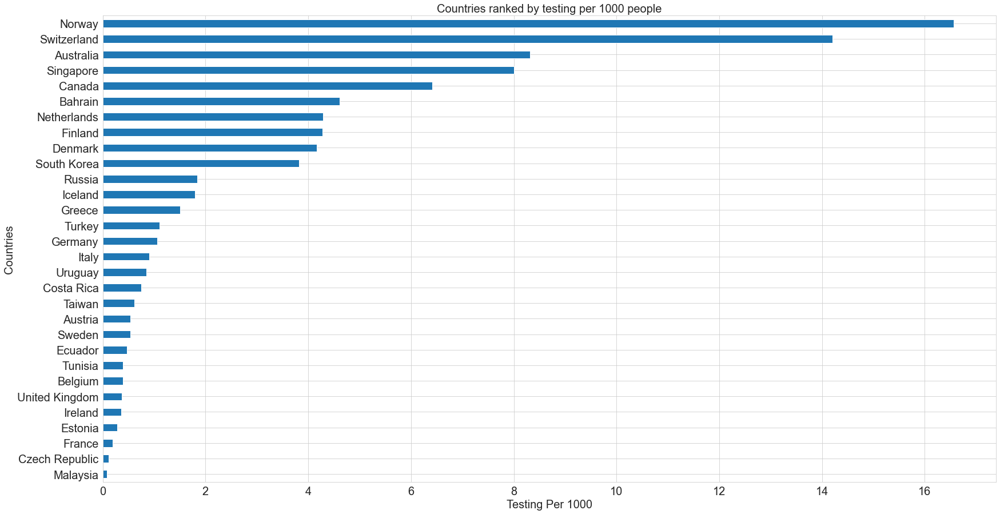

In [66]:
testing_per_1000 = testing_per_1000.reset_index()
testing_per_1000['tests per thousand'] = pd.to_numeric(testing_per_1000['tests per thousand'].str[0])

testing_per_1000 = testing_per_1000.set_index('Entity')
plt.title('Countries ranked by testing per 1000 people', fontsize=20)
testing_per_1000['tests per thousand'].tail(30).plot(kind='barh', fontsize=20, figsize=(28,15))
plt.ylabel('Countries', fontsize =20)
plt.xlabel('Testing Per 1000', fontsize =20)

In [67]:
def tests_per_1000(str): # Function to return tests per 1000 for every country
     val = testing_per_1000.loc[testing_per_1000['Entity'] == str, 'tests per thousand']
        
     return(val.to_numpy()) 

In [68]:
testing_per_1000 = testing_per_1000.reset_index()

In [69]:
tests_per_1000("Australia")

array([8.3179592])

In [70]:
death_per_million = pd.read_csv('deaths per million 2.csv') # Reading deaths per million for every country
death_per_million

,Entity,Code,Date,Total confirmed deaths due to COVID-19 per million people (deaths per million)
0,Afghanistan,AFG,"Mar 24, 2020",0.025688
1,Afghanistan,AFG,"Mar 25, 2020",0.025688
2,Afghanistan,AFG,"Mar 26, 2020",0.025688
3,Afghanistan,AFG,"Mar 27, 2020",0.025688
4,Afghanistan,AFG,"Mar 28, 2020",0.051376
...,...,...,...,...
6634,Zimbabwe,ZWE,"Apr 24, 2020",0.201844
6635,Zimbabwe,ZWE,"Apr 25, 2020",0.269126
6636,Zimbabwe,ZWE,"Apr 26, 2020",0.269126
6637,Zimbabwe,ZWE,"Apr 27, 2020",0.269126


In [71]:
deaths = death_per_million.groupby('Entity').max() # Taking only thr latest data into consideration
deaths

,Code,Date,Total confirmed deaths due to COVID-19 per million people (deaths per million)
Entity,,,
Afghanistan,AFG,"Mar 31, 2020",1.464229
Africa,NaN,"Mar 9, 2020",1.096525
Albania,ALB,"Mar 31, 2020",9.729655
Algeria,DZA,"Mar 31, 2020",9.851533
Andorra,AND,"Mar 31, 2020",517.698829
...,...,...,...
Uzbekistan,UZB,"Mar 31, 2020",0.239026
Venezuela,VEN,"Mar 31, 2020",0.351668
World,OWID_WRL,"Mar 9, 2020",26.965802


In [72]:
deaths = deaths.drop(['Code', 'Date'], axis=1)


In [73]:
def death_per_million(str): # function to return deaths per million
     val = deaths.loc[deaths['Entity'] == str, 'Total confirmed deaths due to COVID-19 per million people (deaths per million)']
        
     return(val.to_numpy())

In [74]:
deaths = deaths.reset_index()

In [75]:
death_per_million("Zambia")

array([0.16318577])

In [76]:
age_70 = pd.read_csv('share-of-the-population-that-is-70-years-and-older.csv') # Reading csv to find the population % of a country aged > 70
age_70

,Entity,Code,Year,Share who is 70 or over (%)
0,Afghanistan,AFG,1950,1.391
1,Afghanistan,AFG,1951,1.434
2,Afghanistan,AFG,1952,1.461
3,Afghanistan,AFG,1953,1.469
4,Afghanistan,AFG,1954,1.456
...,...,...,...,...
15901,Zimbabwe,ZWE,2011,1.933
15902,Zimbabwe,ZWE,2012,1.934
15903,Zimbabwe,ZWE,2013,1.928
15904,Zimbabwe,ZWE,2014,1.911


In [77]:
age2 = age_70.copy()
age2 = age2.groupby('Entity').max()
age2 = age2.drop(['Share who is 70 or over (%)'], axis =1)
age2

,Code,Year
Entity,,
Afghanistan,AFG,2015
Africa,NaN,2015
Albania,ALB,2015
Algeria,DZA,2015
Angola,AGO,2015
...,...,...
Western Sahara,ESH,2015
World,OWID_WRL,2015
Yemen,YEM,2015


In [78]:
#Transforming the table to take only the latest data into account (drawback: takes 3-5 minutes to run)
age2['Percentage > 70'] = ''
age2 = age2.reset_index()
age_70 = age_70.reset_index()

agelist = []
for i,rows in age2.iterrows():
    for j,row in age_70.iterrows():
        if rows['Entity'] == row['Entity'] and rows['Year'] == row['Year']:
            rows['Percentage > 70'] = row['Share who is 70 or over (%)']
            agelist.append([rows['Percentage > 70']])
            
            
age2['Percentage > 70'] = agelist

In [79]:
age2['Percentage > 70'] = pd.to_numeric(age2['Percentage > 70'].str[0]) #Making the column numeric
age2

,Entity,Code,Year,Percentage > 70
0,Afghanistan,AFG,2015,1.337
1,Africa,NaN,2015,2.041
2,Albania,ALB,2015,8.643
3,Algeria,DZA,2015,3.857
4,Angola,AGO,2015,1.362
...,...,...,...,...
236,Western Sahara,ESH,2015,1.380
237,World,OWID_WRL,2015,5.355
238,Yemen,YEM,2015,1.583
239,Zambia,ZMB,2015,1.542


In [80]:
pop_density = pd.read_csv('API_EN.POP.DNST_DS2_en_csv_v2_936296.csv') #Reading the population density for every country

pop_density

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,Aruba,ABW,Population density (people per sq. km of land ...,EN.POP.DNST,NaN,307.988889,312.361111,314.972222,316.844444,318.666667,...,564.827778,566.922222,569.777778,573.105556,576.522222,579.672222,582.622222,585.366667,588.027778,NaN
1,Afghanistan,AFG,Population density (people per sq. km of land ...,EN.POP.DNST,NaN,14.044987,14.323808,14.617537,14.926295,15.250314,...,44.704082,46.131503,47.730564,49.428038,51.114778,52.712071,54.197114,55.595993,56.937760,NaN
2,Angola,AGO,Population density (people per sq. km of land ...,EN.POP.DNST,NaN,4.436891,4.498708,4.555593,4.600180,4.628676,...,18.734456,19.427818,20.139513,20.867715,21.610475,22.366553,23.135064,23.916538,24.713052,NaN
3,Albania,ALB,Population density (people per sq. km of land ...,EN.POP.DNST,NaN,60.576642,62.456898,64.329234,66.209307,68.058066,...,106.314635,106.029015,105.854051,105.660292,105.441752,105.135146,104.967190,104.870693,104.612263,NaN
4,Andorra,AND,Population density (people per sq. km of land ...,EN.POP.DNST,NaN,30.585106,32.702128,34.919149,37.168085,39.465957,...,179.678723,178.185106,175.376596,171.859575,168.538298,165.980851,164.461702,163.831915,163.842553,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
259,Kosovo,XKX,Population density (people per sq. km of land ...,EN.POP.DNST,NaN,88.729678,91.301552,93.873427,96.445302,99.017176,...,163.100946,164.508129,165.812437,167.548452,167.337191,165.500138,166.822816,168.154680,NaN,NaN
260,"Yemen, Rep.",YEM,Population density (people per sq. km of land ...,EN.POP.DNST,NaN,10.214664,10.367390,10.524776,10.685450,10.848630,...,43.856384,45.092691,46.353350,47.629807,48.910895,50.188247,51.457867,52.720459,53.977853,NaN
261,South Africa,ZAF,Population density (people per sq. km of land ...,EN.POP.DNST,NaN,14.446194,14.809886,15.186970,15.577003,15.979722,...,42.220251,42.869179,43.553244,44.258246,44.964505,45.657261,46.330985,46.987817,47.630120,NaN
262,Zambia,ZMB,Population density (people per sq. km of land ...,EN.POP.DNST,NaN,4.256620,4.386190,4.519975,4.658676,4.802949,...,18.302619,18.863844,19.458321,20.078968,20.715577,21.360741,22.012009,22.671395,23.341479,NaN


In [81]:
data = {'Entity':pop_density['Country Name'],
        'Population Density':pop_density['2018']} # Taking only the latest data
       


pop_density2 = pd.DataFrame(data)
pop_density2

,Entity,Population Density
0,Aruba,588.027778
1,Afghanistan,56.937760
2,Angola,24.713052
3,Albania,104.612263
4,Andorra,163.842553
...,...,...
259,Kosovo,NaN
260,"Yemen, Rep.",53.977853
261,South Africa,47.630120
262,Zambia,23.341479


In [82]:
temp = pd.read_csv("cckp_historical_data_0.csv") #Reading the temperature for every country 
temp['Mean Temperature'] = temp.mean(axis = 1, skipna = True)
temp = temp.rename(columns={"ISO_3DIGIT": "Code_x"}, errors="raise")
temp

,Code_x,Jan_Temp,Feb_temp,Mar_temp,Apr_Temp,Mean Temperature
0,AFG,0.07,2.11,7.60,13.37,5.7875
1,AGO,22.58,22.68,22.78,22.35,22.5975
2,ALB,2.02,3.22,6.04,9.92,5.3000
3,ARE,18.43,19.43,22.61,26.58,21.7625
4,ARG,20.80,19.90,17.51,14.05,18.0650
...,...,...,...,...,...,...
173,VUT,25.33,25.44,25.23,24.48,25.1200
174,YEM,18.35,19.25,20.82,23.55,20.4925
175,ZAF,23.19,22.66,21.10,17.74,21.1725
176,ZMB,22.89,22.94,22.90,21.91,22.6600


In [83]:
data = pd.read_csv("data_csv.csv") # Dataframe to have the codes for countries which will be used to merge/join dataframes
data

,Name,Code
0,Afghanistan,AF
1,Åland Islands,AX
2,Albania,AL
3,Algeria,DZ
4,American Samoa,AS
...,...,...
244,Wallis and Futuna,WF
245,Western Sahara,EH
246,Yemen,YE
247,Zambia,ZM


In [84]:
mobility_world = pd.read_csv("mobility_total_world.csv") # Reading the mobility file which has been parsed from Google Mobility Report
mobility_world = mobility_world.rename({"Country": 'Code'}, axis='columns')
mobility_world

,Code,Date,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,Residential
0,AE,2020-03-29,-55.0,-26.0,-53.0,-69.0,-45.0,26.0
1,AF,2020-03-29,-38.0,-21.0,-13.0,-34.0,-33.0,10.0
2,AG,2020-03-29,-46.0,-21.0,-30.0,-67.0,-48.0,NaN
3,AO,2020-03-29,-61.0,-40.0,-39.0,-57.0,-11.0,22.0
4,AR,2020-03-29,-86.0,-61.0,-89.0,-80.0,-57.0,27.0
...,...,...,...,...,...,...,...,...
257,VN,2020-04-11,-59.0,-33.0,-43.0,-58.0,-29.0,21.0
258,YE,2020-04-11,-9.0,-1.0,-8.0,-13.0,-6.0,6.0
259,ZA,2020-04-11,-75.0,-46.0,-58.0,-78.0,-56.0,27.0
260,ZM,2020-04-11,-26.0,-16.0,-4.0,-28.0,-16.0,13.0


In [85]:
mobility_world = mobility_world[-131:]
mobility_world

,Code,Date,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,Residential
131,AE,2020-04-11,-64.0,-32.0,-77.0,-79.0,-45.0,24.0
132,AF,2020-04-11,-46.0,-32.0,-12.0,-50.0,-38.0,16.0
133,AG,2020-04-11,-70.0,-45.0,-56.0,-83.0,-68.0,NaN
134,AO,2020-04-11,-53.0,-32.0,-37.0,-44.0,-31.0,22.0
135,AR,2020-04-11,-84.0,-34.0,-80.0,-67.0,-52.0,27.0
...,...,...,...,...,...,...,...,...
257,VN,2020-04-11,-59.0,-33.0,-43.0,-58.0,-29.0,21.0
258,YE,2020-04-11,-9.0,-1.0,-8.0,-13.0,-6.0,6.0
259,ZA,2020-04-11,-75.0,-46.0,-58.0,-78.0,-56.0,27.0
260,ZM,2020-04-11,-26.0,-16.0,-4.0,-28.0,-16.0,13.0


In [86]:
mobility_world = pd.merge(mobility_world, data, on = "Code") # Merging it with code
mobility_world

,Code,Date,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,Residential,Name
0,AE,2020-04-11,-64.0,-32.0,-77.0,-79.0,-45.0,24.0,United Arab Emirates
1,AF,2020-04-11,-46.0,-32.0,-12.0,-50.0,-38.0,16.0,Afghanistan
2,AG,2020-04-11,-70.0,-45.0,-56.0,-83.0,-68.0,NaN,Antigua and Barbuda
3,AO,2020-04-11,-53.0,-32.0,-37.0,-44.0,-31.0,22.0,Angola
4,AR,2020-04-11,-84.0,-34.0,-80.0,-67.0,-52.0,27.0,Argentina
...,...,...,...,...,...,...,...,...,...
126,VN,2020-04-11,-59.0,-33.0,-43.0,-58.0,-29.0,21.0,Viet Nam
127,YE,2020-04-11,-9.0,-1.0,-8.0,-13.0,-6.0,6.0,Yemen
128,ZA,2020-04-11,-75.0,-46.0,-58.0,-78.0,-56.0,27.0,South Africa
129,ZM,2020-04-11,-26.0,-16.0,-4.0,-28.0,-16.0,13.0,Zambia


In [87]:
mobility_world = mobility_world.drop(['Code','Date'], axis = 1)
mobility_world

,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,Residential,Name
0,-64.0,-32.0,-77.0,-79.0,-45.0,24.0,United Arab Emirates
1,-46.0,-32.0,-12.0,-50.0,-38.0,16.0,Afghanistan
2,-70.0,-45.0,-56.0,-83.0,-68.0,NaN,Antigua and Barbuda
3,-53.0,-32.0,-37.0,-44.0,-31.0,22.0,Angola
4,-84.0,-34.0,-80.0,-67.0,-52.0,27.0,Argentina
...,...,...,...,...,...,...,...
126,-59.0,-33.0,-43.0,-58.0,-29.0,21.0,Viet Nam
127,-9.0,-1.0,-8.0,-13.0,-6.0,6.0,Yemen
128,-75.0,-46.0,-58.0,-78.0,-56.0,27.0,South Africa
129,-26.0,-16.0,-4.0,-28.0,-16.0,13.0,Zambia


In [88]:
mobility_world =mobility_world.drop(['Residential'], axis = 1)
mobility_world = mobility_world.set_index('Name')
mobility_world['Mean Drop in Mobility'] = mobility_world.mean(axis=1) # Calculating the mean drop in mobility
mobility_world

,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,Mean Drop in Mobility
Name,,,,,,
United Arab Emirates,-64.0,-32.0,-77.0,-79.0,-45.0,-59.4
Afghanistan,-46.0,-32.0,-12.0,-50.0,-38.0,-35.6
Antigua and Barbuda,-70.0,-45.0,-56.0,-83.0,-68.0,-64.4
Angola,-53.0,-32.0,-37.0,-44.0,-31.0,-39.4
Argentina,-84.0,-34.0,-80.0,-67.0,-52.0,-63.4
...,...,...,...,...,...,...
Viet Nam,-59.0,-33.0,-43.0,-58.0,-29.0,-44.4
Yemen,-9.0,-1.0,-8.0,-13.0,-6.0,-7.4
South Africa,-75.0,-46.0,-58.0,-78.0,-56.0,-62.6


In [89]:
mobility_world =mobility_world.sort_values(by='Mean Drop in Mobility')
mobility_world

,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,Mean Drop in Mobility
Name,,,,,,
Bahamas,-97.0,-97.0,-84.0,-95.0,-79.0,-90.4
Panama,-96.0,-95.0,-86.0,-91.0,-84.0,-90.4
"Macedonia, the Former Yugoslav Republic of",-95.0,-95.0,-79.0,-93.0,-82.0,-88.8
Jordan,-93.0,-89.0,-78.0,-95.0,-81.0,-87.2
Turkey,-92.0,-83.0,-81.0,-90.0,-78.0,-84.8
...,...,...,...,...,...,...
Yemen,-9.0,-1.0,-8.0,-13.0,-6.0,-7.4
Sweden,-41.0,-15.0,84.0,-36.0,-24.0,-6.4
Tajikistan,-9.0,-8.0,-14.0,-15.0,15.0,-6.2


In [90]:
mobility_world = mobility_world.fillna(0)
mobility_world

,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,Mean Drop in Mobility
Name,,,,,,
Bahamas,-97.0,-97.0,-84.0,-95.0,-79.0,-90.4
Panama,-96.0,-95.0,-86.0,-91.0,-84.0,-90.4
"Macedonia, the Former Yugoslav Republic of",-95.0,-95.0,-79.0,-93.0,-82.0,-88.8
Jordan,-93.0,-89.0,-78.0,-95.0,-81.0,-87.2
Turkey,-92.0,-83.0,-81.0,-90.0,-78.0,-84.8
...,...,...,...,...,...,...
Yemen,-9.0,-1.0,-8.0,-13.0,-6.0,-7.4
Sweden,-41.0,-15.0,84.0,-36.0,-24.0,-6.4
Tajikistan,-9.0,-8.0,-14.0,-15.0,15.0,-6.2


In [91]:
mobility_world2 = mobility_world.drop(['Retail & recreation', 'Grocery & pharmacy', 'Parks', 'Transit stations', 'Workplaces'], axis=1)

In [92]:
mobility_world2 = mobility_world2.reset_index()
mobility_world2 = mobility_world2.rename(columns={"Name": "Entity"})
mobility_world2

,Entity,Mean Drop in Mobility
0,Bahamas,-90.4
1,Panama,-90.4
2,"Macedonia, the Former Yugoslav Republic of",-88.8
3,Jordan,-87.2
4,Turkey,-84.8
...,...,...
126,Yemen,-7.4
127,Sweden,-6.4
128,Tajikistan,-6.2
129,"Korea, Republic of",-1.8


In [93]:
world_testing = pd.read_csv("full-list-cumulative-total-tests-per-thousand (3).csv") #Reading testing per thousand people 
world_testing['Date'] = pd.to_datetime(world_testing['Date'])
world_testing = world_testing.set_index('Entity')
world_testing = world_testing.groupby('Entity').max()
world_testing

,Code,Date,Total tests per thousand
Entity,,,
Argentina,ARG,2020-04-26,1.097
Australia,AUS,2020-04-27,20.344
Austria,AUT,2020-04-27,26.478
Bahrain,BHR,2020-04-27,69.134
Bangladesh,BGD,2020-04-26,0.274
...,...,...,...
"United Kingdom, tests performed",NaN,2020-04-26,9.948
United States,USA,2020-04-26,16.417
"United States, specimens tested (CDC)",NaN,2020-04-18,1.250


In [94]:
world_testing = world_testing.reset_index()

In [95]:
world_testing = pd.merge(world_testing, testing_per_1000, on='Entity')

In [96]:
world_testing = world_testing.drop(['Date_x','index','Code_y'], axis=1)
world_testing = world_testing.rename(columns={"Code_x": "Code", "Date_y": "Date",'tests per thousand': "Tests per 1000 initially","Total tests per thousand": "Total tests per thousand (Current)"})

In [97]:
cases

,Entity,Code,Date,Total confirmed cases of COVID-19 per million people (cases per million)
0,Afghanistan,AFG,"Mar 8, 2020",43.747048
1,Africa,NaN,"Mar 9, 2020",24.738212
2,Albania,ALB,"Mar 9, 2020",255.750921
3,Algeria,DZA,"Mar 9, 2020",80.203337
4,Andorra,AND,"Mar 31, 2020",9616.255743
...,...,...,...,...
206,Western Sahara,ESH,"Apr 28, 2020",10.044699
207,World,OWID_WRL,"Mar 9, 2020",382.651060
208,Yemen,YEM,"Apr 28, 2020",0.033528
209,Zambia,ZMB,"Mar 31, 2020",4.841178


In [98]:
complete = pd.merge(deaths, cases, on='Entity') #Merging dataframes

In [99]:
#Merging all different datasets together 

complete = pd.merge(complete, mobility_world2, on='Entity')
complete = pd.merge(complete, world_testing, on='Entity')
complete = complete.drop(['Code_y', 'Date_y','Date_x'], axis=1)
complete = pd.merge(complete, pop_density2, on ='Entity')
complete = pd.merge(complete, age2, on='Entity')
complete = pd.merge(complete, beds, on='Entity')
complete = complete.drop(['Code', 'Year_y','Year_x'], axis=1)
complete = pd.merge(complete,temp, on='Code_x')
complete = complete.set_index('Entity')

In [100]:
complete

,Total confirmed deaths due to COVID-19 per million people (deaths per million),Code_x,Total confirmed cases of COVID-19 per million people (cases per million),Mean Drop in Mobility,Total tests per thousand (Current),Tests per 1000 initially,Population Density,Percentage > 70,hospital_beds,Jan_Temp,Feb_temp,Mar_temp,Apr_Temp,Mean Temperature
Entity,,,,,,,,,,,,,,
Australia,3.294133,AUS,263.726721,-39.4,20.344,8.317959,3.249129,10.129,3.9,27.78,27.23,25.37,21.87,25.5625
Austria,60.956653,AUT,1693.906555,-47.0,26.478,0.539044,107.206927,13.748,7.6,-3.52,-1.99,1.42,5.51,0.3550
Belgium,621.849766,BEL,4028.347445,-46.2,18.379,0.389760,377.214927,12.849,6.5,1.95,2.62,5.23,8.15,4.4875
Canada,71.723511,CAN,1284.743742,-40.2,18.815,6.412698,4.075308,10.797,2.7,-24.62,-23.25,-18.72,-9.79,-19.0950
Costa Rica,1.177830,CRI,136.824578,-76.0,1.759,0.747991,97.913063,5.694,1.2,23.17,23.67,24.62,25.04,24.1250
Czech Republic,20.823641,CZE,695.584324,-23.6,20.546,0.112193,137.602888,11.580,6.8,-2.81,-1.06,2.80,7.49,1.6050
Denmark,73.719792,DNK,1501.673888,-10.4,26.879,4.170404,138.067302,12.325,3.5,-0.11,-0.10,2.24,5.87,1.9750
Ecuador,37.578515,ECU,1317.231818,-84.6,2.645,0.475956,68.788682,4.458,1.6,21.71,21.78,21.93,21.96,21.8450
Estonia,37.692069,EST,1241.576765,-28.8,37.217,0.282955,30.386105,13.491,5.3,-6.51,-6.33,-2.35,3.93,-2.8150


In [101]:
complete2 = complete.copy()
complete2.drop([ 'Czech Republic','Malaysia', 'Japan'], inplace=True)
complete2

,Total confirmed deaths due to COVID-19 per million people (deaths per million),Code_x,Total confirmed cases of COVID-19 per million people (cases per million),Mean Drop in Mobility,Total tests per thousand (Current),Tests per 1000 initially,Population Density,Percentage > 70,hospital_beds,Jan_Temp,Feb_temp,Mar_temp,Apr_Temp,Mean Temperature
Entity,,,,,,,,,,,,,,
Australia,3.294133,AUS,263.726721,-39.4,20.344,8.317959,3.249129,10.129,3.9,27.78,27.23,25.37,21.87,25.5625
Austria,60.956653,AUT,1693.906555,-47.0,26.478,0.539044,107.206927,13.748,7.6,-3.52,-1.99,1.42,5.51,0.3550
Belgium,621.849766,BEL,4028.347445,-46.2,18.379,0.389760,377.214927,12.849,6.5,1.95,2.62,5.23,8.15,4.4875
Canada,71.723511,CAN,1284.743742,-40.2,18.815,6.412698,4.075308,10.797,2.7,-24.62,-23.25,-18.72,-9.79,-19.0950
Costa Rica,1.177830,CRI,136.824578,-76.0,1.759,0.747991,97.913063,5.694,1.2,23.17,23.67,24.62,25.04,24.1250
Denmark,73.719792,DNK,1501.673888,-10.4,26.879,4.170404,138.067302,12.325,3.5,-0.11,-0.10,2.24,5.87,1.9750
Ecuador,37.578515,ECU,1317.231818,-84.6,2.645,0.475956,68.788682,4.458,1.6,21.71,21.78,21.93,21.96,21.8450
Estonia,37.692069,EST,1241.576765,-28.8,37.217,0.282955,30.386105,13.491,5.3,-6.51,-6.33,-2.35,3.93,-2.8150
Finland,34.833031,FIN,847.363103,-12.6,14.773,4.272304,18.156856,13.264,5.5,-11.91,-11.03,-6.09,0.04,-7.2475


In [102]:
def recovery_rate(df1, df2, df3):  # Function to return the recovery rate of countries ( Closed cases as considered as Total)
    df1.drop(df1.iloc[:, 0:4], inplace = True, axis = 1)
    df2.drop(df2.iloc[:, 0:4], inplace = True, axis = 1)
    
    dates = df2.keys()
    total_deaths = [] 
    df_cases = []
    mortality_rate = []
    recovery_rate = [] 
    total_recovered = [] 
    total_active = [] 
    length = len(dates)
    confirmed_sum = df2.iloc[0,len(df2.columns) - 1]
    recovered_sum = df1.iloc[0,len(df1.columns) - 1]
    death_sum = int(df3.iloc[0,len(df3.columns) - 2])
    
    recovery_rate = (recovered_sum /(confirmed_sum - (confirmed_sum - recovered_sum - death_sum)))
    return(recovery_rate)

In [103]:
def gr_rate(df): # Function which returns mean growth rate ( of only last 7 days)
    
    df2 = df.copy()
    column_list = []
    length = len(df.columns) 
    length2 = length - 25
    for i in range(length):
        if(i>0):
            df2.iloc[0,i] = df2.iloc[0,i] - df.iloc[0,i-1]
    df3 = df2.copy()
    df3.drop(df3.iloc[:, 0:25], inplace = True, axis = 1)
    df2.drop(df2.iloc[:, 0:25], inplace = True, axis = 1)
    df.drop(df.iloc[:, 0:25], inplace = True, axis = 1)
    for i in range(length2):
        if(i>0):
            df3.iloc[0,i] = df3.iloc[0,i] - df2.iloc[0,i-1]
            
    df3.drop(df3.iloc[:, 0:len(df3)-8], inplace = True, axis = 1) 
    

    Mean_df_growth_rate = df3.sum(axis=1)/len(df3.columns)
    
    return(Mean_df_growth_rate)

In [104]:
#Calculating recovery and growth rate of countries 

Australia = recoveries_df.loc[recoveries_df['Country/Region'] == 'Australia']
Australia.loc['Total']= Australia.sum()
Australia = Australia.iloc[len(Australia)-1:]
Australia2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Australia']
Australia2.loc['Total']= Australia2.sum()
Australia2 = Australia2.iloc[len(Australia2)-1:]
Australia3 = deaths_df.loc[deaths_df['Country/Region'] == 'Australia']
Australia3.loc['Total']= Australia3.sum()
Australia3 = Australia3.iloc[len(Australia3)-1:]
Australia_recovery = recovery_rate(Australia, Australia2, Australia3)
Australia_gr = gr_rate(Australia2)

Bahrain = recoveries_df.loc[recoveries_df['Country/Region'] == 'Bahrain']
Bahrain2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Bahrain']
Bahrain3 = deaths_df.loc[deaths_df['Country/Region'] == 'Bahrain']
Bahrain_recovery = recovery_rate(Bahrain, Bahrain2, Bahrain3)
Bahrain_gr = gr_rate(Bahrain2)

Belgium = recoveries_df.loc[recoveries_df['Country/Region'] == 'Belgium']
Belgium2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Belgium']
Belgium3 = deaths_df.loc[deaths_df['Country/Region'] == 'Belgium']
Belgium_recovery = recovery_rate(Belgium, Belgium2, Belgium3)
Belgium_gr = gr_rate(Belgium2)

France = recoveries_df.loc[recoveries_df['Country/Region'] == 'France']
France.loc['Total']= France.sum()
France = France.iloc[len(France)-1:]
France2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'France']
France2.loc['Total']= France2.sum()
France2 = France2.iloc[len(France2)-1:]
France3 = deaths_df.loc[deaths_df['Country/Region'] == 'France']
France3.loc['Total']= France3.sum()
France3 = France3.iloc[len(France3)-1:]
France_recovery = recovery_rate(France, France2, France3)
France_gr = gr_rate(France2)

Italy = recoveries_df.loc[recoveries_df['Country/Region'] == 'Italy']
Italy2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Italy']
Italy3 = deaths_df.loc[deaths_df['Country/Region'] == 'Italy']
Italy_recovery = recovery_rate(Italy, Italy2, Italy3)
Italy_gr = gr_rate(Italy2)

Netherlands = recoveries_df.loc[recoveries_df['Country/Region'] == 'Netherlands']
Netherlands.loc['Total']= Netherlands.sum()
Netherlands = Netherlands.iloc[len(Netherlands)-1:]
Netherlands2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Netherlands']
Netherlands2.loc['Total']= Netherlands2.sum()
Netherlands2 = Netherlands2.iloc[len(Netherlands2)-1:]
Netherlands3 = deaths_df.loc[deaths_df['Country/Region'] == 'Netherlands']
Netherlands3.loc['Total']= Netherlands3.sum()
Netherlands3 = Netherlands3.iloc[len(Netherlands3)-1:]
Netherlands_recovery = recovery_rate(Netherlands, Netherlands2, Netherlands3)
Netherlands_gr = gr_rate(Netherlands2)

Norway = recoveries_df.loc[recoveries_df['Country/Region'] == 'Norway']
Norway2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Norway']
Norway3 = deaths_df.loc[deaths_df['Country/Region'] == 'Norway']
Norway_recovery = recovery_rate(Norway, Norway2, Norway3)
Norway_gr = gr_rate(Norway2)

Singapore = recoveries_df.loc[recoveries_df['Country/Region'] == 'Singapore']
Singapore2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Singapore']
Singapore3 = deaths_df.loc[deaths_df['Country/Region'] == 'Singapore']
Singapore_recovery = recovery_rate(Singapore, Singapore2, Singapore3)
Singapore_gr = gr_rate(Singapore2)

Sweden = recoveries_df.loc[recoveries_df['Country/Region'] == 'Sweden']
Sweden2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Sweden']
Sweden3 = deaths_df.loc[deaths_df['Country/Region'] == 'Sweden']
Sweden_recovery = recovery_rate(Sweden, Sweden2, Sweden3)
Sweden_gr = gr_rate(Sweden2)

UK = recoveries_df.loc[recoveries_df['Country/Region'] == 'United Kingdom']
UK.loc['Total']= UK.sum()
UK = UK.iloc[len(UK)-1:]
UK2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'United Kingdom']
UK2.loc['Total']= UK2.sum()
UK2 = UK2.iloc[len(UK2)-1:]
UK3 = deaths_df.loc[deaths_df['Country/Region'] == 'United Kingdom']
UK3.loc['Total']= UK3.sum()
UK3 = UK3.iloc[len(UK3)-1:]
UK_recovery = recovery_rate(UK, UK2, UK3)
UK_gr = gr_rate(UK2)

Austria = recoveries_df.loc[recoveries_df['Country/Region'] == 'Austria']
Austria2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Austria']
Austria3 = deaths_df.loc[deaths_df['Country/Region'] == 'Austria']
Austria_recovery = recovery_rate(Austria, Austria2, Austria3)
Austria_gr = gr_rate(Austria2)

Denmark = recoveries_df.loc[recoveries_df['Country/Region'] == 'Denmark']
Denmark.loc['Total']= Denmark.sum()
Denmark = Denmark.iloc[len(Denmark)-1:]
Denmark2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Denmark']
Denmark2.loc['Total']= Denmark2.sum()
Denmark2 = Denmark2.iloc[len(Denmark2)-1:]
Denmark3 = deaths_df.loc[deaths_df['Country/Region'] == 'Denmark']
Denmark3.loc['Total']= Denmark3.sum()
Denmark3 = Denmark3.iloc[len(Denmark3)-1:]
Denmark_recovery = recovery_rate(Denmark, Denmark2, Denmark3)
Denmark_gr = gr_rate(Denmark2)

Russia = recoveries_df.loc[recoveries_df['Country/Region'] == 'Russia']
Russia2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Russia']
Russia3 = deaths_df.loc[deaths_df['Country/Region'] == 'Russia']
Russia_recovery = recovery_rate(Russia, Russia2, Russia3)
Russia_gr = gr_rate(Russia2)

Ireland = recoveries_df.loc[recoveries_df['Country/Region'] == 'Ireland']
Ireland2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Ireland']
Ireland3 = deaths_df.loc[deaths_df['Country/Region'] == 'Ireland']
Ireland_recovery = recovery_rate(Ireland, Ireland2, Ireland3)
Ireland_gr = gr_rate(Ireland2)

US = recoveries_df.loc[recoveries_df['Country/Region'] == 'US']
US2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'US']
US3 = deaths_df.loc[deaths_df['Country/Region'] == 'US']
US_recovery = recovery_rate(US, US2, US3)
US_gr = gr_rate(US2)

Canada = recoveries_df.loc[recoveries_df['Country/Region'] == 'Canada']
Canada2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Canada']
Canada3 = deaths_df.loc[deaths_df['Country/Region'] == 'Canada']
Canada_recovery = recovery_rate(Canada, Canada2, Canada3)
Canada_gr = gr_rate(Canada2)

New_Zealand = recoveries_df.loc[recoveries_df['Country/Region'] == 'New Zealand']
New_Zealand2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'New Zealand']
New_Zealand3 = deaths_df.loc[deaths_df['Country/Region'] == 'New Zealand']
New_Zealand_recovery = recovery_rate(New_Zealand, New_Zealand2, New_Zealand3)
New_Zealand_gr = gr_rate(New_Zealand2)

Costa_Rica = recoveries_df.loc[recoveries_df['Country/Region'] == 'Costa Rica']
Costa_Rica2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Costa Rica']
Costa_Rica3 = deaths_df.loc[deaths_df['Country/Region'] == 'Costa Rica']
Costa_Rica_recovery = recovery_rate(Costa_Rica, Costa_Rica2, Costa_Rica3)
Costa_Rica_gr = gr_rate(Costa_Rica2)

Ecuador = recoveries_df.loc[recoveries_df['Country/Region'] == 'Ecuador']
Ecuador2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Ecuador']
Ecuador3 = deaths_df.loc[deaths_df['Country/Region'] == 'Ecuador']
Ecuador_recovery = recovery_rate(Ecuador, Ecuador2, Ecuador3)
Ecuador_gr = gr_rate(Ecuador2)

Estonia = recoveries_df.loc[recoveries_df['Country/Region'] == 'Estonia']
Estonia2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Estonia']
Estonia3 = deaths_df.loc[deaths_df['Country/Region'] == 'Estonia']
Estonia_recovery = recovery_rate(Estonia, Estonia2, Estonia3)
Estonia_gr = gr_rate(Estonia2)

Finland = recoveries_df.loc[recoveries_df['Country/Region'] == 'Finland']
Finland2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Finland']
Finland3 = deaths_df.loc[deaths_df['Country/Region'] == 'Finland']
Finland_recovery = recovery_rate(Finland, Finland2, Finland3)
Finland_gr = gr_rate(Finland2)

Greece = recoveries_df.loc[recoveries_df['Country/Region'] == 'Greece']
Greece2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Greece']
Greece3 = deaths_df.loc[deaths_df['Country/Region'] == 'Greece']
Greece_recovery = recovery_rate(Greece, Greece2, Greece3)
Greece_gr = gr_rate(Greece2)

Iceland = recoveries_df.loc[recoveries_df['Country/Region'] == 'Iceland']
Iceland2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Iceland']
Iceland3 = deaths_df.loc[deaths_df['Country/Region'] == 'Iceland']
Iceland_recovery = recovery_rate(Iceland, Iceland2, Iceland3)
Iceland_gr = gr_rate(Iceland2)

India = recoveries_df.loc[recoveries_df['Country/Region'] == 'India']
India2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'India']
India3 = deaths_df.loc[deaths_df['Country/Region'] == 'India']
India_recovery = recovery_rate(India, India2, India3)
India_gr = gr_rate(India2)

Indonesia = recoveries_df.loc[recoveries_df['Country/Region'] == 'Indonesia']
Indonesia2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Indonesia']
Indonesia3 = deaths_df.loc[deaths_df['Country/Region'] == 'Indonesia']
Indonesia_recovery = recovery_rate(Indonesia, Indonesia2, Indonesia3)
Indonesia_gr = gr_rate(Indonesia2)

Japan = recoveries_df.loc[recoveries_df['Country/Region'] == 'Japan']
Japan2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Japan']
Japan3 = deaths_df.loc[deaths_df['Country/Region'] == 'Japan']
Japan_recovery = recovery_rate(Japan, Japan2, Japan3)
Japan_gr = gr_rate(Japan2)

Lithuania = recoveries_df.loc[recoveries_df['Country/Region'] == 'Lithuania']
Lithuania2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Lithuania']
Lithuania3 = deaths_df.loc[deaths_df['Country/Region'] == 'Lithuania']
Lithuania_recovery = recovery_rate(Lithuania, Lithuania2, Lithuania3)
Lithuania_gr = gr_rate(Lithuania2)


Pakistan = recoveries_df.loc[recoveries_df['Country/Region'] == 'Pakistan']
Pakistan2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Pakistan']
Pakistan3 = deaths_df.loc[deaths_df['Country/Region'] == 'Pakistan']
Pakistan_recovery = recovery_rate(Pakistan, Pakistan2, Pakistan3)
Pakistan_gr = gr_rate(Pakistan2)

Philippines = recoveries_df.loc[recoveries_df['Country/Region'] == 'Philippines']
Philippines2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Philippines']
Philippines3 = deaths_df.loc[deaths_df['Country/Region'] == 'Philippines']
Philippines_recovery = recovery_rate(Philippines, Philippines2, Philippines3)
Philippines_gr = gr_rate(Philippines2)

Senegal = recoveries_df.loc[recoveries_df['Country/Region'] == 'Senegal']
Senegal2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Senegal']
Senegal3 = deaths_df.loc[deaths_df['Country/Region'] == 'Senegal']
Senegal_recovery = recovery_rate(Senegal, Senegal2, Senegal3)
Senegal_gr = gr_rate(Senegal2)

South_Africa = recoveries_df.loc[recoveries_df['Country/Region'] == 'South Africa']
South_Africa2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'South Africa']
South_Africa3 = deaths_df.loc[deaths_df['Country/Region'] == 'South Africa']
South_Africa_recovery = recovery_rate(South_Africa, South_Africa2, South_Africa3)
South_Africa_gr = gr_rate(South_Africa2)

Switzerland = recoveries_df.loc[recoveries_df['Country/Region'] == 'Switzerland']
Switzerland2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Switzerland']
Switzerland3 = deaths_df.loc[deaths_df['Country/Region'] == 'Switzerland']
Switzerland_recovery = recovery_rate(Switzerland, Switzerland2, Switzerland3)
Switzerland_gr = gr_rate(Switzerland2)

Thailand = recoveries_df.loc[recoveries_df['Country/Region'] == 'Thailand']
Thailand2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Thailand']
Thailand3 = deaths_df.loc[deaths_df['Country/Region'] == 'Thailand']
Thailand_recovery = recovery_rate(Thailand, Thailand2, Thailand3)
Thailand_gr = gr_rate(Thailand2)

Tunisia = recoveries_df.loc[recoveries_df['Country/Region'] == 'Tunisia']
Tunisia2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Tunisia']
Tunisia3 = deaths_df.loc[deaths_df['Country/Region'] == 'Tunisia']
Tunisia_recovery = recovery_rate(Tunisia, Tunisia2, Tunisia3)
Tunisia_gr = gr_rate(Tunisia2)

Turkey = recoveries_df.loc[recoveries_df['Country/Region'] == 'Turkey']
Turkey2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Turkey']
Turkey3 = deaths_df.loc[deaths_df['Country/Region'] == 'Turkey']
Turkey_recovery = recovery_rate(Turkey, Turkey2, Turkey3)
Turkey_gr = gr_rate(Turkey2)

Uruguay = recoveries_df.loc[recoveries_df['Country/Region'] == 'Uruguay']
Uruguay2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Uruguay']
Uruguay3 = deaths_df.loc[deaths_df['Country/Region'] == 'Uruguay']
Uruguay_recovery = recovery_rate(Uruguay, Uruguay2, Uruguay3)
Uruguay_gr = gr_rate(Uruguay2)

Vietnam = recoveries_df.loc[recoveries_df['Country/Region'] == 'Vietnam']
Vietnam2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Vietnam']
Vietnam3 = deaths_df.loc[deaths_df['Country/Region'] == 'Vietnam']
Vietnam_recovery = recovery_rate(Vietnam, Vietnam2, Vietnam3)
Vietnam_gr = gr_rate(Vietnam2)

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [105]:
Germany = recoveries_df.loc[recoveries_df['Country/Region'] == 'Germany']
Germany2 = confirmed_df.loc[confirmed_df['Country/Region'] == 'Germany']
Germany3 = deaths_df.loc[deaths_df['Country/Region'] == 'Germany']
Germany_recovery = recovery_rate(Germany, Germany2, Germany3)
Germany_gr = gr_rate(Germany2)
Germany_recovery

0.9502022412306876

In [106]:
complete2['recovery rate'] = [Australia_recovery,Austria_recovery, Belgium_recovery, Canada_recovery, Costa_Rica_recovery, Denmark_recovery, Ecuador_recovery, Estonia_recovery,Finland_recovery, France_recovery, Germany_recovery, Greece_recovery, India_recovery, Indonesia_recovery, Ireland_recovery,Italy_recovery,Lithuania_recovery,Netherlands_recovery,New_Zealand_recovery,Norway_recovery, Pakistan_recovery, Philippines_recovery, Senegal_recovery, South_Africa_recovery,Sweden_recovery,Switzerland_recovery,Thailand_recovery,Turkey_recovery,UK_recovery,  US_recovery, Uruguay_recovery]
complete2['growth rate'] = [Australia_gr.to_numpy(),Austria_gr.to_numpy(), Belgium_gr.to_numpy(), Canada_gr.to_numpy(), Costa_Rica_gr.to_numpy(), Denmark_gr.to_numpy(), Ecuador_gr.to_numpy(), Estonia_gr.to_numpy(),Finland_gr.to_numpy(), France_gr.to_numpy(), Germany_gr.to_numpy(), Greece_gr.to_numpy(), India_gr.to_numpy(), Indonesia_gr.to_numpy(), Ireland_gr.to_numpy(),Italy_gr.to_numpy(),Lithuania_gr.to_numpy(),Netherlands_gr.to_numpy(),New_Zealand_gr.to_numpy(),Norway_gr.to_numpy(), Pakistan_gr.to_numpy(), Philippines_gr.to_numpy(), Senegal_gr.to_numpy(), South_Africa_gr.to_numpy(),Sweden_gr.to_numpy(),Switzerland_gr.to_numpy(),Thailand_gr.to_numpy(),Turkey_gr.to_numpy(),UK_gr.to_numpy(),  US_gr.to_numpy(), Uruguay_gr.to_numpy()]
complete2

,Total confirmed deaths due to COVID-19 per million people (deaths per million),Code_x,Total confirmed cases of COVID-19 per million people (cases per million),Mean Drop in Mobility,Total tests per thousand (Current),Tests per 1000 initially,Population Density,Percentage > 70,hospital_beds,Jan_Temp,Feb_temp,Mar_temp,Apr_Temp,Mean Temperature,recovery rate,growth rate
Entity,,,,,,,,,,,,,,,,
Australia,3.294133,AUS,263.726721,-39.4,20.344,8.317959,3.249129,10.129,3.9,27.78,27.23,25.37,21.87,25.5625,0.984450,[0.0]
Austria,60.956653,AUT,1693.906555,-47.0,26.478,0.539044,107.206927,13.748,7.6,-3.52,-1.99,1.42,5.51,0.3550,0.957777,[4.571428571428571]
Belgium,621.849766,BEL,4028.347445,-46.2,18.379,0.389760,377.214927,12.849,6.5,1.95,2.62,5.23,8.15,4.4875,0.611481,[14.285714285714286]
Canada,71.723511,CAN,1284.743742,-40.2,18.815,6.412698,4.075308,10.797,2.7,-24.62,-23.25,-18.72,-9.79,-19.0950,0.996335,"[0.7662337662337663, 991.1298701298701, 8.9740..."
Costa Rica,1.177830,CRI,136.824578,-76.0,1.759,0.747991,97.913063,5.694,1.2,23.17,23.67,24.62,25.04,24.1250,0.987654,[-0.14285714285714285]
Denmark,73.719792,DNK,1501.673888,-10.4,26.879,4.170404,138.067302,12.325,3.5,-0.11,-0.10,2.24,5.87,1.9750,0.940769,[0.7142857142857143]
Ecuador,37.578515,ECU,1317.231818,-84.6,2.645,0.475956,68.788682,4.458,1.6,21.71,21.78,21.93,21.96,21.8450,0.668289,[-125.0]
Estonia,37.692069,EST,1241.576765,-28.8,37.217,0.282955,30.386105,13.491,5.3,-6.51,-6.33,-2.35,3.93,-2.8150,0.930262,[0.42857142857142855]
Finland,34.833031,FIN,847.363103,-12.6,14.773,4.272304,18.156856,13.264,5.5,-11.91,-11.03,-6.09,0.04,-7.2475,0.938967,[2.4285714285714284]


In [107]:
complete2['growth rate'] = pd.to_numeric(complete2['growth rate'].str[0])
complete2

,Total confirmed deaths due to COVID-19 per million people (deaths per million),Code_x,Total confirmed cases of COVID-19 per million people (cases per million),Mean Drop in Mobility,Total tests per thousand (Current),Tests per 1000 initially,Population Density,Percentage > 70,hospital_beds,Jan_Temp,Feb_temp,Mar_temp,Apr_Temp,Mean Temperature,recovery rate,growth rate
Entity,,,,,,,,,,,,,,,,
Australia,3.294133,AUS,263.726721,-39.4,20.344,8.317959,3.249129,10.129,3.9,27.78,27.23,25.37,21.87,25.5625,0.984450,0.000000
Austria,60.956653,AUT,1693.906555,-47.0,26.478,0.539044,107.206927,13.748,7.6,-3.52,-1.99,1.42,5.51,0.3550,0.957777,4.571429
Belgium,621.849766,BEL,4028.347445,-46.2,18.379,0.389760,377.214927,12.849,6.5,1.95,2.62,5.23,8.15,4.4875,0.611481,14.285714
Canada,71.723511,CAN,1284.743742,-40.2,18.815,6.412698,4.075308,10.797,2.7,-24.62,-23.25,-18.72,-9.79,-19.0950,0.996335,0.766234
Costa Rica,1.177830,CRI,136.824578,-76.0,1.759,0.747991,97.913063,5.694,1.2,23.17,23.67,24.62,25.04,24.1250,0.987654,-0.142857
Denmark,73.719792,DNK,1501.673888,-10.4,26.879,4.170404,138.067302,12.325,3.5,-0.11,-0.10,2.24,5.87,1.9750,0.940769,0.714286
Ecuador,37.578515,ECU,1317.231818,-84.6,2.645,0.475956,68.788682,4.458,1.6,21.71,21.78,21.93,21.96,21.8450,0.668289,-125.000000
Estonia,37.692069,EST,1241.576765,-28.8,37.217,0.282955,30.386105,13.491,5.3,-6.51,-6.33,-2.35,3.93,-2.8150,0.930262,0.428571
Finland,34.833031,FIN,847.363103,-12.6,14.773,4.272304,18.156856,13.264,5.5,-11.91,-11.03,-6.09,0.04,-7.2475,0.938967,2.428571


In [108]:
complete2 = complete2.drop(['Code_x'], axis=1)
complete2 = complete2.reset_index()

In [109]:
import seaborn as sns

cm = sns.light_palette("red", as_cmap=True)

s = complete2.style.background_gradient(cmap=cm)
s

,Entity,Total confirmed deaths due to COVID-19 per million people (deaths per million),Total confirmed cases of COVID-19 per million people (cases per million),Mean Drop in Mobility,Total tests per thousand (Current),Tests per 1000 initially,Population Density,Percentage > 70,hospital_beds,Jan_Temp,Feb_temp,Mar_temp,Apr_Temp,Mean Temperature,recovery rate,growth rate
0,Australia,3.29413,263.727,-39.4,20.344,8.31796,3.24913,10.129,3.9,27.78,27.23,25.37,21.87,25.5625,0.98445,0
1,Austria,60.9567,1693.91,-47,26.478,0.539044,107.207,13.748,7.6,-3.52,-1.99,1.42,5.51,0.355,0.957777,4.57143
2,Belgium,621.85,4028.35,-46.2,18.379,0.38976,377.215,12.849,6.5,1.95,2.62,5.23,8.15,4.4875,0.611481,14.2857
3,Canada,71.7235,1284.74,-40.2,18.815,6.4127,4.07531,10.797,2.7,-24.62,-23.25,-18.72,-9.79,-19.095,0.996335,0.766234
4,Costa Rica,1.17783,136.825,-76,1.759,0.747991,97.9131,5.694,1.2,23.17,23.67,24.62,25.04,24.125,0.987654,-0.142857
5,Denmark,73.7198,1501.67,-10.4,26.879,4.1704,138.067,12.325,3.5,-0.11,-0.1,2.24,5.87,1.975,0.940769,0.714286
6,Ecuador,37.5785,1317.23,-84.6,2.645,0.475956,68.7887,4.458,1.6,21.71,21.78,21.93,21.96,21.845,0.668289,-125
7,Estonia,37.6921,1241.58,-28.8,37.217,0.282955,30.3861,13.491,5.3,-6.51,-6.33,-2.35,3.93,-2.815,0.930262,0.428571
8,Finland,34.833,847.363,-12.6,14.773,4.2723,18.1569,13.264,5.5,-11.91,-11.03,-6.09,0.04,-7.2475,0.938967,2.42857
9,France,356.852,1966.17,-66.6,9.056,0.192739,122.338,13.079,6.4,3.11,4.22,6.37,9.1,5.7,0.681565,-90.4286


In [110]:
complete2 = complete2.drop(['Jan_Temp', 'Feb_temp', 'Mar_temp', 'Apr_Temp'], axis=1) 

In [111]:
complete2 = complete2.rename({'Total confirmed deaths due to COVID-19 per million people (deaths per million)': 'Deaths Per Million', 'Total confirmed cases of COVID-19 per million people (cases per million)': 'Cases Per Million'}, axis='columns')
complete2

,Entity,Deaths Per Million,Cases Per Million,Mean Drop in Mobility,Total tests per thousand (Current),Tests per 1000 initially,Population Density,Percentage > 70,hospital_beds,Mean Temperature,recovery rate,growth rate
0,Australia,3.294133,263.726721,-39.4,20.344,8.317959,3.249129,10.129,3.9,25.5625,0.984450,0.000000
1,Austria,60.956653,1693.906555,-47.0,26.478,0.539044,107.206927,13.748,7.6,0.3550,0.957777,4.571429
2,Belgium,621.849766,4028.347445,-46.2,18.379,0.389760,377.214927,12.849,6.5,4.4875,0.611481,14.285714
3,Canada,71.723511,1284.743742,-40.2,18.815,6.412698,4.075308,10.797,2.7,-19.0950,0.996335,0.766234
4,Costa Rica,1.177830,136.824578,-76.0,1.759,0.747991,97.913063,5.694,1.2,24.1250,0.987654,-0.142857
5,Denmark,73.719792,1501.673888,-10.4,26.879,4.170404,138.067302,12.325,3.5,1.9750,0.940769,0.714286
6,Ecuador,37.578515,1317.231818,-84.6,2.645,0.475956,68.788682,4.458,1.6,21.8450,0.668289,-125.000000
7,Estonia,37.692069,1241.576765,-28.8,37.217,0.282955,30.386105,13.491,5.3,-2.8150,0.930262,0.428571
8,Finland,34.833031,847.363103,-12.6,14.773,4.272304,18.156856,13.264,5.5,-7.2475,0.938967,2.428571
9,France,356.852256,1966.172741,-66.6,9.056,0.192739,122.338396,13.079,6.4,5.7000,0.681565,-90.428571


In [112]:
import seaborn as sns

cm = sns.light_palette("red", as_cmap=True)

s = complete2.style.background_gradient(cmap=cm)
s

,Entity,Deaths Per Million,Cases Per Million,Mean Drop in Mobility,Total tests per thousand (Current),Tests per 1000 initially,Population Density,Percentage > 70,hospital_beds,Mean Temperature,recovery rate,growth rate
0,Australia,3.29413,263.727,-39.4,20.344,8.31796,3.24913,10.129,3.9,25.5625,0.98445,0
1,Austria,60.9567,1693.91,-47,26.478,0.539044,107.207,13.748,7.6,0.355,0.957777,4.57143
2,Belgium,621.85,4028.35,-46.2,18.379,0.38976,377.215,12.849,6.5,4.4875,0.611481,14.2857
3,Canada,71.7235,1284.74,-40.2,18.815,6.4127,4.07531,10.797,2.7,-19.095,0.996335,0.766234
4,Costa Rica,1.17783,136.825,-76,1.759,0.747991,97.9131,5.694,1.2,24.125,0.987654,-0.142857
5,Denmark,73.7198,1501.67,-10.4,26.879,4.1704,138.067,12.325,3.5,1.975,0.940769,0.714286
6,Ecuador,37.5785,1317.23,-84.6,2.645,0.475956,68.7887,4.458,1.6,21.845,0.668289,-125
7,Estonia,37.6921,1241.58,-28.8,37.217,0.282955,30.3861,13.491,5.3,-2.815,0.930262,0.428571
8,Finland,34.833,847.363,-12.6,14.773,4.2723,18.1569,13.264,5.5,-7.2475,0.938967,2.42857
9,France,356.852,1966.17,-66.6,9.056,0.192739,122.338,13.079,6.4,5.7,0.681565,-90.4286


## Collective Analysis

In [113]:
corr = complete2.corr() #Correlation Matrix of all factors
corr

,Deaths Per Million,Cases Per Million,Mean Drop in Mobility,Total tests per thousand (Current),Tests per 1000 initially,Population Density,Percentage > 70,hospital_beds,Mean Temperature,recovery rate,growth rate
Deaths Per Million,1.000000,0.819484,0.034981,0.206011,-0.057079,0.376915,0.475194,0.350038,-0.334784,-0.459868,-0.287292
Cases Per Million,0.819484,1.000000,0.194462,0.473294,0.172561,0.194412,0.532211,0.429176,-0.546813,-0.342056,-0.440055
Mean Drop in Mobility,0.034981,0.194462,1.000000,0.369238,0.383302,-0.069994,0.451239,0.363123,-0.488599,-0.137065,0.039160
Total tests per thousand (Current),0.206011,0.473294,0.369238,1.000000,0.395072,-0.247046,0.701836,0.641667,-0.644656,0.037678,-0.123650
Tests per 1000 initially,-0.057079,0.172561,0.383302,0.395072,1.000000,-0.122066,0.233865,0.141802,-0.356320,-0.241692,0.082244
Population Density,0.376915,0.194412,-0.069994,-0.247046,-0.122066,1.000000,-0.110381,-0.019310,0.171600,-0.400212,0.191502
Percentage > 70,0.475194,0.532211,0.451239,0.701836,0.233865,-0.110381,1.000000,0.805711,-0.692850,-0.169432,-0.203055
hospital_beds,0.350038,0.429176,0.363123,0.641667,0.141802,-0.019310,0.805711,1.000000,-0.554397,-0.027563,-0.085222
Mean Temperature,-0.334784,-0.546813,-0.488599,-0.644656,-0.356320,0.171600,-0.692850,-0.554397,1.000000,0.205515,0.199740
recovery rate,-0.459868,-0.342056,-0.137065,0.037678,-0.241692,-0.400212,-0.169432,-0.027563,0.205515,1.000000,0.225804


In [114]:
#Checking the mean growth rate of countries who has more done more testing 

high_testing = complete2[complete2['Total tests per thousand (Current)'] >= 11]
high_testing_mean = high_testing['growth rate'].mean()
high_testing_mean

-41.157467532467535

In [115]:
# Normalizing Data
high_testing = high_testing.set_index('Entity')
from sklearn import preprocessing

x = high_testing.values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
high_testing2 = pd.DataFrame(x_scaled)

In [116]:
high_testing = high_testing.reset_index()
#complete2 = complete2.reset_index()
high_testing2['Country'] = high_testing['Entity']
high_testing2 = high_testing2.rename({0: 'Deaths Per Million', 1: 'Cases Per Million', 2: 'Drop in Mobility', 3: 'Testing Per 1000 (Current)', 4:"Tests per 1000 initially", 5: 'Population Density', 6: 'Share whose population is 70% or over', 7: 'Beds Per 1000', 8:'Mean temperature', 9: 'Recovery rate', 10: 'Growth Rate'}, axis='columns')
high_testing2

,Deaths Per Million,Cases Per Million,Drop in Mobility,Testing Per 1000 (Current),Tests per 1000 initially,Population Density,Share whose population is 70% or over,Beds Per 1000,Mean temperature,Recovery rate,Growth Rate,Country
0,0.000000,0.008073,0.515050,0.345413,0.501911,0.000000,0.191880,0.271186,1.000000,0.987740,0.971886,Australia
1,0.093221,0.384906,0.387960,0.580387,0.031821,0.204557,0.670458,0.898305,0.435537,0.960224,0.980883,Austria
2,1.000000,1.000000,0.401338,0.270140,0.022799,0.735851,0.551574,0.711864,0.528075,0.602986,1.000000,Belgium
3,0.110628,0.277097,0.501672,0.286842,0.386773,0.001626,0.280217,0.067797,0.000000,1.000000,0.973394,Canada
4,0.113855,0.334256,1.000000,0.595748,0.251269,0.265281,0.482280,0.203390,0.471813,0.942679,0.973292,Denmark
5,0.055610,0.265723,0.692308,0.991764,0.016345,0.053397,0.636472,0.508475,0.364552,0.931839,0.972730,Estonia
6,0.050988,0.161853,0.963211,0.132005,0.257427,0.029334,0.606453,0.542373,0.265297,0.940820,0.976666,Finland
7,0.108770,0.430238,0.846154,0.528021,0.063574,0.460680,0.962576,1.000000,0.492750,0.952410,0.928592,Germany
8,0.355477,0.987025,0.361204,0.440567,0.021302,0.132237,0.000000,0.101695,0.556457,0.924265,0.937026,Ireland
9,0.716004,0.807611,0.000000,0.704731,0.054254,0.397871,1.000000,0.186441,0.560824,0.769939,0.742198,Italy


In [117]:
#Checking the mean growth rate of countries who has more done less testing

low_testing = complete2[complete2['Total tests per thousand (Current)'] < 10]
low_testing_mean = low_testing['growth rate'].mean()
low_testing_mean

0.26530612244898133

In [118]:
#Normalizing Data
low_testing = low_testing.set_index('Entity')
from sklearn import preprocessing

x = low_testing.values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
low_testing2 = pd.DataFrame(x_scaled)

In [119]:
low_testing = low_testing.reset_index()
low_testing2['Country'] = low_testing['Entity']
low_testing2 = low_testing2.rename({0: 'Deaths Per Million', 1: 'Cases Per Million', 2: 'Drop in Mobility', 3: 'Testing Per 1000 (Current)', 4:"Tests per 1000 initially", 5: 'Population Density', 6: 'Share whose population is 70% or over', 7: 'Beds Per 1000', 8:'Mean temperature', 9: 'Recovery rate', 10: 'Growth Rate'}, axis='columns')
low_testing2

,Deaths Per Million,Cases Per Million,Drop in Mobility,Testing Per 1000 (Current),Tests per 1000 initially,Population Density,Share whose population is 70% or over,Beds Per 1000,Mean temperature,Recovery rate,Growth Rate,Country
0,0.001797,0.050356,0.109974,0.168268,0.496312,0.179687,0.306254,0.147541,0.903475,1.000000,0.411475,Costa Rica
1,0.103956,0.565016,0.000000,0.265014,0.315796,0.112769,0.209145,0.213115,0.835022,0.666173,0.019722,Ecuador
2,1.000000,0.847956,0.230179,0.965058,0.127859,0.235807,0.886471,1.000000,0.350296,0.680050,0.128194,France
3,0.035111,0.096699,0.468031,0.611596,1.000000,0.145938,1.000000,0.737705,0.409292,0.910023,0.416853,Greece
4,0.000391,0.000000,0.263427,0.028718,0.013245,1.000000,0.127121,0.065574,0.831194,0.915428,0.712685,India
5,0.006341,0.005199,0.565217,0.000000,0.016203,0.294199,0.098759,0.098361,0.951813,0.735243,0.519946,Indonesia
6,0.002316,0.018490,0.439898,0.055252,0.050812,0.587233,0.077310,0.049180,0.606545,0.938437,1.000000,Pakistan
7,0.011579,0.021643,0.176471,0.051758,0.003694,0.776555,0.067960,0.114754,0.927119,0.726255,0.407889,Philippines
8,0.000000,0.009839,0.634271,0.029264,0.000000,0.143923,0.000000,0.000000,1.000000,0.992190,0.408337,Senegal
9,0.002750,0.025936,0.281330,0.289801,0.002685,0.064155,0.098759,0.409836,0.814831,0.968189,0.474675,South Africa


In [120]:
low_testing2 = low_testing2.set_index('Country')

In [121]:
low_testing2.index

Index(['Costa Rica', 'Ecuador', 'France', 'Greece', 'India', 'Indonesia',
       'Pakistan', 'Philippines', 'Senegal', 'South Africa', 'Sweden',
       'Thailand', 'United Kingdom', 'Uruguay'],
      dtype='object', name='Country')

Text(0.5, 1.0, 'Testing Per 1000 vs Growth Rate')

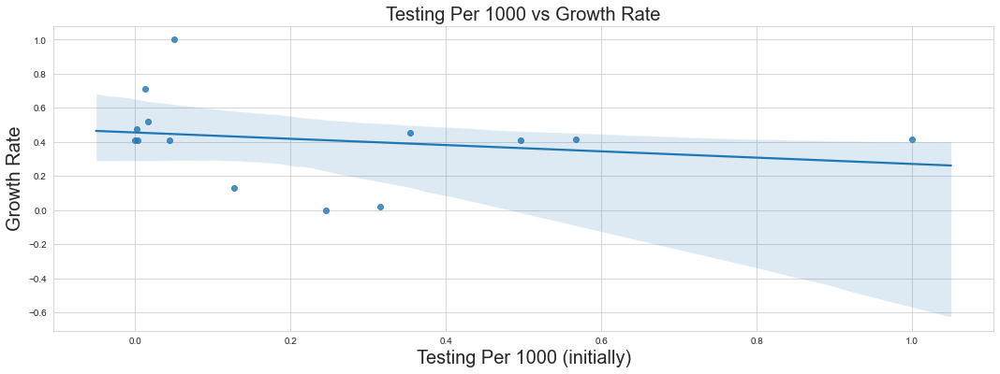

In [122]:
# Plotting a Graph: Testing VS Growth Rate

#low_testing2 = low_testing2.drop(['France'])

plt.figure(figsize=(18,6))
sns.regplot(x="Tests per 1000 initially", y="Growth Rate", data=low_testing2);
plt.xlabel('Testing Per 1000 (initially)', fontsize = 20)
plt.ylabel('Growth Rate', fontsize = 20)
plt.title('Testing Per 1000 vs Growth Rate', fontsize=20)

In [125]:
# Normalizing Dataset

complete2 = complete2.set_index('Entity')
from sklearn import preprocessing

x = complete2.values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
complete2 = pd.DataFrame(x_scaled)

In [126]:
complete.drop([ 'Czech Republic','Malaysia', 'Japan'], inplace=True)
complete = complete.reset_index()
complete2['Country'] = complete['Entity']
complete2 = complete2.rename({0: 'Deaths Per Million', 1: 'Cases Per Million', 2: 'Mean Drop in Mobility', 3: 'Testing Per 1000 (Current)', 4:"Tests per 1000 initially", 5: 'Population Density', 6: 'Share whose population is 70% or over', 7: 'Beds Per 1000', 8:'Mean temperature', 9: 'Recovery rate', 10: 'Growth Rate'}, axis='columns')
complete2

,Deaths Per Million,Cases Per Million,Mean Drop in Mobility,Testing Per 1000 (Current),Tests per 1000 initially,Population Density,Share whose population is 70% or over,Beds Per 1000,Mean temperature,Recovery rate,Growth Rate,Country
0,0.004437,0.060493,0.579082,0.540818,0.502284,0.000000,0.576918,0.455696,0.961721,0.987740,0.724890,Australia
1,0.097244,0.417412,0.482143,0.705648,0.032547,0.204557,0.827472,0.924051,0.418865,0.960224,0.731600,Austria
2,1.000000,1.000000,0.492347,0.488015,0.023533,0.735851,0.765231,0.784810,0.507860,0.602986,0.745859,Belgium
3,0.114574,0.315300,0.568878,0.499731,0.387233,0.001626,0.623165,0.303797,0.000000,1.000000,0.726015,Canada
4,0.001031,0.028823,0.112245,0.041409,0.045165,0.186270,0.269870,0.113924,0.930763,0.991045,0.724680,Costa Rica
5,0.117787,0.369438,0.948980,0.716424,0.251830,0.265281,0.728953,0.405063,0.453753,0.942679,0.725938,Denmark
6,0.059617,0.323408,0.002551,0.065217,0.028738,0.128962,0.184298,0.164557,0.881663,0.661589,0.541413,Ecuador
7,0.059800,0.304528,0.714286,0.994223,0.017083,0.053397,0.809679,0.632911,0.350598,0.931839,0.725519,Estonia
8,0.055199,0.206147,0.920918,0.391116,0.257984,0.029334,0.793963,0.658228,0.255142,0.940820,0.728455,Finland
9,0.573487,0.485359,0.232143,0.237491,0.011635,0.234331,0.781155,0.772152,0.533972,0.675284,0.592158,France


In [127]:
complete2 = complete2.set_index('Country') # Setting the Country as index 
complete2

,Deaths Per Million,Cases Per Million,Mean Drop in Mobility,Testing Per 1000 (Current),Tests per 1000 initially,Population Density,Share whose population is 70% or over,Beds Per 1000,Mean temperature,Recovery rate,Growth Rate
Country,,,,,,,,,,,
Australia,0.004437,0.060493,0.579082,0.540818,0.502284,0.000000,0.576918,0.455696,0.961721,0.987740,0.724890
Austria,0.097244,0.417412,0.482143,0.705648,0.032547,0.204557,0.827472,0.924051,0.418865,0.960224,0.731600
Belgium,1.000000,1.000000,0.492347,0.488015,0.023533,0.735851,0.765231,0.784810,0.507860,0.602986,0.745859
Canada,0.114574,0.315300,0.568878,0.499731,0.387233,0.001626,0.623165,0.303797,0.000000,1.000000,0.726015
Costa Rica,0.001031,0.028823,0.112245,0.041409,0.045165,0.186270,0.269870,0.113924,0.930763,0.991045,0.724680
Denmark,0.117787,0.369438,0.948980,0.716424,0.251830,0.265281,0.728953,0.405063,0.453753,0.942679,0.725938
Ecuador,0.059617,0.323408,0.002551,0.065217,0.028738,0.128962,0.184298,0.164557,0.881663,0.661589,0.541413
Estonia,0.059800,0.304528,0.714286,0.994223,0.017083,0.053397,0.809679,0.632911,0.350598,0.931839,0.725519
Finland,0.055199,0.206147,0.920918,0.391116,0.257984,0.029334,0.793963,0.658228,0.255142,0.940820,0.728455


Text(0.5, 1.0, 'Cases Per Million Vs Mean Temperature')

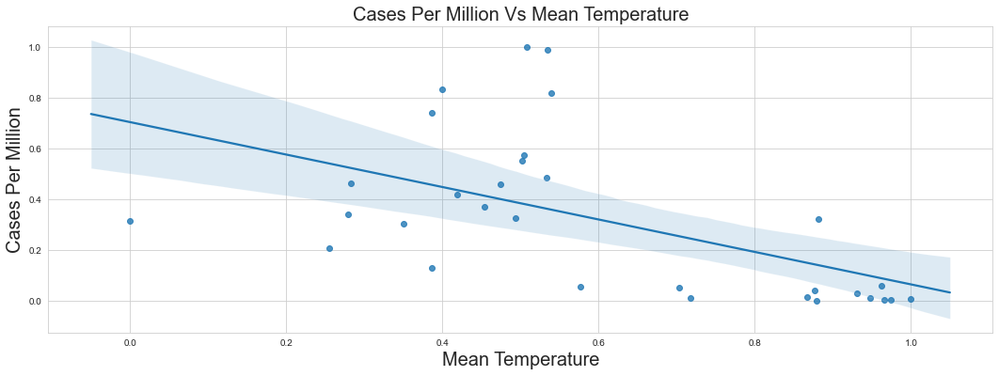

In [128]:
plt.figure(figsize=(18,6))
sns.regplot(x="Mean temperature", y="Cases Per Million", data=complete2);
plt.xlabel('Mean Temperature', fontsize = 20)
plt.ylabel('Cases Per Million', fontsize = 20)
plt.title('Cases Per Million Vs Mean Temperature', fontsize=20)

There is a trend where we can see hotter countries tend to have lesser number of cases. 

Text(0.5, 1.0, 'Beds Per 1000 vs Deaths Per Million')

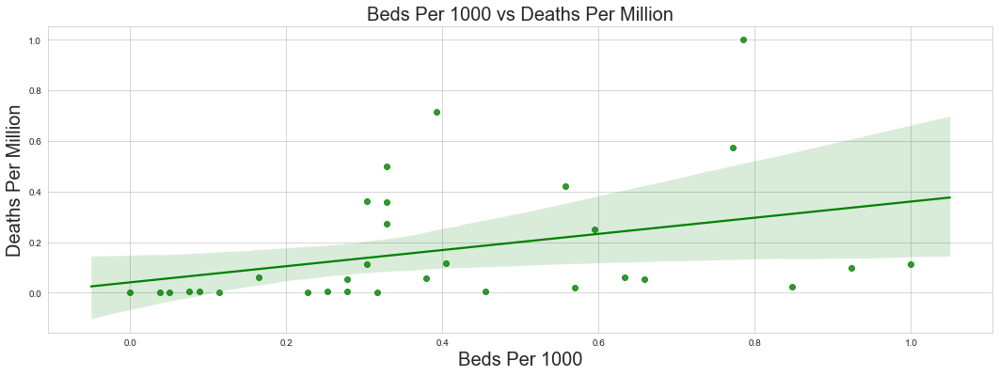

In [129]:
plt.figure(figsize=(18,6))
sns.regplot(x="Beds Per 1000", y="Deaths Per Million", data=complete2, color = 'green');
plt.xlabel('Beds Per 1000', fontsize = 20)
plt.ylabel('Deaths Per Million', fontsize = 20)
plt.title('Beds Per 1000 vs Deaths Per Million', fontsize=20)

It was anticipated that countries with less hospital beds would tend to have more deaths but as we know a lot of countries are reporting only hospital deaths and nothing outside, the trend which we see is exactly opposite. Countries with more beds are having more "Reported" deaths. 

Text(0.5, 1.0, 'Cases Per Million Vs Testing Per 1000')

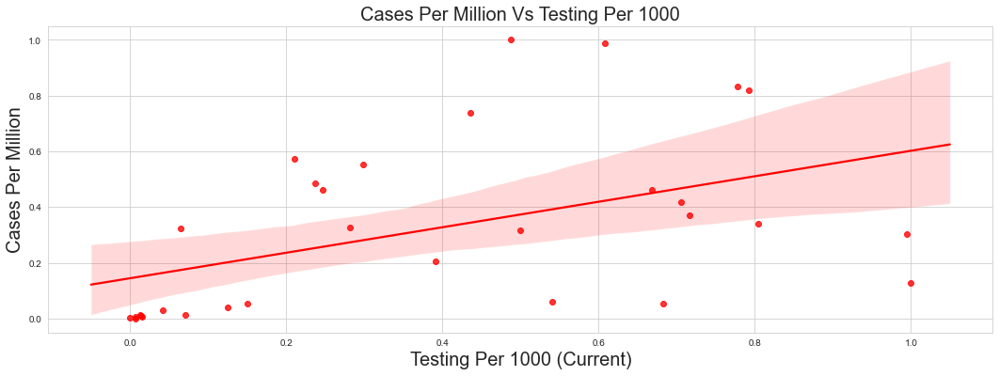

In [130]:
plt.figure(figsize=(18,6))
sns.regplot(x="Testing Per 1000 (Current)", y="Cases Per Million", data=complete2, color = 'red');
plt.xlabel('Testing Per 1000 (Current)', fontsize = 20)
plt.ylabel('Cases Per Million', fontsize = 20)
plt.title('Cases Per Million Vs Testing Per 1000', fontsize=20)

It is expected that if a country does more testing, there will be more cases! But what are the after effects of heavy testing ? It will discussed later in this project. 

Text(0.5, 1.0, 'Deaths Per Million Vs Population % aged > 70')

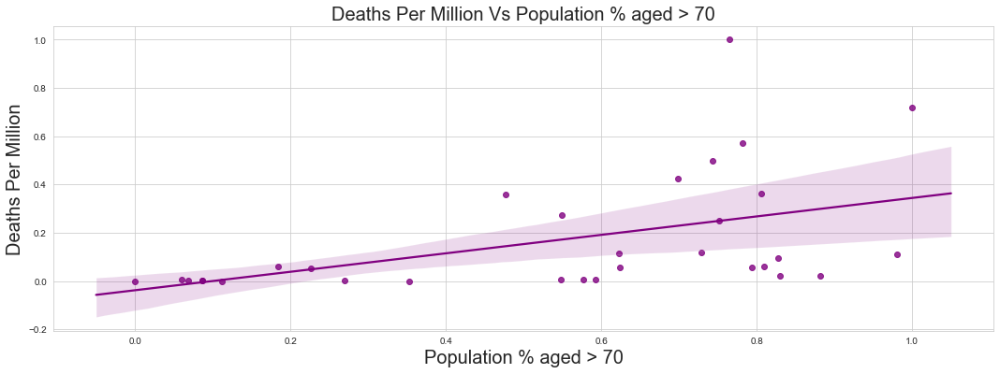

In [131]:
plt.figure(figsize=(18,6))
sns.regplot(x="Share whose population is 70% or over", y="Deaths Per Million", data=complete2, color = 'purple');
plt.xlabel('Population % aged > 70', fontsize = 20)
plt.ylabel('Deaths Per Million', fontsize = 20)
plt.title('Deaths Per Million Vs Population % aged > 70', fontsize=20)

There is a slight trend noticed here too. With more older population, a country stands a risk to have more deaths per million.

Text(0.5, 1.0, 'Cases Per Million Vs Population Density')

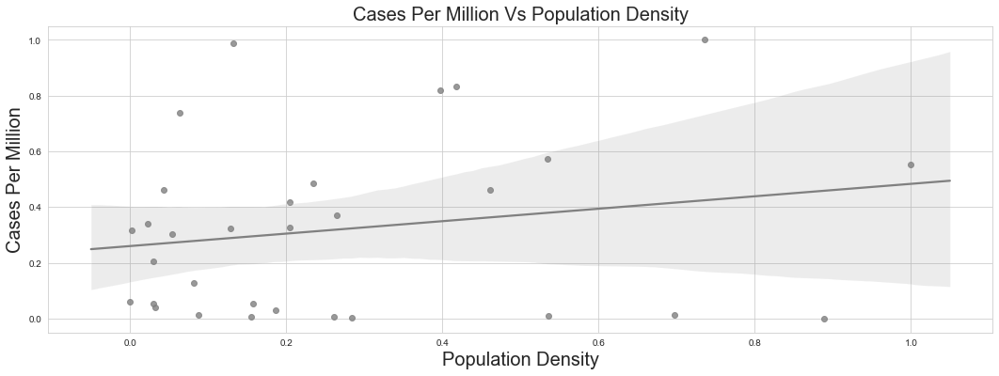

In [132]:
plt.figure(figsize=(18,6))
sns.regplot(x="Population Density", y="Cases Per Million", data=complete2, color = 'grey');
plt.xlabel('Population Density', fontsize = 20)
plt.ylabel('Cases Per Million', fontsize = 20)
plt.title('Cases Per Million Vs Population Density', fontsize=20)

There's a little trend noticed. Countries with high population density  are more likely to have more cases per million.

In [133]:
#complete2 = complete2.set_index('Country')
#complete2 = complete2.drop(['Indonesia', 'Lithuania'])
#complete2 = complete2.drop(['Estonia'])
complete2

,Deaths Per Million,Cases Per Million,Mean Drop in Mobility,Testing Per 1000 (Current),Tests per 1000 initially,Population Density,Share whose population is 70% or over,Beds Per 1000,Mean temperature,Recovery rate,Growth Rate
Country,,,,,,,,,,,
Australia,0.004437,0.060493,0.579082,0.540818,0.502284,0.000000,0.576918,0.455696,0.961721,0.987740,0.724890
Austria,0.097244,0.417412,0.482143,0.705648,0.032547,0.204557,0.827472,0.924051,0.418865,0.960224,0.731600
Belgium,1.000000,1.000000,0.492347,0.488015,0.023533,0.735851,0.765231,0.784810,0.507860,0.602986,0.745859
Canada,0.114574,0.315300,0.568878,0.499731,0.387233,0.001626,0.623165,0.303797,0.000000,1.000000,0.726015
Costa Rica,0.001031,0.028823,0.112245,0.041409,0.045165,0.186270,0.269870,0.113924,0.930763,0.991045,0.724680
Denmark,0.117787,0.369438,0.948980,0.716424,0.251830,0.265281,0.728953,0.405063,0.453753,0.942679,0.725938
Ecuador,0.059617,0.323408,0.002551,0.065217,0.028738,0.128962,0.184298,0.164557,0.881663,0.661589,0.541413
Estonia,0.059800,0.304528,0.714286,0.994223,0.017083,0.053397,0.809679,0.632911,0.350598,0.931839,0.725519
Finland,0.055199,0.206147,0.920918,0.391116,0.257984,0.029334,0.793963,0.658228,0.255142,0.940820,0.728455


Text(0.5, 1.0, 'Testing Per 1000 (Current) Vs Growth Rate')

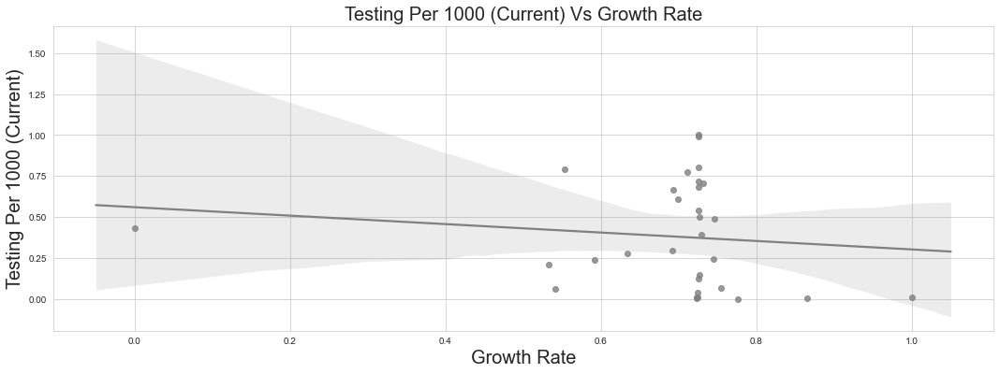

In [134]:
plt.figure(figsize=(18,6))
sns.regplot(x="Growth Rate", y="Testing Per 1000 (Current)", data=complete2, color = 'grey');
plt.xlabel('Growth Rate', fontsize = 20)
plt.ylabel('Testing Per 1000 (Current)', fontsize = 20)
plt.title('Testing Per 1000 (Current) Vs Growth Rate', fontsize=20)

There's no conclusive evidence from this graph as the slope is very less but it can be said that there is a slight tendency that a country would have higher growth rate if they do low testing. 

In [135]:
import seaborn as sns

cm = sns.light_palette("red", as_cmap=True)

s = complete2.style.background_gradient(cmap=cm)
s

,Deaths Per Million,Cases Per Million,Mean Drop in Mobility,Testing Per 1000 (Current),Tests per 1000 initially,Population Density,Share whose population is 70% or over,Beds Per 1000,Mean temperature,Recovery rate,Growth Rate
Country,,,,,,,,,,,
Australia,0.00443678,0.0604931,0.579082,0.540818,0.502284,0,0.576918,0.455696,0.961721,0.98774,0.72489
Austria,0.0972444,0.417412,0.482143,0.705648,0.0325472,0.204557,0.827472,0.924051,0.418865,0.960224,0.7316
Belgium,1,1,0.492347,0.488015,0.0235325,0.735851,0.765231,0.78481,0.50786,0.602986,0.745859
Canada,0.114574,0.3153,0.568878,0.499731,0.387233,0.00162567,0.623165,0.303797,0,1,0.726015
Costa Rica,0.0010306,0.0288232,0.112245,0.0414091,0.0451646,0.18627,0.26987,0.113924,0.930763,0.991045,0.72468
Denmark,0.117787,0.369438,0.94898,0.716424,0.25183,0.265281,0.728953,0.405063,0.453753,0.942679,0.725938
Ecuador,0.0596174,0.323408,0.00255102,0.0652174,0.0287375,0.128962,0.184298,0.164557,0.881663,0.661589,0.541413
Estonia,0.0598001,0.304528,0.714286,0.994223,0.017083,0.0533973,0.809679,0.632911,0.350598,0.931839,0.725519
Finland,0.0551985,0.206147,0.920918,0.391116,0.257984,0.0293339,0.793963,0.658228,0.255142,0.94082,0.728455


C:\Users\User\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


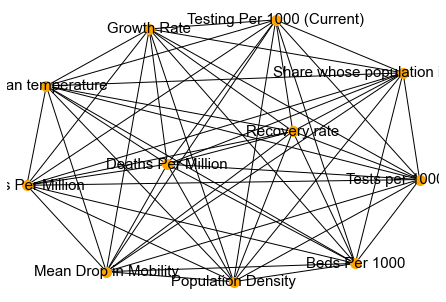

In [136]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
 

# Calculate the correlation 
corr = complete2.corr()
corr

links = corr.stack().reset_index()
links.columns = ['var1', 'var2','value']
links
 
#  Remove self correlation (cor(A,A)=1)
links_filtered=links.loc[(links['var1'] != links['var2']) ]
links_filtered
 
# Build your graph
G=nx.from_pandas_edgelist(links_filtered, 'var1', 'var2')
 
# Plot the network:
nx.draw(G, with_labels=True, node_color='orange', node_size=100, edge_color='black', linewidths=1, font_size=15, figsize=(50,10))


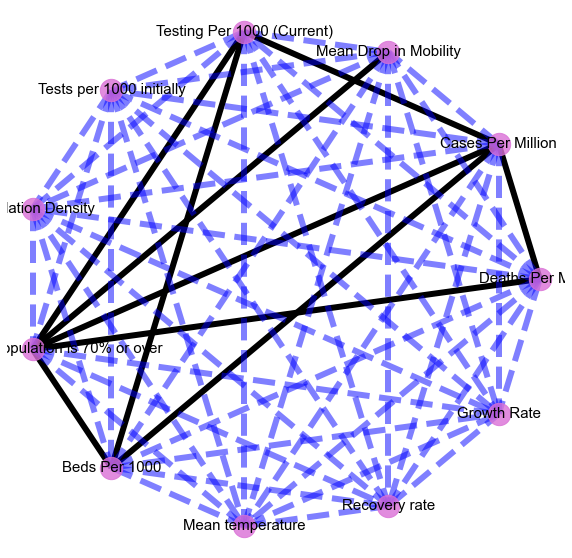

In [137]:
factors = corr.index.values

#Changes from dataframe to matrix, so it is easier to create a graph with networkx
corr = np.asmatrix(corr)

G = nx.from_numpy_matrix(corr)

#relabels the nodes to match the  stocks names
G = nx.relabel_nodes(G,lambda x: factors[x])

#shows the edges with their corresponding weights
G.edges(data=True)


    #crates a list for edges and for the weights
edges,weights = zip(*nx.get_edge_attributes(G,'weight').items())
weights = tuple([(1+abs(x))**2 for x in weights])

elarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >0.4]
esmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <=0.4]


    #positions
positions=nx.circular_layout(G)
    
    #Figure size
plt.figure(figsize=(10,10))

    #draws nodes
nx.draw_networkx_nodes(G,positions,node_color='#DA70D6',
                           node_size=500,alpha=0.8)
    
    #Styling for labels
nx.draw_networkx_labels(G, positions, font_size=15, font_family='sans-serif')
#nx.draw_networkx_labels(G,pos=nx.spring_layout(G))

nx.draw_networkx_edges(G,positions,edgelist=elarge,width=6)
nx.draw_networkx_edges(G,positions,edgelist=esmall,
                    width=6,alpha=0.5,edge_color='b',style='dashed')
        
    
    # displays the graph without axis
plt.axis('off')
    #saves image
plt.savefig("part1.png", format="PNG")
plt.show() 




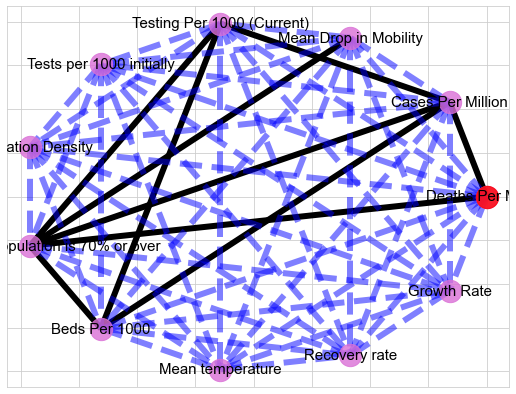

In [138]:
ego_node = "Deaths Per Million"
eg = nx.ego_graph( G, ego_node )

positions=nx.circular_layout(G)
    
    #Figure size
plt.figure(figsize=(9,7))
# lay out all nodes
pos = nx.spring_layout(eg)

nx.draw_networkx_nodes(eg,positions,node_color='#DA70D6',node_size=500,alpha=0.8)
nx.draw_networkx_nodes(eg,positions,nodelist=[ego_node],node_color='red',
                           node_size=500,alpha=0.8,center=True)
    
    #Styling for labels
nx.draw_networkx_labels(eg, positions, font_size=15, font_family='sans-serif')


nx.draw_networkx_edges(eg,positions,edgelist=elarge,width=6)
nx.draw_networkx_edges(eg,positions,edgelist=esmall,
                    width=6,alpha=0.5,edge_color='b',style='dashed')


In [139]:
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

In [140]:
exp = complete2.iloc[:, 0:11]
print(exp.describe())

       Deaths Per Million  Cases Per Million  Mean Drop in Mobility  \
count           31.000000          31.000000              31.000000   
mean             0.169636           0.320362               0.498930   
std              0.247835           0.310907               0.272981   
min              0.000000           0.000000               0.000000   
25%              0.004957           0.034021               0.274235   
50%              0.056434           0.315300               0.492347   
75%              0.261596           0.473857               0.700255   
max              1.000000           1.000000               1.000000   

       Testing Per 1000 (Current)  Tests per 1000 initially  \
count                   31.000000                 31.000000   
mean                     0.383561                  0.132284   
std                      0.321763                  0.246429   
min                      0.000000                  0.000000   
25%                      0.068267            

In [141]:
X =exp.iloc[:,exp.columns != 'Deaths Per Million']
Y = exp.iloc[:, 0]
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state= 0)

In [142]:
# Performing Multiple Linear Regression on a dataset
model = linear_model.LinearRegression()
model.fit(X_train, Y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [143]:
coeff_df = pd.DataFrame(model.coef_, X.columns, columns=['Coefficient']) # Having a look at the impact of different factors
coeff_df

,Coefficient
Cases Per Million,0.535454
Mean Drop in Mobility,-0.145489
Testing Per 1000 (Current),-0.156954
Tests per 1000 initially,-0.062209
Population Density,0.119554
Share whose population is 70% or over,0.393809
Beds Per 1000,-0.082527
Mean temperature,0.017397
Recovery rate,-0.077476
Growth Rate,0.018188


In [144]:
#Dropping the unnecessary factors 
coeff_df = coeff_df.drop(['Mean Drop in Mobility','Testing Per 1000 (Current)', 'Tests per 1000 initially','Recovery rate','Growth Rate'])
coeff_df

,Coefficient
Cases Per Million,0.535454
Population Density,0.119554
Share whose population is 70% or over,0.393809
Beds Per 1000,-0.082527
Mean temperature,0.017397


In [145]:
import statsmodels.api as sm
X= np.append(arr = np.ones((31,1)).astype(int), values = X, axis=1) 
X_opt= X[:, [0,1,2,3,4,5,6,7,8]]
regressor_OLS=sm.OLS(endog = Y, exog = X_opt).fit()
regressor_OLS.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:     Deaths Per Million   R-squared:                       0.815
Model:                            OLS   Adj. R-squared:                  0.748
Method:                 Least Squares   F-statistic:                     12.14
Date:                Mon, 11 May 2020   Prob (F-statistic):           1.78e-06
Time:                        04:48:45   Log-Likelihood:                 25.944
No. Observations:                  31   AIC:                            -33.89
Df Residuals:                      22   BIC:                            -20.98
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.1434      0.144     -0.999      0.329      -0.441       0.154
x1             0.6224      0.100      6.227      0.000       0.415       0.830
x2            -0.0998      0.102     -0.976      0.340      -0.312       0.112
x3            -0.1959      0.117     -1.680      0.107      -0.438       0.046
x4            -0.0945      0.108     -0.877      0.390      -0.318       0.129
x5             0.1633      0.096      1.695      0.104      -0.037       0.363
x6             0.3640      0.152      2.389      0.026       0.048       0.680
x7            -0.0804      0.148     -0.543      0.593      -0.388       0.227
x8             0.0698      0.138      0.506      0.618      -0.216       0.356
==============================================================================
Omnibus:                        2.525   Durbin-Watson:                   2.169
Prob(Omnibus):                  0.283   Jarque-Bera (JB):                1.403
Skew:                           0.482   Prob(JB):                        0.496
Kurtosis:                       3.396   Cond. No.                         15.0
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

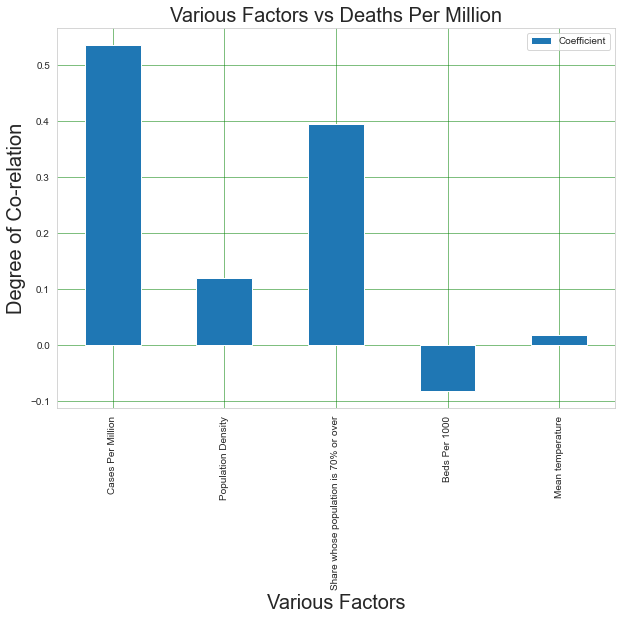

In [146]:
coeff_df.plot(kind='bar',figsize=(10,7))
plt.grid(which='major', linestyle='-', linewidth='0.5', color='green')
plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
plt.title('Various Factors vs Deaths Per Million', fontsize=20)
plt.ylabel('Degree of Co-relation', fontsize=20)
plt.xlabel('Various Factors', fontsize=20)
plt.show()

In [147]:
exp = complete2.iloc[:, 0:11]
#exp.columns = ['x1','x2','x3','x4','x5','x6', 'x7', 'x8']
print(exp.describe())

       Deaths Per Million  Cases Per Million  Mean Drop in Mobility  \
count           31.000000          31.000000              31.000000   
mean             0.169636           0.320362               0.498930   
std              0.247835           0.310907               0.272981   
min              0.000000           0.000000               0.000000   
25%              0.004957           0.034021               0.274235   
50%              0.056434           0.315300               0.492347   
75%              0.261596           0.473857               0.700255   
max              1.000000           1.000000               1.000000   

       Testing Per 1000 (Current)  Tests per 1000 initially  \
count                   31.000000                 31.000000   
mean                     0.383561                  0.132284   
std                      0.321763                  0.246429   
min                      0.000000                  0.000000   
25%                      0.068267            

In [148]:
X =exp.iloc[:,exp.columns != 'Cases Per Million']
Y = exp.iloc[:, 1]
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state= 0)

In [149]:
model = linear_model.LinearRegression()
model.fit(X_train, Y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [150]:
coeff_df = pd.DataFrame(model.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Deaths Per Million,1.096538
Mean Drop in Mobility,0.201386
Testing Per 1000 (Current),0.281700
Tests per 1000 initially,-0.027971
Population Density,-0.041440
Share whose population is 70% or over,-0.436699
Beds Per 1000,-0.011049
Mean temperature,-0.191314
Recovery rate,0.052614
Growth Rate,-0.637178


In [151]:
coeff_df = coeff_df.drop(['Deaths Per Million','Beds Per 1000','Recovery rate','Growth Rate'])
coeff_df

,Coefficient
Mean Drop in Mobility,0.201386
Testing Per 1000 (Current),0.281700
Tests per 1000 initially,-0.027971
Population Density,-0.041440
Share whose population is 70% or over,-0.436699
Mean temperature,-0.191314


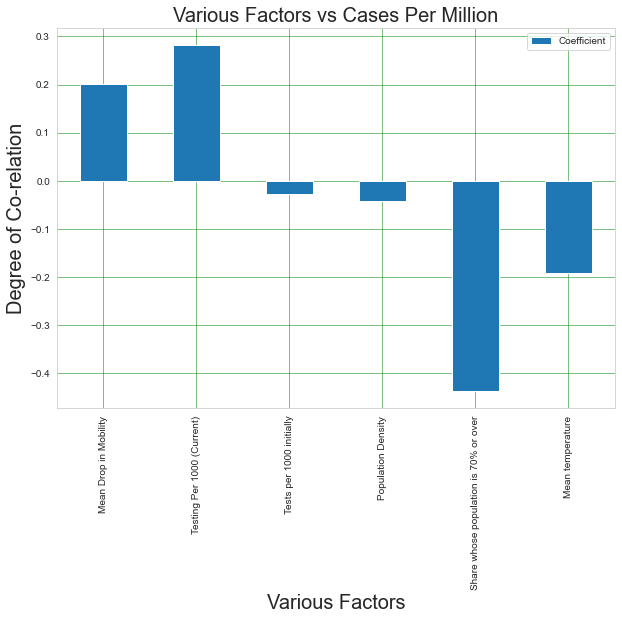

In [152]:
coeff_df.plot(kind='bar',figsize=(10,7))
plt.grid(which='major', linestyle='-', linewidth='0.5', color='green')
plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
plt.title('Various Factors vs Cases Per Million', fontsize=20)
plt.ylabel('Degree of Co-relation', fontsize=20)
plt.xlabel('Various Factors', fontsize=20)
plt.show()

In [153]:
import statsmodels.api as sm
X= np.append(arr = np.ones((31,1)).astype(int), values = X, axis=1) 
X_opt= X[:, [0,1,2,3,4,5,6,7,8]]
regressor_OLS=sm.OLS(endog = Y, exog = X_opt).fit()
regressor_OLS.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:      Cases Per Million   R-squared:                       0.807
Model:                            OLS   Adj. R-squared:                  0.736
Method:                 Least Squares   F-statistic:                     11.48
Date:                Mon, 11 May 2020   Prob (F-statistic):           2.86e-06
Time:                        04:48:54   Log-Likelihood:                 18.211
No. Observations:                  31   AIC:                            -18.42
Df Residuals:                      22   BIC:                            -5.515
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.2833      0.179      1.587      0.127      -0.087       0.654
x1             1.0251      0.165      6.227      0.000       0.684       1.366
x2             0.0425      0.134      0.317      0.754      -0.235       0.320
x3             0.2797      0.147      1.898      0.071      -0.026       0.585
x4             0.0911      0.139      0.654      0.520      -0.198       0.380
x5            -0.0278      0.131     -0.211      0.835      -0.300       0.245
x6            -0.2631      0.212     -1.240      0.228      -0.703       0.177
x7             0.0359      0.191      0.188      0.853      -0.361       0.432
x8            -0.2359      0.171     -1.381      0.181      -0.590       0.118
==============================================================================
Omnibus:                        8.171   Durbin-Watson:                   1.994
Prob(Omnibus):                  0.017   Jarque-Bera (JB):                6.676
Skew:                           1.075   Prob(JB):                       0.0355
Kurtosis:                       3.737   Cond. No.                         15.0
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

<b> Impact of Various Factors on Deaths Per Million <b> 

In [154]:
exp = complete2.iloc[:, 0:11]
print(exp.describe())

       Deaths Per Million  Cases Per Million  Mean Drop in Mobility  \
count           31.000000          31.000000              31.000000   
mean             0.169636           0.320362               0.498930   
std              0.247835           0.310907               0.272981   
min              0.000000           0.000000               0.000000   
25%              0.004957           0.034021               0.274235   
50%              0.056434           0.315300               0.492347   
75%              0.261596           0.473857               0.700255   
max              1.000000           1.000000               1.000000   

       Testing Per 1000 (Current)  Tests per 1000 initially  \
count                   31.000000                 31.000000   
mean                     0.383561                  0.132284   
std                      0.321763                  0.246429   
min                      0.000000                  0.000000   
25%                      0.068267            

In [155]:
X =exp.iloc[:,exp.columns != 'Growth Rate']
Y = exp.iloc[:, 10]
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state= 0)

In [156]:
model = linear_model.LinearRegression()
model.fit(X_train, Y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [157]:
coeff_df = pd.DataFrame(model.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Deaths Per Million,0.007744
Cases Per Million,-0.132480
Mean Drop in Mobility,0.159111
Testing Per 1000 (Current),0.029717
Tests per 1000 initially,0.025641
Population Density,0.126654
Share whose population is 70% or over,-0.167179
Beds Per 1000,-0.025414
Mean temperature,-0.105742
Recovery rate,0.149096


In [158]:
coeff_df = coeff_df.drop(['Cases Per Million','Tests per 1000 initially','Beds Per 1000','Recovery rate'])
coeff_df

,Coefficient
Deaths Per Million,0.007744
Mean Drop in Mobility,0.159111
Testing Per 1000 (Current),0.029717
Population Density,0.126654
Share whose population is 70% or over,-0.167179
Mean temperature,-0.105742


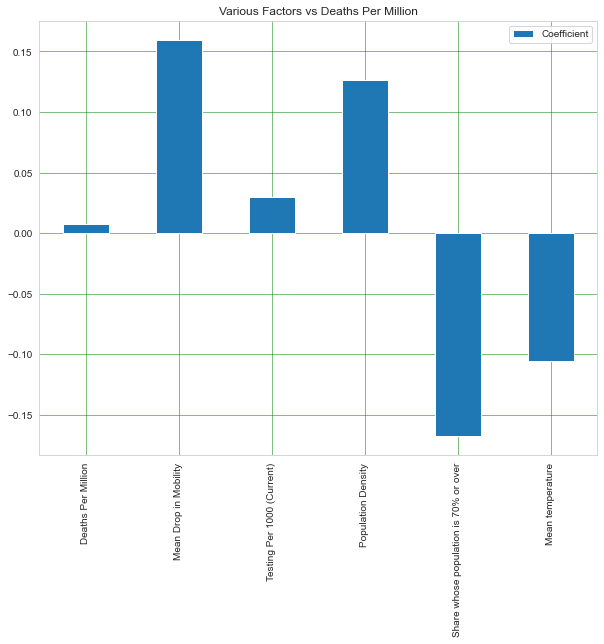

In [159]:
coeff_df.plot(kind='bar',figsize=(10,8))
plt.grid(which='major', linestyle='-', linewidth='0.5', color='green')
plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
plt.title('Various Factors vs Deaths Per Million')
plt.show()

## <b> Case Studies: 
        
   <b> Germany vs Italy

In [160]:
complete2 = complete2.reset_index()

In [161]:
case1 = complete.loc[complete['Entity'] == 'Italy']  
case2 = complete.loc[complete['Entity'] == 'Germany']

In [162]:
case2

,Entity,Total confirmed deaths due to COVID-19 per million people (deaths per million),Code_x,Total confirmed cases of COVID-19 per million people (cases per million),Mean Drop in Mobility,Total tests per thousand (Current),Tests per 1000 initially,Population Density,Percentage > 70,hospital_beds,Jan_Temp,Feb_temp,Mar_temp,Apr_Temp,Mean Temperature
10,Germany,70.57438,DEU,1865.954151,-19.6,25.111,1.064484,237.37097,15.957,8.2,-0.48,0.56,3.87,7.69,2.91


In [163]:
case1

,Entity,Total confirmed deaths due to COVID-19 per million people (deaths per million),Code_x,Total confirmed cases of COVID-19 per million people (cases per million),Mean Drop in Mobility,Total tests per thousand (Current),Tests per 1000 initially,Population Density,Percentage > 70,hospital_beds,Jan_Temp,Feb_temp,Mar_temp,Apr_Temp,Mean Temperature
15,Italy,446.182342,ITA,3298.180134,-70.2,29.724,0.910267,205.450748,16.24,3.4,3.32,4.35,6.52,9.61,5.95


If we look at these two countries, number of cases are pretty much similar but then if we look at total confirmed cases per million, we notice that there is a huge difference between the two.
Germany - 1865.95 per million
Italy - 3298.18 per million

From the deaths per million, we see germany is very less affected compared to Italy. A major credit goes to the medical facility available in Germany. Hospital beds per 1000 people available for germany is 8.2 while the same for italy is only 3.4.

Even if we compare the age percentage of people more than 70, Italy's age ratio stands a little higher with 16.24% compared to Germany's 15.96% 

<B> FRANCE VS IRAN 

In [164]:
case1 = complete.loc[complete['Entity'] == 'France']  
case2 = complete.loc[complete['Entity'] == 'Ecuador']

In [165]:
case1

,Entity,Total confirmed deaths due to COVID-19 per million people (deaths per million),Code_x,Total confirmed cases of COVID-19 per million people (cases per million),Mean Drop in Mobility,Total tests per thousand (Current),Tests per 1000 initially,Population Density,Percentage > 70,hospital_beds,Jan_Temp,Feb_temp,Mar_temp,Apr_Temp,Mean Temperature
9,France,356.852256,FRA,1966.172741,-66.6,9.056,0.192739,122.338396,13.079,6.4,3.11,4.22,6.37,9.1,5.7


In [166]:
case2

,Entity,Total confirmed deaths due to COVID-19 per million people (deaths per million),Code_x,Total confirmed cases of COVID-19 per million people (cases per million),Mean Drop in Mobility,Total tests per thousand (Current),Tests per 1000 initially,Population Density,Percentage > 70,hospital_beds,Jan_Temp,Feb_temp,Mar_temp,Apr_Temp,Mean Temperature
6,Ecuador,37.578515,ECU,1317.231818,-84.6,2.645,0.475956,68.788682,4.458,1.6,21.71,21.78,21.93,21.96,21.845


We can see that both France and Equador faced problems as they got a huge number of cases per million. The greater thing to worry about for Equador was it's incapability to serve people in hospitals as they have only 1.6 beds available for every 1000 people. So what saved them? 

Equador's young population. Equadoronly has 4.45% of people aged > 70, hence most of them affected had only mild symptoms and they were just isolated in isolation camps and they didn't need a lot of medical attention like the older people. On the other hand, France has 13.07% of people who are aged > 70 but because of its good availability of hospital beds, they were able to treat them. 

This is also one of the reasons France has more deaths per million than Equador.

We can clearly see how relevant average age and hospital beds available is for every country to combat against this pandemic. 

## Case Study : Effect of Testing on Growth Rate

<b> Country taken into consideration: Norway.

In [167]:
world_testing = pd.read_csv("full-list-cumulative-total-tests-per-thousand (2).csv") #Reading csv having data on testing 
world_testing['Date'] = pd.to_datetime(world_testing['Date'])
world_testing = world_testing.set_index('Date')
world_testing

,Entity,Code,Total tests per thousand
Date,,,
2020-04-08,Argentina,ARG,0.293
2020-04-09,Argentina,ARG,0.326
2020-04-10,Argentina,ARG,0.360
2020-04-11,Argentina,ARG,0.396
2020-04-13,Argentina,ARG,0.434
...,...,...,...
2020-04-10,Vietnam,VNM,1.208
2020-04-11,Vietnam,VNM,1.239
2020-04-14,Vietnam,VNM,1.350


In [168]:
Norwayy = world_testing.loc[world_testing['Entity'] == 'Norway'] #Getting Data for Norway
Norwayy

,Entity,Code,Total tests per thousand
Date,,,
2020-03-16,Norway,NOR,3.314
2020-03-17,Norway,NOR,3.972
2020-03-18,Norway,NOR,5.234
2020-03-19,Norway,NOR,6.346
2020-03-20,Norway,NOR,8.025
2020-03-21,Norway,NOR,9.074
2020-03-22,Norway,NOR,9.981
2020-03-23,Norway,NOR,11.239
2020-03-24,Norway,NOR,12.956


In [169]:
import plotly.express as px
import plotly.graph_objects as go
Norwayy = Norwayy.reset_index()
fig = px.line(Norwayy, x='Date', y='Total tests per thousand', title = 'Total Tests For Covid-19 Per 1000 People in Norway')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

From this graph, we can see that their rates of testing kept going up throughout. Even though they saw a drop in their growth rate initially, they didnt not hold back their testing rates. Instead, it kept going upwards throughout. 

As established before, testing can be one of the possible reasons for the country's improvement.

In [170]:
Norway = confirmed_df.loc[confirmed_df['Country/Region'] == 'Norway']
Norway_deaths = deaths_df.loc[deaths_df['Country/Region'] == 'Norway']
Norway.drop(Norway.iloc[:, 0:4], inplace = True, axis = 1)
Norway_deaths.drop(Norway_deaths.iloc[:, 0:4], inplace = True, axis = 1)
Norway = Norway.T[Norway.any()].T
Norway_deaths = Norway_deaths.T[Norway_deaths.any()].T
Norway_deaths

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
175,3,3,3,3,6,7,7,7,7,10,...,210,210,211,211,214,215,216,217,218,219


In [171]:
Norway2 = Norway.copy() 
column_list = []
length = len(Norway2.columns)
for i in range(length):
    if(i>0):
        Norway2.iloc[0,i] = Norway2.iloc[0,i] - Norway.iloc[0,i-1] 
Norway2

,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
175,1,0,5,9,4,6,7,24,31,21,...,28,45,26,38,57,51,41,38,36,29


In [172]:
Norway_deaths2 = Norway_deaths.copy()
column_list = []
length = len(Norway_deaths2.columns)
for i in range(length):
    if(i>0):
        Norway_deaths2.iloc[0,i] = Norway_deaths2.iloc[0,i] - Norway_deaths.iloc[0,i-1]
Norway_deaths2

,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
175,3,0,0,0,3,1,0,0,0,3,...,3,0,1,0,3,1,1,1,1,1


In [173]:
Norway_cases = []

dates = Norway2.keys()

for i in dates:
    confirmed_sum_Norway = Norway2[i].sum()
    Norway_cases.append(confirmed_sum_Norway)

In [174]:
Norway_deaths_cases = []

dates2 =Norway_deaths2.keys()

for i in dates2:
    death_sum_Norway = Norway_deaths2[i].sum()
    Norway_deaths_cases.append(death_sum_Norway)

In [175]:
Norway_deaths_dates = Norway_deaths2.columns.get_values()
Norway_deaths_dates

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning:

The 'get_values' method is deprecated and will be removed in a future version. Use '.to_numpy()' or '.array' instead.



array(['3/14/20', '3/15/20', '3/16/20', '3/17/20', '3/18/20', '3/19/20',
       '3/20/20', '3/21/20', '3/22/20', '3/23/20', '3/24/20', '3/25/20',
       '3/26/20', '3/27/20', '3/28/20', '3/29/20', '3/30/20', '3/31/20',
       '4/1/20', '4/2/20', '4/3/20', '4/4/20', '4/5/20', '4/6/20',
       '4/7/20', '4/8/20', '4/9/20', '4/10/20', '4/11/20', '4/12/20',
       '4/13/20', '4/14/20', '4/15/20', '4/16/20', '4/17/20', '4/18/20',
       '4/19/20', '4/20/20', '4/21/20', '4/22/20', '4/23/20', '4/24/20',
       '4/25/20', '4/26/20', '4/27/20', '4/28/20', '4/29/20', '4/30/20',
       '5/1/20', '5/2/20', '5/3/20', '5/4/20', '5/5/20', '5/6/20',
       '5/7/20', '5/8/20', '5/9/20'], dtype=object)

In [176]:
d = {'Norway Cases':Norway_cases, 'Date':dates} #Dataframe for Norway cases
df = pd.DataFrame(data=d)

In [177]:
df = df.iloc[19:len(df)-5]
df = df.set_index('Date')
df

,Norway Cases
Date,
3/16/20,112
3/17/20,130
3/18/20,87
3/19/20,196
3/20/20,168
3/21/20,204
3/22/20,267
3/23/20,236
3/24/20,242


In [178]:
df = df.reset_index()
df['Date'] = pd.to_datetime(df['Date']) # Change it to datetime object.
df['Date']

0    2020-03-16
1    2020-03-17
2    2020-03-18
3    2020-03-19
4    2020-03-20
5    2020-03-21
6    2020-03-22
7    2020-03-23
8    2020-03-24
9    2020-03-25
10   2020-03-26
11   2020-03-27
12   2020-03-28
13   2020-03-29
14   2020-03-30
15   2020-03-31
16   2020-04-01
17   2020-04-02
18   2020-04-03
19   2020-04-04
20   2020-04-05
21   2020-04-06
22   2020-04-07
23   2020-04-08
24   2020-04-09
25   2020-04-10
26   2020-04-11
27   2020-04-12
28   2020-04-13
29   2020-04-14
30   2020-04-15
31   2020-04-16
32   2020-04-17
33   2020-04-18
34   2020-04-19
35   2020-04-20
36   2020-04-21
37   2020-04-22
38   2020-04-23
39   2020-04-24
40   2020-04-25
41   2020-04-26
42   2020-04-27
43   2020-04-28
44   2020-04-29
45   2020-04-30
46   2020-05-01
47   2020-05-02
48   2020-05-03
49   2020-05-04
Name: Date, dtype: datetime64[ns]

In [179]:
#Plotting a graph for number of cases per day in Norway

import plotly.express as px
import plotly.graph_objects as go
fig = px.line(df, x='Date', y='Norway Cases', title = 'Number of Cases per day in Norway')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

Until around 27th March, the cases were rising but it is noticed that it started falling at a rapid rate after that. Heavy testing could be one of the possible reasons towards the downfall of cases.

In [180]:
d = {'Norway Deaths':Norway_deaths_cases, 'Date':Norway_deaths_dates} #Dataframe for Norway Deaths
df2 = pd.DataFrame(data=d)

In [181]:
df2 = df2.iloc[2:40]
df2 = df2.set_index('Date')
df2

,Norway Deaths
Date,
3/16/20,0
3/17/20,0
3/18/20,3
3/19/20,1
3/20/20,0
3/21/20,0
3/22/20,0
3/23/20,3
3/24/20,2


In [182]:
df2 = df2.reset_index()
df2['Date'] = pd.to_datetime(df2['Date'])
df2['Date']

0    2020-03-16
1    2020-03-17
2    2020-03-18
3    2020-03-19
4    2020-03-20
5    2020-03-21
6    2020-03-22
7    2020-03-23
8    2020-03-24
9    2020-03-25
10   2020-03-26
11   2020-03-27
12   2020-03-28
13   2020-03-29
14   2020-03-30
15   2020-03-31
16   2020-04-01
17   2020-04-02
18   2020-04-03
19   2020-04-04
20   2020-04-05
21   2020-04-06
22   2020-04-07
23   2020-04-08
24   2020-04-09
25   2020-04-10
26   2020-04-11
27   2020-04-12
28   2020-04-13
29   2020-04-14
30   2020-04-15
31   2020-04-16
32   2020-04-17
33   2020-04-18
34   2020-04-19
35   2020-04-20
36   2020-04-21
37   2020-04-22
Name: Date, dtype: datetime64[ns]

In [183]:
# Merging testing dataset with cases
Norwayy['Cases'] = ''

caselist = []
for i,rows in Norwayy.iterrows():
    for j,row in df.iterrows():
        if rows['Date'] == row['Date']:
            rows['Cases'] = row['Norway Cases']
            caselist.append([rows['Cases']])
            
            
Norwayy['Cases'] = caselist 

In [184]:
Norwayy['Cases'] = pd.to_numeric(Norwayy['Cases'].str[0]) #Making it of numeric data type
Norwayy

,Date,Entity,Code,Total tests per thousand,Cases
0,2020-03-16,Norway,NOR,3.314,112
1,2020-03-17,Norway,NOR,3.972,130
2,2020-03-18,Norway,NOR,5.234,87
3,2020-03-19,Norway,NOR,6.346,196
4,2020-03-20,Norway,NOR,8.025,168
5,2020-03-21,Norway,NOR,9.074,204
6,2020-03-22,Norway,NOR,9.981,267
7,2020-03-23,Norway,NOR,11.239,236
8,2020-03-24,Norway,NOR,12.956,242
9,2020-03-25,Norway,NOR,13.412,221


In [185]:
# Merging the deaths dataset 

Norwayy['Deaths'] = ''

caselist = []
for i,rows in Norwayy.iterrows():
    for j,row in df2.iterrows():
        if rows['Date'] == row['Date']:
            rows['Deaths'] = row['Norway Deaths']
            caselist.append([rows['Deaths']])
            
            
Norwayy['Deaths'] = caselist

In [186]:
Norwayy['Deaths'] = pd.to_numeric(Norwayy['Deaths'].str[0]) 
Norwayy

,Date,Entity,Code,Total tests per thousand,Cases,Deaths
0,2020-03-16,Norway,NOR,3.314,112,0
1,2020-03-17,Norway,NOR,3.972,130,0
2,2020-03-18,Norway,NOR,5.234,87,3
3,2020-03-19,Norway,NOR,6.346,196,1
4,2020-03-20,Norway,NOR,8.025,168,0
5,2020-03-21,Norway,NOR,9.074,204,0
6,2020-03-22,Norway,NOR,9.981,267,0
7,2020-03-23,Norway,NOR,11.239,236,3
8,2020-03-24,Norway,NOR,12.956,242,2
9,2020-03-25,Norway,NOR,13.412,221,2


In [187]:
#Normalizing Dataset

Norwayy = Norwayy.set_index("Date")
Norwayy = Norwayy.drop(['Entity', 'Code'], axis = 1)
from sklearn import preprocessing

x = Norwayy.values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
Norwayy = pd.DataFrame(x_scaled)

In [188]:
Norwayy = Norwayy.rename({0:'Total tests per thousand', 1: 'Cases', 2: 'Deaths'}, axis = 'columns')
Norwayy

,Total tests per thousand,Cases,Deaths
0,0.000000,0.290155,0.000000
1,0.028894,0.336788,0.000000
2,0.084310,0.225389,0.230769
3,0.133140,0.507772,0.076923
4,0.206868,0.435233,0.000000
5,0.252931,0.528497,0.000000
6,0.292759,0.691710,0.000000
7,0.348000,0.611399,0.230769
8,0.423396,0.626943,0.153846
9,0.443420,0.572539,0.153846


In [189]:
Norwayy['Date'] = df['Date']
Norwayy

,Total tests per thousand,Cases,Deaths,Date
0,0.000000,0.290155,0.000000,2020-03-16
1,0.028894,0.336788,0.000000,2020-03-17
2,0.084310,0.225389,0.230769,2020-03-18
3,0.133140,0.507772,0.076923,2020-03-19
4,0.206868,0.435233,0.000000,2020-03-20
5,0.252931,0.528497,0.000000,2020-03-21
6,0.292759,0.691710,0.000000,2020-03-22
7,0.348000,0.611399,0.230769,2020-03-23
8,0.423396,0.626943,0.153846,2020-03-24
9,0.443420,0.572539,0.153846,2020-03-25


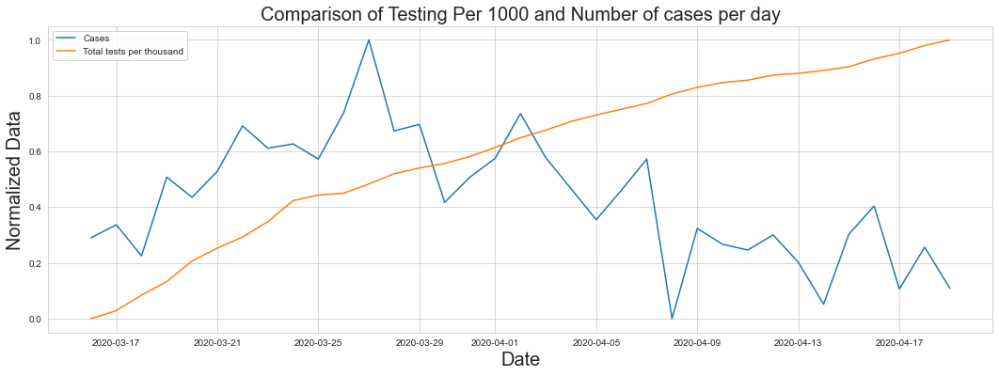

In [190]:
# Plotting Graph to see how testing impacts the number of cases per day.
x = Norwayy['Date']
y1 = Norwayy['Cases']
y2 = Norwayy['Total tests per thousand']
y3 = Norwayy['Deaths']

plt.figure(figsize = (18,6))
plt.plot(x,y1)
plt.plot(x,y2)
plt.title('Comparison of Testing Per 1000 and Number of cases per day', fontsize = 20)
plt.ylabel('Normalized Data', fontsize=20)
plt.xlabel('Date', fontsize=20)
plt.legend(['Cases', 'Total tests per thousand'])

It is noticed that initially, there is a rise in the number of cases with more testing which is obvious but it starts dropping as the testing levels keep going higher. Detailed description will be included in the report.

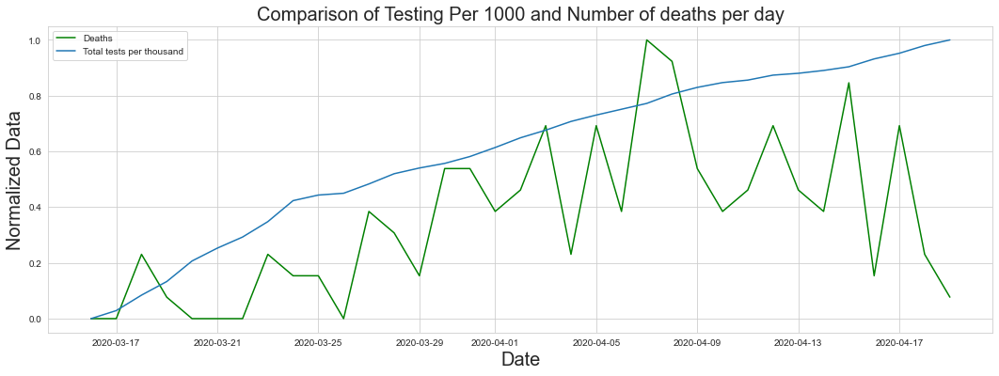

In [191]:
x = Norwayy['Date']
y1 = Norwayy['Cases']
y2 = Norwayy['Total tests per thousand']
y3 = Norwayy['Deaths']
plt.figure(figsize = (18,6))
plt.plot(x,y3, color = 'green')
plt.plot(x,y2)
plt.title('Comparison of Testing Per 1000 and Number of deaths per day', fontsize = 20)
plt.ylabel('Normalized Data', fontsize=20)
plt.xlabel('Date', fontsize=20)
plt.legend(['Deaths', 'Total tests per thousand'])

## <b> RESEARCH QUESTION 2: Have lockdown and social distancing measures reduced the number of novel cases globally? </b>
    
Approach: A complete dataset has been divided into two sectors (for every country): One after and one before lockdown. 
Two weeks after the lockdown has been included in 'Before Lockdown' Dataset as the incubation period is around 10-12 days   and we start seeing the effect only 2 weeks after the lockdown. The growth rates have been checked only for the past 7 days     before and after lockdown because calculating the mean of all days would be incorrect due to their large standard           deviation.

<b> Data Collection and Visualization <b>

In [192]:
# Dataset for Italy
Italy = confirmed_df.loc[confirmed_df['Country/Region'] == 'Italy'] # extracting the data from confirmed df
Italy.drop(Italy.iloc[:, 0:4], inplace = True, axis = 1)
Italy = Italy.T[Italy.any()].T
Italy

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
137,2,2,2,2,2,2,2,3,3,3,...,205463,207428,209328,210717,211938,213013,214457,215858,217185,218268


In [193]:
Italy2 = Italy.copy()
column_list = []
length = len(Italy2.columns)
for i in range(length):
    if(i>0):
        Italy2.iloc[0,i] = Italy2.iloc[0,i] - Italy.iloc[0,i-1]  #Getting the number of new cases per day
        
Italy_after_lockdown = Italy2.copy()

for i in range(length):
    if(i>0):
        Italy_after_lockdown.iloc[0,i] = Italy_after_lockdown.iloc[0,i] - Italy2.iloc[0,i-1] #Getting the number of increase or decrease in cases compared to its previous day

In [194]:
Italy_before_lockdown = Italy_after_lockdown.copy()
Italy_before_lockdown.drop(Italy_before_lockdown.iloc[:, 50:len(Italy_before_lockdown.columns)], inplace = True, axis = 1)
Italy_before_lockdown

,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,...,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20
137,2,-2,0,0,0,0,0,1,-1,0,...,1336,-2313,5198,-1701,93,-357,293,681,1115,664


In [195]:
Italy_after_lockdown.drop(Italy_after_lockdown.iloc[:, 0:50], inplace = True, axis = 1)
Italy_after_lockdown

,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
137,571,-997,-771,460,-39,993,-294,65,-757,-1167,...,-214,93,-65,-511,-168,-146,369,-43,-74,-244


In [196]:
#Calculating the mean growth rate of the last 7 days before and after lockdown 

Italy_last7days_beforelockdown =Italy_before_lockdown.copy()
Italy_last7days_beforelockdown.drop(Italy_last7days_beforelockdown.iloc[:, 0:len(Italy_last7days_beforelockdown.columns)-7], inplace = True, axis = 1)
Italy_last7days_beforelockdown_mean = Italy_last7days_beforelockdown.mean()
Italy_last7days_beforelockdown['mean'] = Italy_last7days_beforelockdown.mean(axis=1)

Italy_last7days_afterlockdown =Italy_after_lockdown.copy()
Italy_last7days_afterlockdown.drop(Italy_last7days_afterlockdown.iloc[:, 7:len(Italy_last7days_afterlockdown.columns)], inplace = True, axis = 1)
Italy_last7days_afterlockdown_mean = Italy_last7days_afterlockdown.mean()
Italy_last7days_afterlockdown['mean'] = Italy_last7days_afterlockdown.mean(axis=1)

In [197]:
Italy_last7days_afterlockdown

,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,mean
137,571,-997,-771,460,-39,993,-294,-11.0


In [198]:
date = Italy_after_lockdown.keys()
italy_dates_after_lockdown = np.array([i for i in range(len(date))]).reshape(-1, 1)

date2 = Italy_before_lockdown.keys()
italy_dates_before_lockdown = np.array([i for i in range(len(date2))]).reshape(-1, 1)

In [199]:
#Storing the confirmed cases in two lists

italy_cases_after_lockdown = []
italy_cases_before_lockdown = []

for i in date:
    confirmed_sum_italy = Italy_after_lockdown[i].sum()
    italy_cases_after_lockdown.append(confirmed_sum_italy)

for i in date2:
    confirmed_sum_italy2 = Italy_before_lockdown[i].sum()
    italy_cases_before_lockdown.append(confirmed_sum_italy2)  

In [200]:
date3 = Italy.keys()
italy_dates = np.array([i for i in range(len(date3))]).reshape(-1, 1)

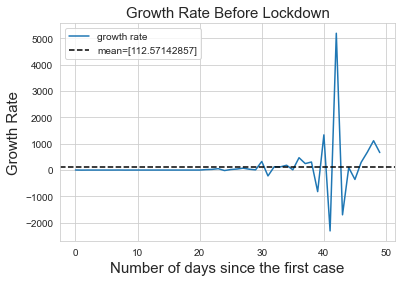

In [201]:
# A graph to see the growth rate 7 days before lockdown.

mean = Italy_last7days_beforelockdown['mean'].to_numpy()
plt.plot(italy_dates_before_lockdown, italy_cases_before_lockdown)
plt.title('Growth Rate Before Lockdown', fontsize = 15)
plt.xlabel('Number of days since the first case', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

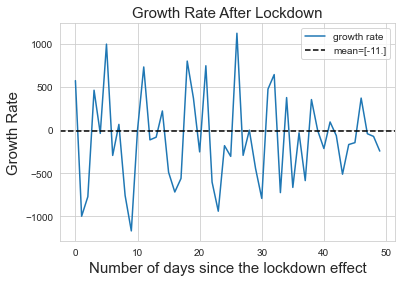

In [202]:
mean = Italy_last7days_afterlockdown['mean'].to_numpy()
plt.plot(italy_dates_after_lockdown, italy_cases_after_lockdown)
plt.title('Growth Rate After Lockdown', fontsize = 15)
plt.xlabel('Number of days since the lockdown effect', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

In [203]:
Italy_cases = []

dates = Italy2.keys()

for i in dates:
    confirmed_sum_Italy3 = Italy2[i].sum()
    Italy_cases.append(confirmed_sum_Italy3)

In [204]:
d = {'Italy Cases': Italy_cases}
df = pd.DataFrame(data=d)
df.index += 1 # index will serve as number of days since the first case
df

,Italy Cases
1,2
2,0
3,0
4,0
5,0
...,...
96,1075
97,1444
98,1401
99,1327


Text(0, 0.5, 'Growth Rate')

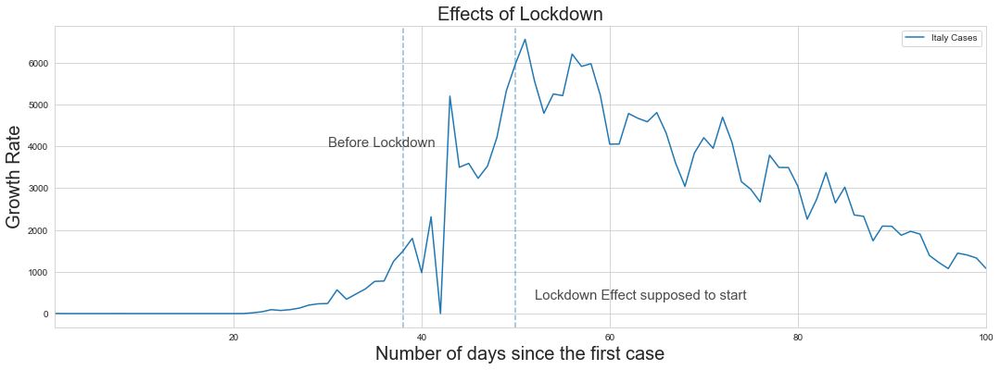

In [205]:
#Plotting a time series graph to see the effect of Lockdown in Italy.

ax = df.plot(figsize = (18,6))
x_line_annotation = 50
x_text_annotation = 52
x_line = 38
x_text = 30

ax.axvline(x=x_line, linestyle='dashed', alpha=0.5)
ax.text(x=x_text, y=4000, s='Before Lockdown ', alpha=0.7, color='Black', fontsize =15)

ax.axvline(x=x_line_annotation, linestyle='dashed', alpha=0.5)
ax.text(x=x_text_annotation, y=350, s='Lockdown Effect supposed to start ', alpha=0.7, color='Black', fontsize =15)

plt.title("Effects of Lockdown", fontsize =20)
plt.xlabel("Number of days since the first case", fontsize =20)
plt.ylabel("Growth Rate", fontsize = 20)

We can see The growth rate kept rising until 2 weeks after lockdown after which it started falling as expected. The same graph has been shown for a few countries underneath using the same procedure.

In [206]:
Belgium = confirmed_df.loc[confirmed_df['Country/Region'] == 'Belgium'] #Dataset for Belgium
Belgium.drop(Belgium.iloc[:, 0:4], inplace = True, axis = 1)
Belgium = Belgium.T[Belgium.any()].T
Belgium

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
23,1,1,1,1,1,1,1,1,1,1,...,48519,49032,49517,49906,50267,50509,50781,51420,52011,52596


In [207]:
Belgium2 = Belgium.copy()

In [208]:
column_list = []
length = len(Belgium2.columns)
for i in range(length):
    if(i>0):
        Belgium2.iloc[0,i] = Belgium2.iloc[0,i] - Belgium.iloc[0,i-1]
        
Belgium_after_lockdown = Belgium2.copy()

for i in range(length):
    if(i>0):
        Belgium_after_lockdown.iloc[0,i] = Belgium_after_lockdown.iloc[0,i] - Belgium2.iloc[0,i-1]

In [209]:
Belgium_before_lockdown = Belgium_after_lockdown.copy()
Belgium_before_lockdown.drop(Belgium_before_lockdown.iloc[:, 55:len(Belgium_after_lockdown.columns)], inplace = True, axis = 1)
Belgium_before_lockdown

,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,...,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20
23,1,-1,0,0,0,0,0,0,0,0,...,153,96,28,-244,184,142,630,-249,801,-148


In [210]:
Belgium_after_lockdown.drop(Belgium_after_lockdown.iloc[:, 0:55], inplace = True, axis = 1)
Belgium_after_lockdown

,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,4/5/20,4/6/20,4/7/20,4/8/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
23,-639,-187,313,195,38,239,-401,-137,257,-171,...,135,-147,-28,-96,-28,-119,30,367,-48,-6


In [211]:
#Calculating the mean growth rate

Belgium_last7days_beforelockdown =Belgium_before_lockdown.copy()
Belgium_last7days_beforelockdown.drop(Belgium_last7days_beforelockdown.iloc[:, 0:len(Belgium_last7days_beforelockdown.columns)-7], inplace = True, axis = 1)
Belgium_last7days_beforelockdown_mean = Belgium_last7days_beforelockdown.mean()
Belgium_last7days_beforelockdown['mean'] = Belgium_last7days_beforelockdown.mean(axis=1)

Belgium_last7days_afterlockdown =Belgium_after_lockdown.copy()
Belgium_last7days_afterlockdown.drop(Belgium_last7days_afterlockdown.iloc[:, 7:len(Belgium_last7days_afterlockdown.columns)], inplace = True, axis = 1)
Belgium_last7days_afterlockdown_mean = Belgium_last7days_afterlockdown.mean()
Belgium_last7days_afterlockdown['mean'] = Belgium_last7days_afterlockdown.mean(axis=1)

In [212]:
date = Belgium_after_lockdown.keys()
Belgium_dates_after_lockdown = np.array([i for i in range(len(date))]).reshape(-1, 1)

date2 = Belgium_before_lockdown.keys()
Belgium_dates_before_lockdown = np.array([i for i in range(len(date2))]).reshape(-1, 1)

In [213]:
Belgium_cases_after_lockdown = []
Belgium_cases_before_lockdown = []

for i in date:
    confirmed_sum_Belgium = Belgium_after_lockdown[i].sum()
    Belgium_cases_after_lockdown.append(confirmed_sum_Belgium)

for i in date2:
    confirmed_sum_Belgium2 = Belgium_before_lockdown[i].sum()
    Belgium_cases_before_lockdown.append(confirmed_sum_Belgium2)

In [214]:
Belgium_last7days_afterlockdown

,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,4/5/20,mean
23,-639,-187,313,195,38,239,-401,-63.142857


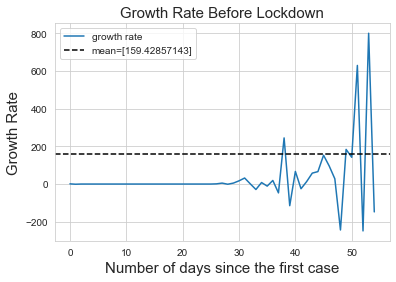

In [215]:
mean = Belgium_last7days_beforelockdown['mean'].to_numpy()
plt.plot(Belgium_dates_before_lockdown, Belgium_cases_before_lockdown)
plt.title('Growth Rate Before Lockdown', fontsize = 15)
plt.xlabel('Number of days since the first case', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

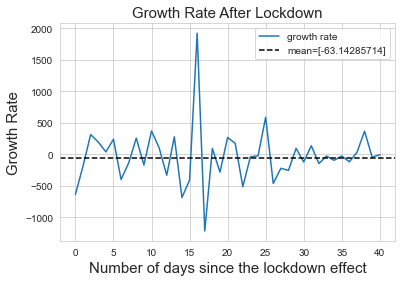

In [216]:
mean = Belgium_last7days_afterlockdown['mean'].to_numpy()
plt.plot(Belgium_dates_after_lockdown, Belgium_cases_after_lockdown)
plt.title('Growth Rate After Lockdown', fontsize = 15)
plt.xlabel('Number of days since the lockdown effect', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

In [217]:
Belgium_cases = []

dates = Belgium2.keys()

for i in dates:
    confirmed_sum_Belgium3 = Belgium2[i].sum()
    Belgium_cases.append(confirmed_sum_Belgium3)

In [218]:
d = {'Belgium Cases':Belgium_cases}
df = pd.DataFrame(data=d)
df.index += 1
df

,Belgium Cases
1,1
2,0
3,0
4,0
5,0
...,...
92,242
93,272
94,639
95,591


Text(0, 0.5, 'Growth Rate')

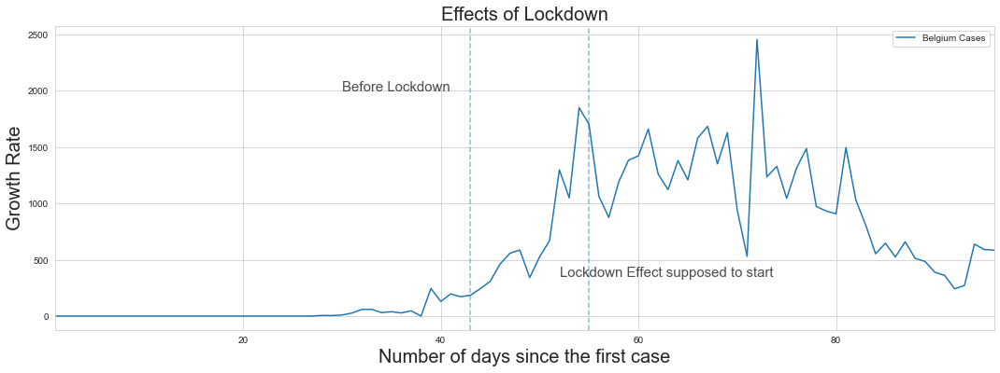

In [219]:
#Plotting a graph for Belgium's Lockdown

ax = df.plot(figsize = (18,6))
x_line_annotation = 55
x_text_annotation = 52
x_line = 43
x_text = 30

ax.axvline(x=x_line, linestyle='dashed', alpha=0.5)
ax.text(x=x_text, y=2000, s='Before Lockdown ', alpha=0.7, color='Black', fontsize =15)

ax.axvline(x=x_line_annotation, linestyle='dashed', alpha=0.5)
ax.text(x=x_text_annotation, y=350, s='Lockdown Effect supposed to start ', alpha=0.7, color='Black', fontsize =15)

plt.title("Effects of Lockdown", fontsize =20)
plt.xlabel("Number of days since the first case", fontsize =20)
plt.ylabel('Growth Rate', fontsize = 20)

In [220]:
Spain = confirmed_df.loc[confirmed_df['Country/Region'] == 'Spain'] #Dataset for Spain 
Spain.drop(Spain.iloc[:, 0:4], inplace = True, axis = 1)
Spain = Spain.T[Spain.any()].T
Spain

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
201,1,1,1,1,1,1,1,1,2,2,...,213435,213435,216582,217466,218011,219329,220325,221447,222857,223578


In [221]:
Spain2 = Spain.copy()
column_list = []
length = len(Spain2.columns)
for i in range(length):
    if(i>0):
        Spain2.iloc[0,i] = Spain2.iloc[0,i] - Spain.iloc[0,i-1]
        
Spain_after_lockdown = Spain2.copy()

for i in range(length):
    if(i>0):
        Spain_after_lockdown.iloc[0,i] = Spain_after_lockdown.iloc[0,i] - Spain2.iloc[0,i-1]

In [222]:
Spain_before_lockdown = Spain_after_lockdown.copy()
Spain_before_lockdown.drop(Spain_before_lockdown.iloc[:, 55:len(Spain_before_lockdown.columns)], inplace = True, axis = 1)
Spain_before_lockdown

,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,...,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20
201,1,-1,0,0,0,0,0,0,1,-1,...,-338,356,1891,-1606,2517,-1570,2974,-1619,4881,-1359


In [223]:
Spain_after_lockdown.drop(Spain_after_lockdown.iloc[:, 0:55], inplace = True, axis = 1)
Spain_after_lockdown

,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,4/5/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
201,-338,-417,-641,971,121,228,-248,-813,-165,-1491,...,-1626,-518,3147,-2263,-339,773,-322,126,288,-689


In [224]:
#Calculating the mean growth rate
Spain_last7days_beforelockdown = Spain_before_lockdown.copy()
Spain_last7days_beforelockdown.drop(Spain_last7days_beforelockdown.iloc[:, 0:len(Spain_last7days_beforelockdown.columns)-7], inplace = True, axis = 1)
Spain_last7days_beforelockdown_mean = Spain_last7days_beforelockdown.mean()
Spain_last7days_beforelockdown['mean'] = Spain_last7days_beforelockdown.mean(axis=1)
Spain_last7days_beforelockdown

,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,mean
201,-1606,2517,-1570,2974,-1619,4881,-1359,602.571429


In [225]:
Spain_last7days_afterlockdown = Spain_after_lockdown.copy()
Spain_last7days_afterlockdown.drop(Spain_last7days_afterlockdown.iloc[:, 7:len(Spain_last7days_afterlockdown.columns)], inplace = True, axis = 1)
Spain_last7days_afterlockdown_mean = Spain_last7days_afterlockdown.mean()
Spain_last7days_afterlockdown['mean'] = Spain_last7days_afterlockdown.mean(axis=1)
Spain_last7days_afterlockdown

,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,mean
201,-338,-417,-641,971,121,228,-248,-46.285714


In [226]:
date = Spain_after_lockdown.keys()
Spain_dates_after_lockdown = np.array([i for i in range(len(date))]).reshape(-1, 1)

date2 = Spain_before_lockdown.keys()
Spain_dates_before_lockdown = np.array([i for i in range(len(date2))]).reshape(-1, 1)

In [227]:
Spain_cases_after_lockdown = []
Spain_cases_before_lockdown = []

for i in date:
    confirmed_sum_Spain = Spain_after_lockdown[i].sum()
    Spain_cases_after_lockdown.append(confirmed_sum_Spain)
    
for i in date2:
    confirmed_sum_Spain2 = Spain_before_lockdown[i].sum()
    Spain_cases_before_lockdown.append(confirmed_sum_Spain2)

In [228]:
Spain_cases = []

dates = Spain2.keys()

for i in dates:
    confirmed_sum_Spain = Spain2[i].sum()
    Spain_cases.append(confirmed_sum_Spain)

In [229]:
Spain_dates = np.array([i for i in range(len(dates))]).reshape(-1, 1)

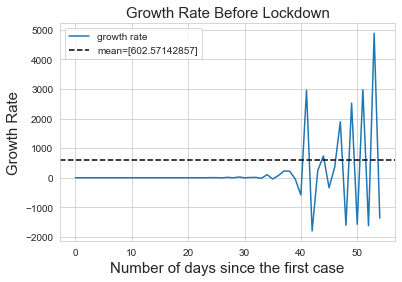

In [230]:
mean = Spain_last7days_beforelockdown['mean'].to_numpy() 
plt.plot(Spain_dates_before_lockdown, Spain_cases_before_lockdown)
plt.title('Growth Rate Before Lockdown', fontsize = 15)
plt.xlabel('Number of days since the first case', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

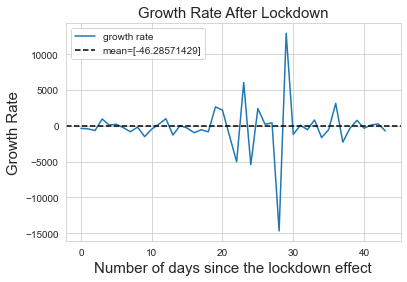

In [231]:
mean = Spain_last7days_afterlockdown['mean'].to_numpy()
plt.plot(Spain_dates_after_lockdown, Spain_cases_after_lockdown)
plt.title('Growth Rate After Lockdown', fontsize = 15)
plt.xlabel('Number of days since the lockdown effect', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

In [232]:
d = {'Spain Cases': Spain_cases}
df = pd.DataFrame(data=d)
df.index += 1
df.tail(50)

,Spain Cases
50,4964
51,3394
52,6368
53,4749
54,9630
55,8271
56,7933
57,7516
58,6875
59,7846


Text(0, 0.5, 'Growth Rate')

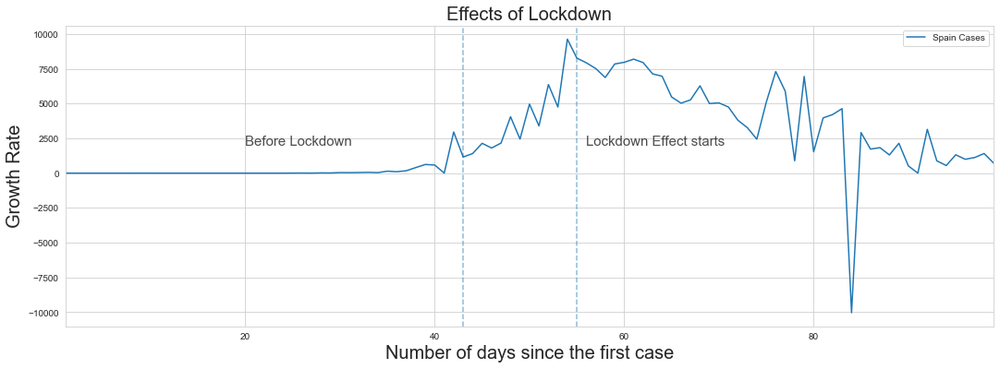

In [233]:
ax = df.plot(figsize = (18,6))
x_line_annotation = 55
x_text_annotation = 56
x_line = 43
x_text = 20

ax.axvline(x=x_line, linestyle='dashed', alpha=0.5)
ax.text(x=x_text, y=2000, s='Before Lockdown ', alpha=0.7, color='Black', fontsize =15)

ax.axvline(x=x_line_annotation, linestyle='dashed', alpha=0.5)
ax.text(x=x_text_annotation, y=2000, s='Lockdown Effect starts ', alpha=0.7, color='Black', fontsize =15)

plt.title("Effects of Lockdown", fontsize =20)
plt.xlabel("Number of days since the first case", fontsize =20)
plt.ylabel("Growth Rate", fontsize = 20)

In [234]:
Austria = confirmed_df.loc[confirmed_df['Country/Region'] == 'Austria'] #Dataset for Austria
Austria.drop(Austria.iloc[:, 0:4], inplace = True, axis = 1)
Austria =Austria.T[Austria.any()].T
Austria

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
16,2,2,3,3,9,14,18,21,29,41,...,15452,15531,15558,15597,15621,15650,15684,15752,15774,15833


In [235]:
Austria2 = Austria.copy()  
column_list = []
length = len(Austria2.columns)
for i in range(length):
    if(i>0):
        Austria2.iloc[0,i] = Austria2.iloc[0,i] - Austria.iloc[0,i-1]
        
Austria3 = Austria2.copy()

for i in range(length):
    if(i>0):
        Austria3.iloc[0,i] = Austria3.iloc[0,i] - Austria2.iloc[0,i-1] #Calculates the increase or decrease in cases compared to its previous day 

In [236]:
Austria4 = Austria3.copy()
Austria4.drop(Austria4.iloc[:, 33:len(Austria4.columns)], inplace = True, axis = 1)
Austria4

,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,...,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20
16,2,-2,1,-1,6,-1,-1,-1,5,4,...,53,8,51,342,124,-83,-504,1016,-573,-134


In [237]:
Austria3.drop(Austria3.iloc[:, 0:33], inplace = True, axis = 1)
Austria3

,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,4/5/20,4/6/20,4/7/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
16,-97,313,-268,-31,-113,-23,-138,13,-24,96,...,5,29,-52,12,-15,5,5,34,-46,37


In [238]:
Austria_last7days_beforelockdown =Austria4.copy()
Austria_last7days_beforelockdown.drop(Austria_last7days_beforelockdown.iloc[:, 0:len(Austria_last7days_beforelockdown.columns)-7], inplace = True, axis = 1)
Austria_last7days_beforelockdown_mean = Austria_last7days_beforelockdown.mean()
Austria_last7days_beforelockdown['mean'] = Austria_last7days_beforelockdown.mean(axis=1)
Austria_last7days_beforelockdown

,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,mean
16,342,124,-83,-504,1016,-573,-134,26.857143


In [239]:
Austria_last7days_afterlockdown =Austria3.copy()
Austria_last7days_afterlockdown.drop(Austria_last7days_afterlockdown.iloc[:, 7:len(Austria_last7days_afterlockdown.columns)], inplace = True, axis = 1)
Austria_last7days_afterlockdown_mean = Austria_last7days_afterlockdown.mean()
Austria_last7days_afterlockdown['mean'] = Austria_last7days_afterlockdown.mean(axis=1)
Austria_last7days_afterlockdown

,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,mean
16,-97,313,-268,-31,-113,-23,-138,-51.0


In [240]:
date = Austria3.keys()
Austria_dates1 = np.array([i for i in range(len(date))]).reshape(-1, 1)

date2 = Austria4.keys()
Austria_dates2 = np.array([i for i in range(len(date2))]).reshape(-1, 1)

In [241]:
Austria_cases_after_lockdown = []
Austria_cases_before_lockdown = []

for i in date:
    confirmed_sum_Austria = Austria3[i].sum()
    Austria_cases_after_lockdown.append(confirmed_sum_Austria)
    
for i in date2:
    confirmed_sum_Austria2 = Austria4[i].sum()
    Austria_cases_before_lockdown.append(confirmed_sum_Austria2)

In [242]:
Austria_cases = []

dates = Austria2.keys()

for i in dates:
    confirmed_sum_Austria3 = Austria2[i].sum()
    Austria_cases.append(confirmed_sum_Austria3)

In [243]:
Austria_dates = np.array([i for i in range(len(dates))]).reshape(-1, 1)

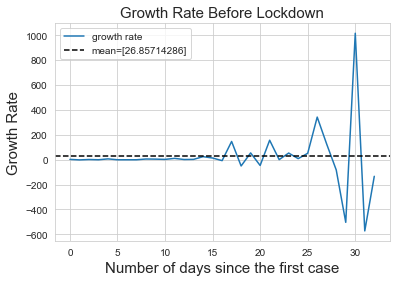

In [244]:
mean = Austria_last7days_beforelockdown['mean'].to_numpy()
plt.plot(Austria_dates2, Austria_cases_before_lockdown)
plt.title('Growth Rate Before Lockdown', fontsize = 15)
plt.xlabel('Number of days since the first case', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

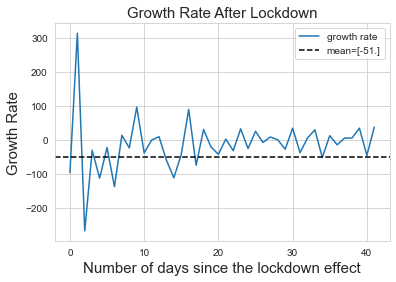

In [245]:
mean = Austria_last7days_afterlockdown['mean'].to_numpy()
plt.plot(Austria_dates1, Austria_cases_after_lockdown)
plt.title('Growth Rate After Lockdown', fontsize = 15)
plt.xlabel('Number of days since the lockdown effect', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

In [246]:
d = {'Austria Cases': Austria_cases}
df = pd.DataFrame(data=d)
df.index += 1
df

,Austria Cases
1,2
2,0
3,1
4,0
5,6
...,...
71,29
72,34
73,68
74,22


Text(0, 0.5, 'Number of new cases in one day')

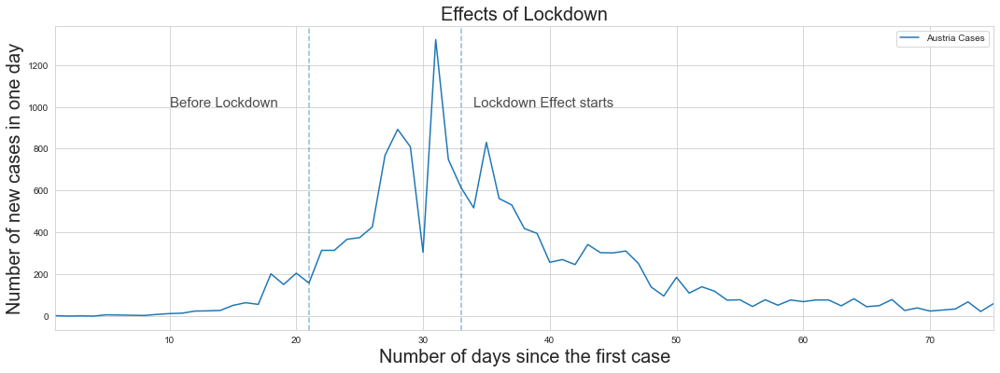

In [247]:
import plotly.express as px
import plotly.graph_objects as go
ax = df.plot(figsize = (18,6))
x_line_annotation = 33
x_text_annotation = 34
x_line = 21
x_text = 10

ax.axvline(x=x_line, linestyle='dashed', alpha=0.5)
ax.text(x=x_text, y=1000, s='Before Lockdown ', alpha=0.7, color='Black', fontsize =15)

ax.axvline(x=x_line_annotation, linestyle='dashed', alpha=0.5)
ax.text(x=x_text_annotation, y=1000, s='Lockdown Effect starts ', alpha=0.7, color='Black', fontsize =15)


plt.title("Effects of Lockdown", fontsize =20)
plt.xlabel("Number of days since the first case", fontsize =20)
plt.ylabel("Number of new cases in one day", fontsize =20)

In [248]:
Ireland = confirmed_df.loc[confirmed_df['Country/Region'] == 'Ireland'] #Dataset for Ireland
Ireland.drop(Ireland.iloc[:, 0:4], inplace = True, axis = 1)
Ireland =Ireland.T[Ireland.any()].T
Ireland

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
135,1,1,1,2,6,6,18,18,19,21,...,20612,20833,21176,21506,21772,21983,22248,22385,22541,22760


In [249]:
Ireland2 = Ireland.copy()
column_list = []
length = len(Ireland2.columns)
for i in range(length):
    if(i>0):
        Ireland2.iloc[0,i] = Ireland2.iloc[0,i] - Ireland.iloc[0,i-1]
        
Ireland3 = Ireland2.copy()

for i in range(length):
    if(i>0):
        Ireland3.iloc[0,i] = Ireland3.iloc[0,i] - Ireland2.iloc[0,i-1]

In [250]:
Ireland4 = Ireland3.copy()
Ireland4.drop(Ireland4.iloc[:, 26:len(Ireland4.columns)], inplace = True, axis = 1)
Ireland4

,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,...,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20
135,1,-1,0,1,3,-4,12,-12,1,1,...,40,14,15,196,-139,-24,19,98,-15,31


In [251]:
Ireland3.drop(Ireland3.iloc[:, 0:26], inplace = True, axis = 1)
Ireland3

,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
135,20,47,-8,-94,95,30,-113,190,22,-93,...,-17,-138,122,-13,-64,-55,54,-128,19,63


In [252]:
#Calculating the growth rate
Ireland_last7days_beforelockdown =Ireland4.copy()
Ireland_last7days_beforelockdown.drop(Ireland_last7days_beforelockdown.iloc[:, 0:len(Ireland_last7days_beforelockdown.columns)-7], inplace = True, axis = 1)
Ireland_last7days_beforelockdown_mean = Ireland_last7days_beforelockdown.mean()
Ireland_last7days_beforelockdown['mean'] = Ireland_last7days_beforelockdown.mean(axis=1)

Ireland_last7days_afterlockdown =Ireland3.copy()
Ireland_last7days_afterlockdown.drop(Ireland_last7days_afterlockdown.iloc[:, 7:len(Ireland_last7days_afterlockdown.columns)], inplace = True, axis = 1)
Ireland_last7days_afterlockdown_mean = Ireland_last7days_afterlockdown.mean()
Ireland_last7days_afterlockdown['mean'] = Ireland_last7days_afterlockdown.mean(axis=1)

In [253]:
date = Ireland3.keys()
Ireland_dates = np.array([i for i in range(len(date))]).reshape(-1, 1)

date2 = Ireland4.keys()
Ireland_dates2 = np.array([i for i in range(len(date2))]).reshape(-1, 1)

In [254]:
Ireland_cases_after_lockdown = []
Ireland_cases_before_lockdown = []

for i in date:
    confirmed_sum_Ireland = Ireland3[i].sum()
    Ireland_cases_after_lockdown.append(confirmed_sum_Ireland)
    
for i in date2:
    confirmed_sum_Ireland2 = Ireland4[i].sum()
    Ireland_cases_before_lockdown.append(confirmed_sum_Ireland2)

In [255]:
Ireland_cases = []

dates = Ireland2.keys()

for i in dates:
    confirmed_sum_Ireland3 = Ireland2[i].sum()
    Ireland_cases.append(confirmed_sum_Ireland3)

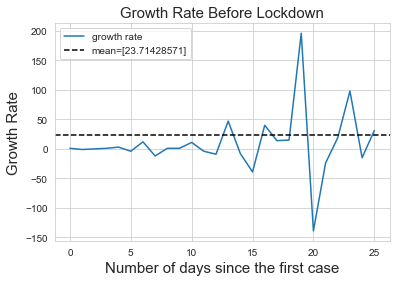

In [256]:
mean = Ireland_last7days_beforelockdown['mean'].to_numpy()
plt.plot(Ireland_dates2, Ireland_cases_before_lockdown)
plt.title('Growth Rate Before Lockdown', fontsize = 15)
plt.xlabel('Number of days since the first case', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

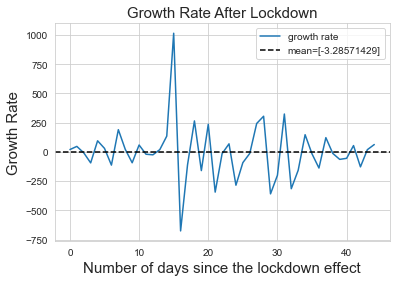

In [257]:
mean = Ireland_last7days_afterlockdown['mean'].to_numpy()
plt.plot(Ireland_dates, Ireland_cases_after_lockdown)
plt.title('Growth Rate After Lockdown', fontsize = 15)
plt.xlabel('Number of days since the lockdown effect', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

In [258]:
d = {'Ireland Cases': Ireland_cases}
df = pd.DataFrame(data=d)
df.index += 1
df

,Ireland Cases
1,1
2,0
3,0
4,1
5,4
...,...
67,211
68,265
69,137
70,156


Text(0, 0.5, 'Growth Rate')

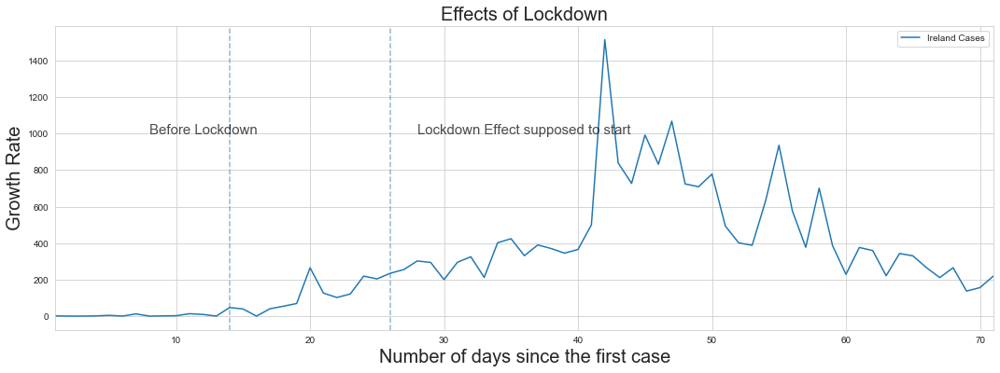

In [259]:
ax = df.plot(figsize = (18,6))
x_line_annotation = 26
x_text_annotation = 28
x_line = 14
x_text = 8

ax.axvline(x=x_line, linestyle='dashed', alpha=0.5)
ax.text(x=x_text, y=1000, s='Before Lockdown ', alpha=0.7, color='Black', fontsize=15)

ax.axvline(x=x_line_annotation, linestyle='dashed', alpha=0.5)
ax.text(x=x_text_annotation, y=1000, s='Lockdown Effect supposed to start ', alpha=0.7, color='Black', fontsize=15)

plt.title("Effects of Lockdown", fontsize =20)
plt.xlabel("Number of days since the first case", fontsize=20)
plt.ylabel("Growth Rate", fontsize=20)

In [260]:
Uk = confirmed_df.loc[confirmed_df['Country/Region'] == 'United Kingdom'] #Dataset for UK
Uk.drop(Uk.iloc[:, 0:4], inplace = True, axis = 1)
Uk

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
217,0,0,0,0,0,0,0,0,0,0,...,114,114,114,115,115,115,118,118,118,118
218,0,0,0,0,0,0,0,0,0,0,...,73,74,74,74,75,78,78,80,81,81
219,0,0,0,0,0,0,0,0,0,0,...,537,538,543,544,544,545,545,545,545,545
220,0,0,0,0,0,0,0,0,0,0,...,144,144,144,144,144,144,144,144,146,146
221,0,0,0,0,0,0,0,0,0,0,...,315,316,320,321,325,326,327,329,329,329
222,0,0,0,0,0,0,0,0,0,0,...,11,11,11,11,11,11,11,11,11,11
223,0,0,0,0,0,0,0,0,0,2,...,171253,177454,182260,186599,190584,194990,201101,206715,211364,215260
249,0,0,0,0,0,0,0,0,0,0,...,3,3,3,3,3,3,3,3,3,3
250,0,0,0,0,0,0,0,0,0,0,...,6,6,6,6,6,6,7,7,7,7
251,0,0,0,0,0,0,0,0,0,0,...,12,12,12,12,12,12,12,12,12,12


In [261]:
Uk.loc['Total']= Uk.sum()
Uk = Uk.iloc[len(Uk)-1:]
Uk =Uk.T[Uk.any()].T
Uk

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
Total,2,2,2,2,2,2,2,3,3,3,...,172481,178685,183500,187842,191832,196243,202359,207977,212629,216525


In [262]:
Uk2 = Uk.copy()
column_list = []
length = len(Uk2.columns)
for i in range(length):
    if(i>0):
        Uk2.iloc[0,i] = Uk2.iloc[0,i] - Uk.iloc[0,i-1]
        
UK3 = Uk2.copy()

for i in range(length):
    if(i>0):
        UK3.iloc[0,i] = UK3.iloc[0,i] - Uk2.iloc[0,i-1]

In [263]:
UK4 = UK3.copy()
UK4.drop(UK4.iloc[:, 65:len(UK4.columns)], inplace = True, axis = 1)
UK4

,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,...,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20
Total,2,-2,0,0,0,0,0,1,-1,0,...,696,761,-366,-99,205,355,1356,-76,208,-728


In [264]:
UK3.drop(UK3.iloc[:, 0:65], inplace = True, axis = 1)
UK3

,4/5/20,4/6/20,4/7/20,4/8/20,4/9/20,4/10/20,4/11/20,4/12/20,4/13/20,4/14/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
Total,2171,-2116,-173,1855,-1127,4335,-3464,63,-968,911,...,1949,164,-1389,-473,-352,421,1705,-498,-966,-756


In [265]:
#Calculating the mean growth rate
UK_last7days_beforelockdown =UK4.copy()
UK_last7days_beforelockdown.drop(UK_last7days_beforelockdown.iloc[:, 0:len(UK_last7days_beforelockdown.columns)-7], inplace = True, axis = 1)
UK_last7days_beforelockdown_mean = UK_last7days_beforelockdown.mean()
UK_last7days_beforelockdown['mean'] = UK_last7days_beforelockdown.mean(axis=1)

UK_last7days_afterlockdown =UK3.copy()
UK_last7days_afterlockdown.drop(UK_last7days_afterlockdown.iloc[:, 7:len(UK_last7days_afterlockdown.columns)], inplace = True, axis = 1)
UK_last7days_afterlockdown_mean = UK_last7days_afterlockdown.mean()
UK_last7days_afterlockdown['mean'] = UK_last7days_afterlockdown.mean(axis=1)

In [266]:
date = UK3.keys()
Uk_dates = np.array([i for i in range(len(date))]).reshape(-1, 1)

date2 = UK4.keys()
Uk_dates2 = np.array([i for i in range(len(date2))]).reshape(-1, 1)

In [267]:
UK_cases_after_lockdown = []
UK_cases_before_lockdown = []

for i in date:
    confirmed_sum_UK = UK3[i].sum()
    UK_cases_after_lockdown.append(confirmed_sum_UK)
    
for i in date2:
    confirmed_sum_UK2 = UK4[i].sum()
    UK_cases_before_lockdown.append(confirmed_sum_UK2)

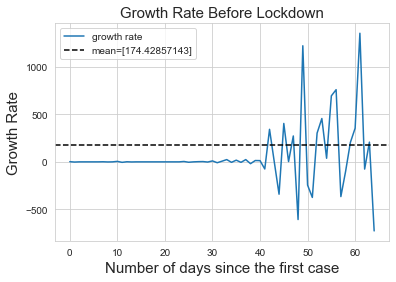

In [268]:
mean = UK_last7days_beforelockdown['mean'].to_numpy()
plt.plot(Uk_dates2,UK_cases_before_lockdown)
plt.title('Growth Rate Before Lockdown', fontsize = 15)
plt.xlabel('Number of days since the first case', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

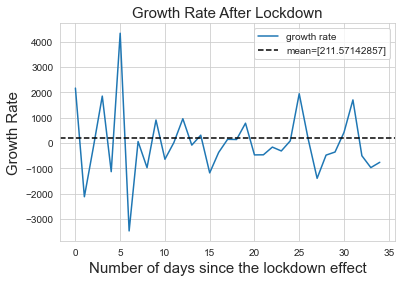

In [269]:
mean = UK_last7days_afterlockdown['mean'].to_numpy()
plt.plot(Uk_dates,UK_cases_after_lockdown)
plt.title('Growth Rate After Lockdown', fontsize = 15)
plt.xlabel('Number of days since the lockdown effect', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

In [270]:
UK_cases = []
dates = Uk2.keys()

for i in dates:
    confirmed_sum_UK3 = Uk2[i].sum()
    UK_cases.append(confirmed_sum_UK3)

In [271]:
d = {'UK Cases': UK_cases}
df = pd.DataFrame(data=d)
df.index += 1 
df

,UK Cases
1,2
2,0
3,0
4,0
5,0
...,...
96,4411
97,6116
98,5618
99,4652


Text(0, 0.5, 'Number of new cases everyday')

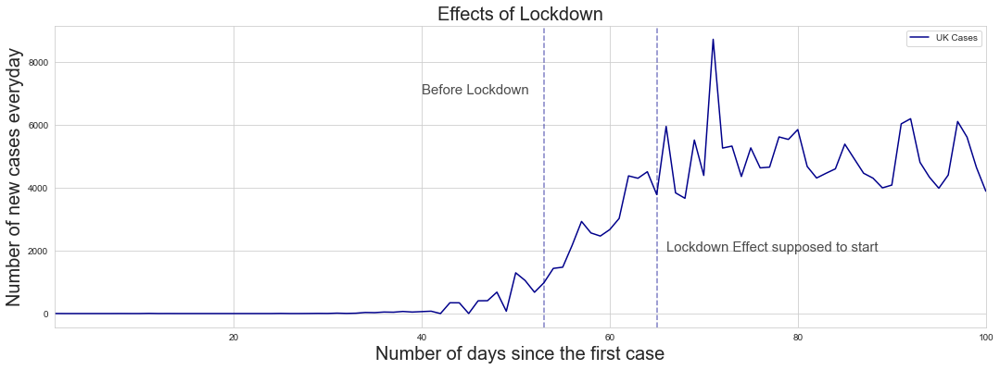

In [272]:
ax = df.plot(figsize = (18,6), color = 'DarkBlue')
x_line_annotation = 65
x_text_annotation = 66
x_line = 53
x_text = 40

ax.axvline(x=x_line, linestyle='dashed', alpha=0.5,color = 'DarkBlue')
ax.text(x=x_text, y=7000, s='Before Lockdown ', alpha=0.7, color='Black', fontsize = 15)

ax.axvline(x=x_line_annotation, linestyle='dashed', alpha=0.5, color = 'DarkBlue')
ax.text(x=x_text_annotation, y=2000, s='Lockdown Effect supposed to start ', alpha=0.7, color='Black', fontsize = 15)

plt.title("Effects of Lockdown",fontsize = 20)
plt.xlabel("Number of days since the first case", fontsize = 20)
plt.ylabel("Number of new cases everyday", fontsize = 20)

The lockdown effect did not start when expected which can attributed to low testing levels in UK. This will be discussed further later in this project.

In [273]:
Germany = confirmed_df.loc[confirmed_df['Country/Region'] == 'Germany'] #Dataset for Germany 
Germany.drop(Germany.iloc[:, 0:4], inplace = True, axis = 1)
Germany =Germany.T[Germany.any()].T
Germany

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
120,1,4,4,4,5,8,10,12,12,12,...,163009,164077,164967,165664,166152,167007,168162,169430,170588,171324


In [274]:
Germany2 = Germany.copy()
column_list = []
length = len(Germany2.columns)
for i in range(length):
    if(i>0):
        Germany2.iloc[0,i] = Germany2.iloc[0,i] - Germany.iloc[0,i-1]
        
Germany3 = Germany2.copy()

for i in range(length):
    if(i>0):
        Germany3.iloc[0,i] = Germany3.iloc[0,i] - Germany2.iloc[0,i-1]

In [275]:
Germany4 = Germany3.copy()

Germany4.drop(Germany4.iloc[:, 61:len(Germany4.columns)], inplace = True, axis = 1)
#Germany4.drop(Germany4.iloc[:, 15:32], inplace = True, axis = 1)

Germany4

,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,...,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20
120,1,2,-3,0,1,2,-1,0,-2,0,...,1085,-77,1535,-2163,295,1523,-253,407,2278,318


In [276]:
Germany3.drop(Germany3.iloc[:, 0:61], inplace = True, axis = 1)
date = Germany3.keys()
date2 = Germany4.keys()
Germany_dates = np.array([i for i in range(len(date))]).reshape(-1, 1)
Germany_dates2 = np.array([i for i in range(len(date2))]).reshape(-1, 1)

Germany_cases_after_lockdown = []
Germany_cases_before_lockdown = []

for i in date:
    confirmed_sum_Germany = Germany3[i].sum()
    Germany_cases_after_lockdown.append(confirmed_sum_Germany)
    
for i in date2:
    confirmed_sum_Germany2 = Germany4[i].sum()
    Germany_cases_before_lockdown.append(confirmed_sum_Germany2)

In [277]:
#Calculating the mean growth rate
Germany_last7days_beforelockdown =Germany4.copy()
Germany_last7days_beforelockdown.drop(Germany_last7days_beforelockdown.iloc[:, 0:len(Germany_last7days_beforelockdown.columns)-7], inplace = True, axis = 1)
Germany_last7days_beforelockdown_mean = Germany_last7days_beforelockdown.mean()
Germany_last7days_beforelockdown['mean'] = Germany_last7days_beforelockdown.mean(axis=1)

Germany_last7days_afterlockdown =Germany3.copy()
Germany_last7days_afterlockdown.drop(Germany_last7days_afterlockdown.iloc[:, 7:len(Germany_last7days_afterlockdown.columns)], inplace = True, axis = 1)
Germany_last7days_afterlockdown_mean = Germany_last7days_afterlockdown.mean()
Germany_last7days_afterlockdown['mean'] = Germany_last7days_afterlockdown.mean(axis=1)

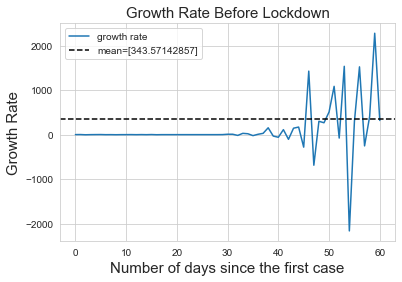

In [278]:
mean = Germany_last7days_beforelockdown['mean'].to_numpy()
plt.plot(Germany_dates2,Germany_cases_before_lockdown)
plt.title('Growth Rate Before Lockdown', fontsize = 15)
plt.xlabel('Number of days since the first case', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

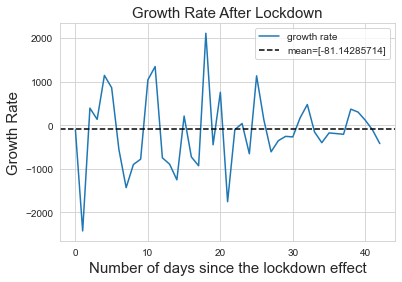

In [279]:
mean =Germany_last7days_afterlockdown['mean'].to_numpy()
plt.plot(Germany_dates,Germany_cases_after_lockdown)
plt.title('Growth Rate After Lockdown', fontsize = 15)
plt.xlabel('Number of days since the lockdown effect', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

In [280]:
Germany_cases = []

dates = Germany2.keys()

for i in dates:
    confirmed_sum_Germany3 = Germany2[i].sum()
    Germany_cases.append(confirmed_sum_Germany3)

In [281]:
d = {'Germany Cases': Germany_cases}
df = pd.DataFrame(data=d)
df.index += 1
df

,Germany Cases
1,1
2,3
3,0
4,0
5,1
...,...
100,855
101,1155
102,1268
103,1158


Text(0, 0.5, 'Growth Rate')

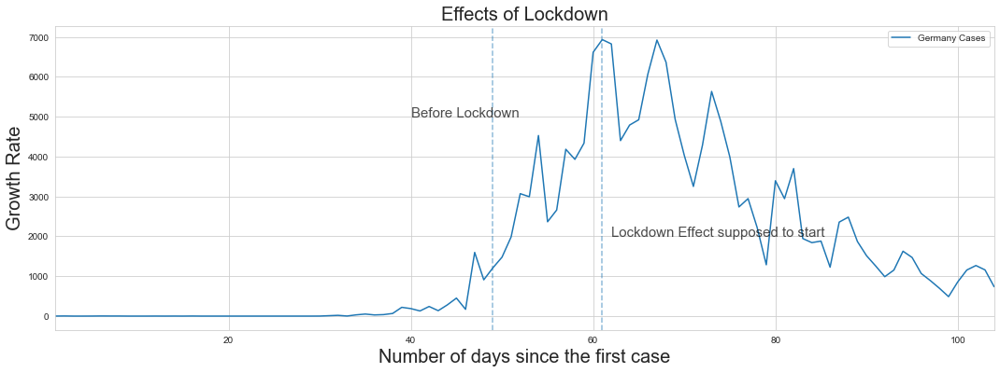

In [282]:
ax = df.plot(figsize = (18,6))
x_line_annotation = 61
x_text_annotation = 62
x_line = 49
x_text = 40

ax.axvline(x=x_line, linestyle='dashed', alpha=0.5)
ax.text(x=x_text, y=5000, s='Before Lockdown ', alpha=0.7, color='Black', fontsize =15)

ax.axvline(x=x_line_annotation, linestyle='dashed', alpha=0.5)
ax.text(x=x_text_annotation, y=2000, s='Lockdown Effect supposed to start ', alpha=0.7, color='Black', fontsize =15)

plt.title("Effects of Lockdown", fontsize =20)
plt.xlabel("Number of days since the first case", fontsize =20)
plt.ylabel("Growth Rate", fontsize = 20)

In [283]:
Norway = confirmed_df.loc[confirmed_df['Country/Region'] == 'Norway'] #Dataset for Norway
Norway.drop(Norway.iloc[:, 0:4], inplace = True, axis = 1)
Norway =Norway.T[Norway.any()].T
Norway

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
175,1,1,6,15,19,25,32,56,87,108,...,7738,7783,7809,7847,7904,7955,7996,8034,8070,8099


In [284]:
Norway2 = Norway.copy()
column_list = []
length = len(Norway.columns)
for i in range(length):
    if(i>0):
        Norway2.iloc[0,i] = Norway2.iloc[0,i] - Norway.iloc[0,i-1]
        
Norway3 = Norway2.copy()

for i in range(length):
    if(i>0):
        Norway3.iloc[0,i] = Norway3.iloc[0,i] - Norway2.iloc[0,i-1] 

In [285]:
Norway4 = Norway3.copy()
Norway4.drop(Norway4.iloc[:, 29:len(Norway4.columns)], inplace = True, axis = 1)
Norway4

,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,...,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20
175,1,-1,5,4,-5,2,1,17,7,-10,...,-19,18,-43,109,-28,36,63,-31,6,-21


In [286]:
Norway3.drop(Norway3.iloc[:, 0:29], inplace = True, axis = 1)
date = Norway3.keys()
date2 = Norway4.keys()
Norway_dates = np.array([i for i in range(len(date))]).reshape(-1, 1)
Norway_dates2 = np.array([i for i in range(len(date2))]).reshape(-1, 1)

Norway_cases_after_lockdown = []
Norway_cases_before_lockdown = []

for i in date:
    confirmed_sum_Norway = Norway3[i].sum()
    Norway_cases_after_lockdown.append(confirmed_sum_Norway)
    
for i in date2:
    confirmed_sum_Norway2 = Norway4[i].sum()
    Norway_cases_before_lockdown.append(confirmed_sum_Norway2)
    
Norway3

,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
175,64,101,-126,9,-108,35,26,62,-61,-43,...,-22,17,-19,12,19,-6,-10,-3,-2,-7


In [287]:
#Calculating the mean growth rate
Norway_last7days_beforelockdown =Norway4.copy()
Norway_last7days_beforelockdown.drop(Norway_last7days_beforelockdown.iloc[:, 0:len(Norway_last7days_beforelockdown.columns)-7], inplace = True, axis = 1)
Norway_last7days_beforelockdown_mean = Norway_last7days_beforelockdown.mean()
Norway_last7days_beforelockdown['mean'] = Norway_last7days_beforelockdown.mean(axis=1)

Norway_last7days_afterlockdown =Norway3.copy()
Norway_last7days_afterlockdown.drop(Norway_last7days_afterlockdown.iloc[:, 7:len(Norway_last7days_afterlockdown.columns)], inplace = True, axis = 1)
Norway_last7days_afterlockdown_mean = Norway_last7days_afterlockdown.mean()
Norway_last7days_afterlockdown['mean'] = Norway_last7days_afterlockdown.mean(axis=1)

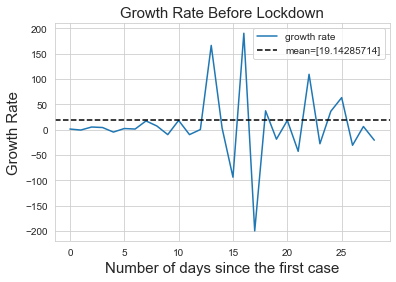

In [288]:
mean = Norway_last7days_beforelockdown['mean'].to_numpy()
plt.plot(Norway_dates2,Norway_cases_before_lockdown)
plt.title('Growth Rate Before Lockdown', fontsize = 15)
plt.xlabel('Number of days since the first case', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

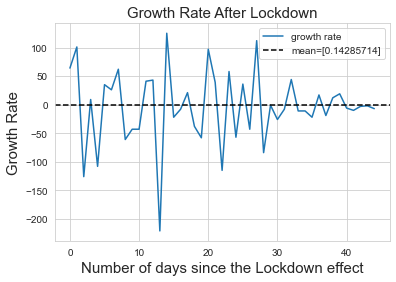

In [289]:
mean = Norway_last7days_afterlockdown['mean'].to_numpy()
plt.plot(Norway_dates,Norway_cases_after_lockdown)
plt.title('Growth Rate After Lockdown', fontsize = 15)
plt.xlabel('Number of days since the Lockdown effect', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

In [290]:
Norway_cases = []

dates = Norway2.keys()

for i in dates:
    confirmed_sum_Norway3 = Norway2[i].sum()
    Norway_cases.append(confirmed_sum_Norway3)

In [291]:
d = {'Norway Cases': Norway_cases}
df = pd.DataFrame(data=d)
df.index += 1
df

,Norway Cases
1,1
2,0
3,5
4,9
5,4
...,...
70,51
71,41
72,38
73,36


Text(0, 0.5, 'Number of new cases in one day')

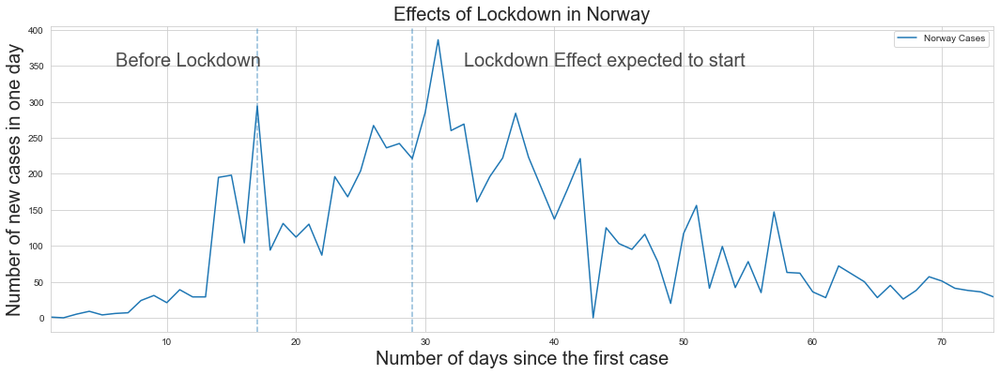

In [292]:
ax = df.plot(figsize = (18,6))
x_line_annotation = 29
x_text_annotation = 33
x_line = 17
x_text = 6

ax.axvline(x=x_line, linestyle='dashed', alpha=0.5)
ax.text(x=x_text, y=350, s='Before Lockdown ', alpha=0.7, color='Black', fontsize=20)

ax.axvline(x=x_line_annotation, linestyle='dashed', alpha=0.5)
ax.text(x=x_text_annotation, y=350, s='Lockdown Effect expected to start ', alpha=0.7, color='Black', fontsize=20)

plt.title("Effects of Lockdown in Norway", fontsize=20)
plt.xlabel("Number of days since the first case", fontsize=20)
plt.ylabel("Number of new cases in one day", fontsize=20)

In [293]:
Denmark = confirmed_df.loc[confirmed_df['Country/Region'] == 'Denmark'] #Dataset for Denmark 
Denmark.drop(Denmark.iloc[:, 0:4], inplace = True, axis = 1)
Denmark

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
92,0,0,0,0,0,0,0,0,0,0,...,187,187,187,187,187,187,187,187,187,187
93,0,0,0,0,0,0,0,0,0,0,...,11,11,11,11,11,11,11,11,11,11
94,0,0,0,0,0,0,0,0,0,0,...,9158,9311,9407,9523,9670,9821,9938,10083,10218,10319


In [294]:
Denmark.loc['Total']= Denmark.sum()
Denmark = Denmark.iloc[len(Denmark)-1:]
Denmark =Denmark.T[Denmark.any()].T
Denmark

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
Total,1,1,3,4,4,6,11,11,24,24,...,9356,9509,9605,9721,9868,10019,10136,10281,10416,10517


In [295]:
Denmark2 = Denmark.copy()
column_list = []
length = len(Denmark2.columns)
for i in range(length):
    if(i>0):
        Denmark2.iloc[0,i] = Denmark2.iloc[0,i] - Denmark.iloc[0,i-1]
        
Denmark3 = Denmark2.copy()

for i in range(length):
    if(i>0):
        Denmark3.iloc[0,i] = Denmark3.iloc[0,i] - Denmark2.iloc[0,i-1]

In [296]:
Denmark4 = Denmark3.copy()
Denmark4.drop(Denmark4.iloc[:, 27:len(Denmark4.columns)], inplace = True, axis = 1)
Denmark4

,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,...,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,3/24/20
Total,1,-1,2,-1,-1,2,3,-5,13,-13,...,7,19,34,-1,18,3,-29,11,-36,88


In [297]:
Denmark3.drop(Denmark3.iloc[:, 0:27], inplace = True, axis = 1)
date = Denmark3.keys()
date2 = Denmark4.keys()
Denmark_dates = np.array([i for i in range(len(date))]).reshape(-1, 1)
Denmark_dates2 = np.array([i for i in range(len(date2))]).reshape(-1, 1)

Denmark_cases_after_lockdown = []
Denmark_cases_before_lockdown = []

for i in date:
    confirmed_sum_Denmark = Denmark3[i].sum()
    Denmark_cases_after_lockdown.append(confirmed_sum_Denmark)
    
for i in date2:
    confirmed_sum_Denmark2 = Denmark4[i].sum()
    Denmark_cases_before_lockdown.append(confirmed_sum_Denmark2)
    
Denmark3

,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
Total,-2,17,16,-11,32,-7,93,-33,32,90,...,-7,3,-57,20,31,4,-34,28,-10,-34


In [298]:
#Calculating the mean growth rate
Denmark_last7days_beforelockdown =Denmark4.copy()
Denmark_last7days_beforelockdown.drop(Denmark_last7days_beforelockdown.iloc[:, 0:len(Denmark_last7days_beforelockdown.columns)-7], inplace = True, axis = 1)
Denmark_last7days_beforelockdown_mean = Denmark_last7days_beforelockdown.mean()
Denmark_last7days_beforelockdown['mean'] = Denmark_last7days_beforelockdown.mean(axis=1)

Denmark_last7days_afterlockdown =Denmark3.copy()
Denmark_last7days_afterlockdown.drop(Denmark_last7days_afterlockdown.iloc[:, 7:len(Denmark_last7days_afterlockdown.columns)], inplace = True, axis = 1)
Denmark_last7days_afterlockdown_mean = Denmark_last7days_afterlockdown.mean()
Denmark_last7days_afterlockdown['mean'] = Denmark_last7days_afterlockdown.mean(axis=1)

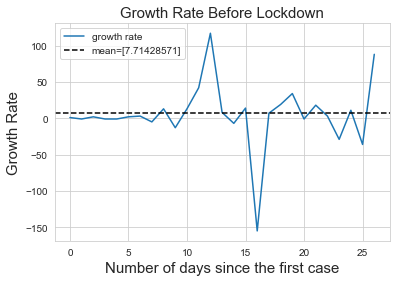

In [299]:
mean = Denmark_last7days_beforelockdown['mean'].to_numpy()
plt.plot(Denmark_dates2,Denmark_cases_before_lockdown)
plt.title('Growth Rate Before Lockdown', fontsize = 15)
plt.xlabel('Number of days since the first case', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

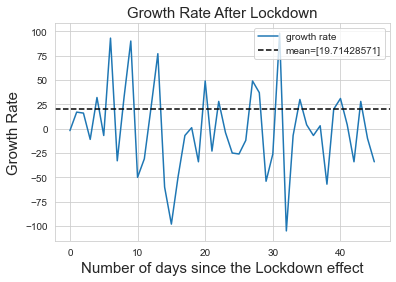

In [300]:
mean = Denmark_last7days_afterlockdown['mean'].to_numpy()
plt.plot(Denmark_dates,Denmark_cases_after_lockdown)
plt.title('Growth Rate After Lockdown', fontsize = 15)
plt.xlabel('Number of days since the Lockdown effect', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

In [301]:
Denmark_cases = []

dates = Denmark2.keys()

for i in dates:
    confirmed_sum_Denmark3 = Denmark2[i].sum()
    Denmark_cases.append(confirmed_sum_Denmark3)

In [302]:
d = {'Denmark Cases': Denmark_cases}
df = pd.DataFrame(data=d)
df.index += 1
df

,Denmark Cases
1,1
2,0
3,2
4,1
5,0
...,...
69,151
70,117
71,145
72,135


Text(0, 0.5, 'Growth Rate')

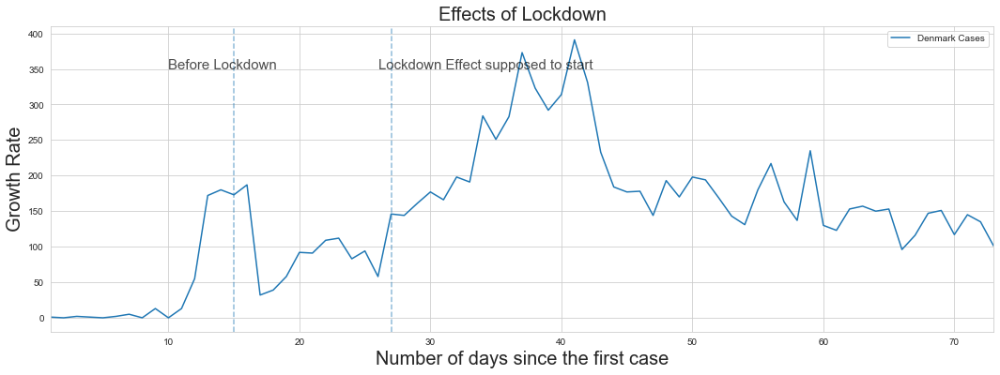

In [303]:
ax = df.plot(figsize = (18,6))
x_line_annotation = 27
x_text_annotation = 26
x_line = 15
x_text = 10

ax.axvline(x=x_line, linestyle='dashed', alpha=0.5)
ax.text(x=x_text, y=350, s='Before Lockdown ', alpha=0.7, color='Black', fontsize = 15)

ax.axvline(x=x_line_annotation, linestyle='dashed', alpha=0.5)
ax.text(x=x_text_annotation, y=350, s='Lockdown Effect supposed to start ', alpha=0.7, color='Black', fontsize = 15)

plt.title("Effects of Lockdown", fontsize=20)
plt.xlabel("Number of days since the first case", fontsize = 20)
plt.ylabel("Growth Rate", fontsize = 20)

The lockdown was very ineffective as the mobility rate dropped only by 10% (as of 11th April,2020) according to the Google Mobility Report which is why we can see there was a sharp rise in the number of Covid-19 cases even after the lockdown. 

In [304]:
Australia = confirmed_df.loc[confirmed_df['Country/Region'] == 'Australia'] #Dataset for Australia 
Australia.drop(Australia.iloc[:, 0:4], inplace = True, axis = 1)
Australia

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
8,0,0,0,0,0,0,0,0,0,0,...,106,106,106,106,107,107,107,107,107,107
9,0,0,0,0,3,4,4,4,4,4,...,3025,3030,3035,3033,3035,3042,3044,3047,3051,3053
10,0,0,0,0,0,0,0,0,0,0,...,28,27,29,29,29,29,29,29,29,29
11,0,0,0,0,0,0,0,1,3,2,...,1033,1034,1035,1038,1043,1043,1045,1045,1045,1045
12,0,0,0,0,0,0,0,0,0,0,...,438,438,438,438,438,438,438,439,439,439
13,0,0,0,0,0,0,0,0,0,0,...,221,221,221,221,221,225,226,227,227,227
14,0,0,0,0,1,1,1,1,2,3,...,1364,1371,1384,1406,1423,1440,1454,1467,1468,1487
15,0,0,0,0,0,0,0,0,0,0,...,551,551,551,551,551,551,551,552,552,552


In [305]:
Australia.loc['Total']= Australia.sum()
Australia = Australia.iloc[len(Australia)-1:]
Australia =Australia.T[Australia.any()].T
Australia

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
Total,4,5,5,6,9,9,12,12,12,13,...,6766,6778,6799,6822,6847,6875,6894,6913,6918,6939


In [306]:
Australia2 = Australia.copy()
column_list = []
length = len(Australia2.columns)
for i in range(length):
    if(i>0):
        Australia2.iloc[0,i] = Australia2.iloc[0,i] - Australia.iloc[0,i-1]
        
Australia3 = Australia2.copy()

for i in range(length):
    if(i>0):
        Australia3.iloc[0,i] = Australia3.iloc[0,i] - Australia2.iloc[0,i-1]


In [307]:
Australia4 = Australia3.copy()
Australia4.drop(Australia4.iloc[:, 68:len(Australia4.columns)], inplace = True, axis = 1)
Australia4

,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,...,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20
Total,4,-3,-1,1,2,-3,3,-3,0,1,...,229,-42,126,-113,164,-153,33,-179,105,-49


In [308]:
Australia3.drop(Australia3.iloc[:, 0:68], inplace = True, axis = 1)
date = Australia3.keys()
date2 = Australia4.keys()
Australia_dates = np.array([i for i in range(len(date))]).reshape(-1, 1)
Australia_dates2 = np.array([i for i in range(len(date2))]).reshape(-1, 1)

Australia_cases_before_lockdown = []
Australia_cases_after_lockdown = []

for i in date:
    confirmed_sum_Australia = Australia3[i].sum()
    Australia_cases_after_lockdown.append(confirmed_sum_Australia)
    
for i in date2:
    confirmed_sum_Australia2 = Australia4[i].sum()
    Australia_cases_before_lockdown.append(confirmed_sum_Australia2)
    
Australia3

,4/3/20,4/4/20,4/5/20,4/6/20,4/7/20,4/8/20,4/9/20,4/10/20,4/11/20,4/12/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
Total,-40,6,-83,-27,-12,17,-17,9,-19,-76,...,6,-2,9,2,2,3,-9,0,-14,16


In [309]:
#Calculating the mean growth rate
Australia_last7days_beforelockdown =Australia4.copy()
Australia_last7days_beforelockdown.drop(Australia_last7days_beforelockdown.iloc[:, 0:len(Australia_last7days_beforelockdown.columns)-7], inplace = True, axis = 1)
Australia_last7days_beforelockdown_mean = Australia_last7days_beforelockdown.mean()
Australia_last7days_beforelockdown['mean'] = Australia_last7days_beforelockdown.mean(axis=1)

Australia_last7days_afterlockdown =Australia3.copy()
Australia_last7days_afterlockdown.drop(Australia_last7days_afterlockdown.iloc[:, 7:len(Australia_last7days_afterlockdown.columns)], inplace = True, axis = 1)
Australia_last7days_afterlockdown_mean = Australia_last7days_afterlockdown.mean()
Australia_last7days_afterlockdown['mean'] = Australia_last7days_afterlockdown.mean(axis=1)

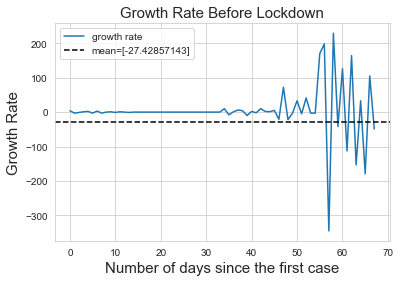

In [310]:
mean = Australia_last7days_beforelockdown['mean'].to_numpy()
plt.plot(Australia_dates2,Australia_cases_before_lockdown)
plt.title('Growth Rate Before Lockdown', fontsize = 15)
plt.xlabel('Number of days since the first case', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

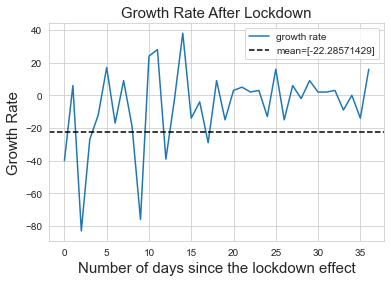

In [311]:
mean = Australia_last7days_afterlockdown['mean'].to_numpy()
plt.plot(Australia_dates,Australia_cases_after_lockdown)
plt.title('Growth Rate After Lockdown', fontsize = 15)
plt.xlabel('Number of days since the lockdown effect', fontsize =15)
plt.ylabel('Growth Rate', fontsize=15)
plt.axhline(y = mean,linestyle='--', color='black')
plt.legend(['growth rate', 'mean='+str(mean)])

In [312]:
Australia_cases = []

dates = Australia2.keys()

for i in dates:
    confirmed_sum_Australia3 = Australia2[i].sum()
    Australia_cases.append(confirmed_sum_Australia3)

In [313]:
d = {'Australia Cases': Australia_cases}
df = pd.DataFrame(data=d)
df.index += 1
df

,Australia Cases
1,4
2,1
3,0
4,1
5,3
...,...
101,28
102,19
103,19
104,5


Text(0, 0.5, 'Growth Rate')

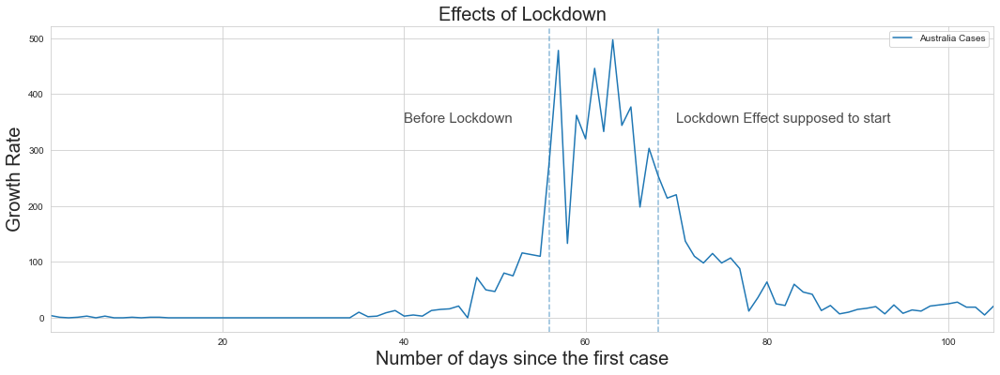

In [314]:
ax = df.plot(figsize = (18,6))
x_line_annotation = 68
x_text_annotation = 70
x_line = 56
x_text = 40

ax.axvline(x=x_line, linestyle='dashed', alpha=0.5)
ax.text(x=x_text, y=350, s='Before Lockdown ', alpha=0.7, color='Black', fontsize =15)

ax.axvline(x=x_line_annotation, linestyle='dashed', alpha=0.5)
ax.text(x=x_text_annotation, y=350, s='Lockdown Effect supposed to start ', alpha=0.7, color='Black', fontsize =15)

plt.title("Effects of Lockdown", fontsize =20)
plt.xlabel("Number of days since the first case", fontsize =20)
plt.ylabel("Growth Rate", fontsize=20)

In [315]:
China = confirmed_df.loc[confirmed_df['Country/Region'] == 'China']
China.drop(China.iloc[:, 0:4], inplace = True, axis = 1)
China.loc['Total']= China.sum()
China = China.iloc[len(China)-1:]
China

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
Total,548,643,920,1406,2075,2877,5509,6087,8141,9802,...,83956,83959,83959,83964,83966,83968,83970,83975,83976,83990


In [316]:
China2 = China.copy()
column_list = []
length = len(China2.columns)
for i in range(length):
    if(i>0):
        China2.iloc[0,i] = China2.iloc[0,i] - China.iloc[0,i-1]
        
China3 = China2.copy()

for i in range(length):
    if(i>0):
        China3.iloc[0,i] = China3.iloc[0,i] - China2.iloc[0,i-1]

In [317]:
China4 = China3.copy()

In [318]:
China3.drop(China3.iloc[:, 24:len(China3.columns)], inplace = True, axis = 1)
China3

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,...,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20
Total,548,-453,182,209,183,133,1830,-2054,1476,-393,...,-258,-586,376,-819,311,-490,-493,-1659,14763,-8673


In [319]:
China4.drop(China4.iloc[:, 0:24], inplace = True, axis = 1)
China4

,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
Total,-4408,45,-179,-144,-1369,50,15,978,-1430,198,...,8,-9,-3,5,-3,0,0,3,-4,13


In [320]:
date = China3.keys()
China_dates = np.array([i for i in range(len(date))]).reshape(-1, 1)

date2 = China4.keys()
China_dates2 = np.array([i for i in range(len(date2))]).reshape(-1, 1)

In [321]:
China_cases_after_lockdown = []

for i in date:
    confirmed_sum_China = China3[i].sum()
    China_cases_after_lockdown.append(confirmed_sum_China)
    
China_cases_before_lockdown = []

for i in date2:
    confirmed_sum_China2 = China4[i].sum()
    China_cases_before_lockdown.append(confirmed_sum_China2)

In [322]:
#calculating the mean growth rate

China_last7days_beforelockdown =China3.copy()
China_last7days_beforelockdown.drop(China_last7days_beforelockdown.iloc[:, 0:len(China_last7days_beforelockdown.columns)-7], inplace = True, axis = 1)
China_last7days_beforelockdown_mean = China_last7days_beforelockdown.mean()
China_last7days_beforelockdown['mean'] = China_last7days_beforelockdown.mean(axis=1)

China_last7days_afterlockdown =China4.copy()
China_last7days_afterlockdown.drop(China_last7days_afterlockdown.iloc[:, 7:len(China_last7days_afterlockdown.columns)], inplace = True, axis = 1)
China_last7days_afterlockdown_mean = China_last7days_afterlockdown.mean()
China_last7days_afterlockdown['mean'] = China_last7days_afterlockdown.mean(axis=1)

In [323]:
China_cases = []

dates = China2.keys()

for i in dates:
    confirmed_sum_China3 = China2[i].sum()
    China_cases.append(confirmed_sum_China3)

In [324]:
d = {'China Cases': China_cases}
df = pd.DataFrame(data=d)
df.index += 1
df

,China Cases
1,548
2,95
3,277
4,486
5,669
...,...
105,2
106,2
107,5
108,1


Text(0, 0.5, 'Growth Rate')

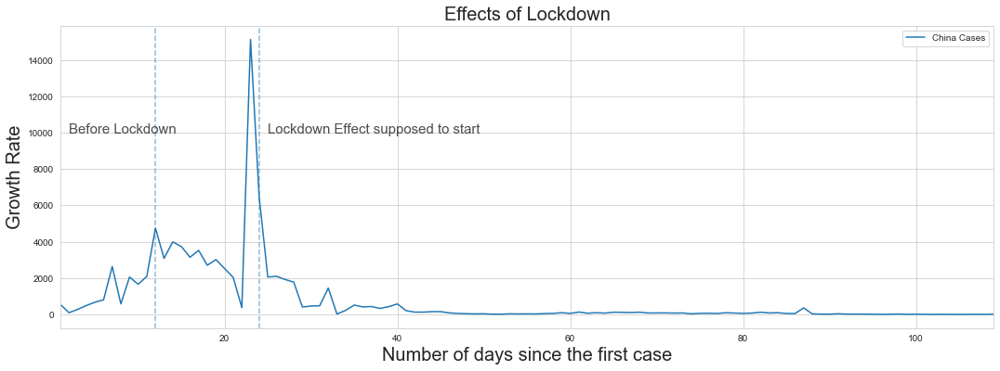

In [325]:
ax = df.plot(figsize = (18,6))
x_line_annotation = 24
x_text_annotation = 25
x_line = 12
x_text = 2

ax.axvline(x=x_line, linestyle='dashed', alpha=0.5)
ax.text(x=x_text, y=10000, s='Before Lockdown ', alpha=0.7, color='Black', fontsize =15)

ax.axvline(x=x_line_annotation, linestyle='dashed', alpha=0.5)
ax.text(x=x_text_annotation, y=10000, s='Lockdown Effect supposed to start ', alpha=0.7, color='Black', fontsize =15)

plt.title("Effects of Lockdown", fontsize =20)
plt.xlabel("Number of days since the first case", fontsize =20)
plt.ylabel("Growth Rate", fontsize =20)

In [326]:
Mean_china_growth_rate_before_lockdown = China_last7days_beforelockdown['mean'].to_numpy()
Mean_china_growth_rate_after_lockdown =China_last7days_afterlockdown['mean'].to_numpy()
Mean_italy_growth_rate_after_lockdown =Italy_last7days_afterlockdown['mean'].to_numpy()
Mean_belgium_growth_rate_after_lockdown = Belgium_last7days_afterlockdown['mean'].to_numpy()
Mean_austia_growth_rate_after_lockdown = Austria_last7days_afterlockdown['mean'].to_numpy()
Mean_uk_growth_rate_after_lockdown = UK_last7days_afterlockdown['mean'].to_numpy()
Mean_ireland_growth_rate_after_lockdown = Ireland_last7days_afterlockdown['mean'].to_numpy()
Mean_germany_growth_rate_after_lockdown = Germany_last7days_afterlockdown['mean'].to_numpy()
Mean_norway_growth_rate_after_lockdown =Norway_last7days_afterlockdown['mean'].to_numpy()
Mean_denmark_growth_rate_after_lockdown = Denmark_last7days_afterlockdown['mean'].to_numpy()
Mean_australia_growth_rate_after_lockdown = Australia_last7days_afterlockdown['mean'].to_numpy()
Mean_spain_growth_rate_after_lockdown = Spain_last7days_afterlockdown['mean'].to_numpy()
Mean_spain_growth_rate_before_lockdown = Spain_last7days_beforelockdown['mean'].to_numpy()
Mean_austria_growth_rate_before_lockdown = Austria_last7days_beforelockdown['mean'].to_numpy()
Mean_italy_growth_rate_before_lockdown = Italy_last7days_beforelockdown['mean'].to_numpy()
Mean_belgium_growth_rate_before_lockdown = Belgium_last7days_beforelockdown['mean'].to_numpy()
Mean_uk_growth_rate_before_lockdown = UK_last7days_beforelockdown['mean'].to_numpy()
Mean_ireland_growth_rate_before_lockdown =Ireland_last7days_beforelockdown['mean'].to_numpy()
Mean_germany_growth_rate_before_lockdown = Germany_last7days_beforelockdown['mean'].to_numpy()
Mean_norway_growth_rate_before_lockdown = Norway_last7days_beforelockdown['mean'].to_numpy()
Mean_denmark_growth_rate_before_lockdown = Denmark_last7days_beforelockdown['mean'].to_numpy()
Mean_australia_growth_rate_before_lockdown = Australia_last7days_beforelockdown['mean'].to_numpy()

<b> Collective Analysis <b>

In [327]:
data = {'Countries':['Spain','Ireland', 'Italy', 'Belgium', 'Austria', 'UK', 'Germany', 'Norway', 'Denmark', 'China'],
        'Mean GrowthRate After Lockdown':[Mean_spain_growth_rate_after_lockdown,Mean_ireland_growth_rate_after_lockdown, Mean_italy_growth_rate_after_lockdown, Mean_belgium_growth_rate_after_lockdown,Mean_austia_growth_rate_after_lockdown, Mean_uk_growth_rate_after_lockdown, Mean_germany_growth_rate_after_lockdown, Mean_norway_growth_rate_after_lockdown, Mean_denmark_growth_rate_after_lockdown, Mean_china_growth_rate_after_lockdown],
        'Mean GrowthRate Before Lockdown':[Mean_spain_growth_rate_before_lockdown,Mean_ireland_growth_rate_before_lockdown, Mean_italy_growth_rate_before_lockdown, Mean_belgium_growth_rate_before_lockdown,Mean_austria_growth_rate_before_lockdown, Mean_uk_growth_rate_before_lockdown, Mean_germany_growth_rate_before_lockdown, Mean_norway_growth_rate_before_lockdown, Mean_denmark_growth_rate_before_lockdown, Mean_china_growth_rate_before_lockdown]}

mean_growth_rate = pd.DataFrame(data) 
mean_growth_rate # Storing the data in a dataframe

,Countries,Mean GrowthRate After Lockdown,Mean GrowthRate Before Lockdown
0,Spain,[-46.285714285714285],[602.5714285714286]
1,Ireland,[-3.2857142857142856],[23.714285714285715]
2,Italy,[-11.0],[112.57142857142857]
3,Belgium,[-63.142857142857146],[159.42857142857142]
4,Austria,[-51.0],[26.857142857142858]
5,UK,[211.57142857142858],[174.42857142857142]
6,Germany,[-81.14285714285714],[343.57142857142856]
7,Norway,[0.14285714285714285],[19.142857142857142]
8,Denmark,[19.714285714285715],[7.714285714285714]
9,China,[-855.7142857142857],[420.0]


In [328]:
data = {'Countries':['Ireland', 'Italy', 'Belgium', 'Austria', 'UK', 'Germany', 'Norway', 'Denmark'],
        'Mean GrowthRate After Lockdown':[Mean_ireland_growth_rate_after_lockdown, Mean_italy_growth_rate_after_lockdown, Mean_belgium_growth_rate_after_lockdown,Mean_austia_growth_rate_after_lockdown, Mean_uk_growth_rate_after_lockdown, Mean_germany_growth_rate_after_lockdown, Mean_norway_growth_rate_after_lockdown, Mean_denmark_growth_rate_after_lockdown],
        'Mean GrowthRate Before Lockdown':[Mean_ireland_growth_rate_before_lockdown, Mean_italy_growth_rate_before_lockdown, Mean_belgium_growth_rate_before_lockdown,Mean_austria_growth_rate_before_lockdown, Mean_uk_growth_rate_before_lockdown, Mean_germany_growth_rate_before_lockdown, Mean_norway_growth_rate_before_lockdown, Mean_denmark_growth_rate_before_lockdown]}
viz = pd.DataFrame(data)
viz["Mean GrowthRate After Lockdown"] = pd.to_numeric(viz["Mean GrowthRate After Lockdown"].str[0], errors='ignore')
viz["Mean GrowthRate Before Lockdown"] = pd.to_numeric(viz["Mean GrowthRate Before Lockdown"].str[0], errors='ignore')


In [329]:
mean_growth_rate['Days since the first case the lockdown was implemented'] = ['42','14', '39','42','21', '54','48', '16', '15', '65']
mean_growth_rate

,Countries,Mean GrowthRate After Lockdown,Mean GrowthRate Before Lockdown,Days since the first case the lockdown was implemented
0,Spain,[-46.285714285714285],[602.5714285714286],42
1,Ireland,[-3.2857142857142856],[23.714285714285715],14
2,Italy,[-11.0],[112.57142857142857],39
3,Belgium,[-63.142857142857146],[159.42857142857142],42
4,Austria,[-51.0],[26.857142857142858],21
5,UK,[211.57142857142858],[174.42857142857142],54
6,Germany,[-81.14285714285714],[343.57142857142856],48
7,Norway,[0.14285714285714285],[19.142857142857142],16
8,Denmark,[19.714285714285715],[7.714285714285714],15
9,China,[-855.7142857142857],[420.0],65


In [330]:
mean_growth_rate["Mean GrowthRate After Lockdown"] = pd.to_numeric(mean_growth_rate["Mean GrowthRate After Lockdown"].str[0], errors='ignore')
mean_growth_rate["Mean GrowthRate Before Lockdown"] = pd.to_numeric(mean_growth_rate["Mean GrowthRate Before Lockdown"].str[0], errors='ignore')
mean_growth_rate["Days since the first case the lockdown was implemented"] = pd.to_numeric(mean_growth_rate["Days since the first case the lockdown was implemented"], errors='ignore')

In [331]:
import seaborn as sns

cm = sns.light_palette("blue", as_cmap=True)

s = mean_growth_rate.style.background_gradient(cmap=cm)
s

,Countries,Mean GrowthRate After Lockdown,Mean GrowthRate Before Lockdown,Days since the first case the lockdown was implemented
0,Spain,-46.2857,602.571,42
1,Ireland,-3.28571,23.7143,14
2,Italy,-11,112.571,39
3,Belgium,-63.1429,159.429,42
4,Austria,-51,26.8571,21
5,UK,211.571,174.429,54
6,Germany,-81.1429,343.571,48
7,Norway,0.142857,19.1429,16
8,Denmark,19.7143,7.71429,15
9,China,-855.714,420,65


Text(0.5, 1.0, 'Effect of Lockdown')

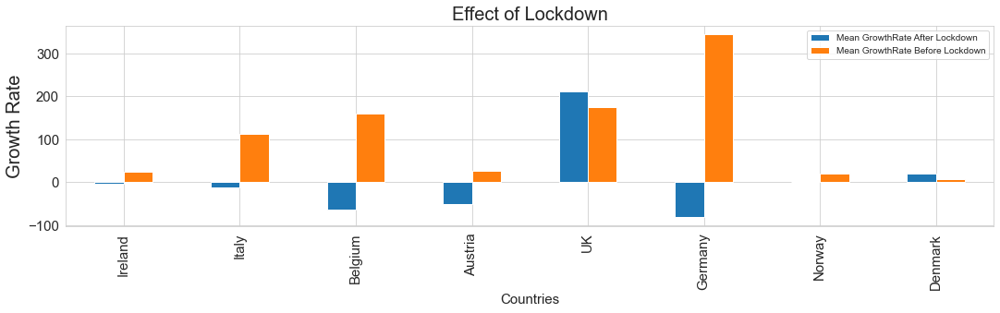

In [332]:
viz = viz.set_index('Countries')
viz.plot.bar(figsize = (18,4), fontsize = 15)
plt.ylabel('Growth Rate', fontsize = 20)
plt.xlabel('Countries', fontsize = 15)
plt.title('Effect of Lockdown', fontsize = 20)

In [333]:
mean_growth_rate = mean_growth_rate.set_index('Countries')

In [334]:
mean_growth_rate = mean_growth_rate.reset_index()

In [335]:
mean_growth_rate =mean_growth_rate.set_index('Countries')
mean_growth_rate = mean_growth_rate.drop(['Denmark', 'Norway'])

In [336]:
mean_growth_rate =mean_growth_rate.reset_index()

In [337]:
mean_growth_rate 

,Countries,Mean GrowthRate After Lockdown,Mean GrowthRate Before Lockdown,Days since the first case the lockdown was implemented
0,Spain,-46.285714,602.571429,42
1,Ireland,-3.285714,23.714286,14
2,Italy,-11.000000,112.571429,39
3,Belgium,-63.142857,159.428571,42
4,Austria,-51.000000,26.857143,21
5,UK,211.571429,174.428571,54
6,Germany,-81.142857,343.571429,48
7,China,-855.714286,420.000000,65


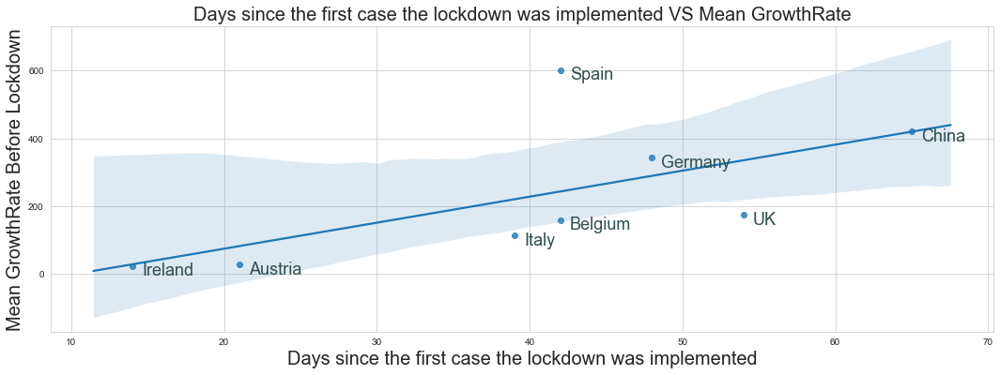

In [338]:
import seaborn
x= mean_growth_rate['Days since the first case the lockdown was implemented']
y= mean_growth_rate['Mean GrowthRate Before Lockdown']
n= mean_growth_rate['Countries']
plt.figure(figsize = (18,6))
fig = sns.regplot(x="Days since the first case the lockdown was implemented", y="Mean GrowthRate Before Lockdown", data=mean_growth_rate);

#ax.scatter(x, y)

plt.title("Days since the first case the lockdown was implemented VS Mean GrowthRate", fontsize=20)
plt.xlabel("Days since the first case the lockdown was implemented", fontsize=20)
plt.ylabel("Mean GrowthRate Before Lockdown", fontsize=20)



for i, txt in enumerate(n):
    fig.annotate(txt, (x[i], y[i]),xytext=(10,-10), textcoords='offset points',family='sans-serif', fontsize=18, color='darkslategrey')

There's a tendency that a country would have a higher growth rate (before lockdown) if they take more time to implement lockdown. 

# Research Question 3: Why has there been a sharp rise in the number of cases in US?

<b> Data Collection and Visualization 

In [339]:
US_mobility = pd.read_csv('https://raw.githubusercontent.com/debanjandas9999/Coronavirus_Analysis/master/mobility_US_states.csv')

In [340]:
US_mobility

,Date,State,Region,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,Residential
0,2020-04-11,Alabama,Total,-39.0,3.0,11.0,-35.0,-29.0,10.0
1,2020-04-11,Alabama,Autauga County,-37.0,16.0,-14.0,NaN,-30.0,20.0
2,2020-04-11,Alabama,Baldwin County,-44.0,-10.0,-42.0,-39.0,-28.0,11.0
3,2020-04-11,Alabama,Barbour County,-18.0,-20.0,NaN,NaN,-31.0,NaN
4,2020-04-11,Alabama,Bibb County,-42.0,-15.0,NaN,NaN,-19.0,NaN
...,...,...,...,...,...,...,...,...,...
2870,2020-04-11,Wyoming,Sweetwater County,-35.0,13.0,NaN,15.0,-27.0,15.0
2871,2020-04-11,Wyoming,Teton County,-85.0,-53.0,-63.0,-83.0,-66.0,NaN
2872,2020-04-11,Wyoming,Uinta County,-31.0,-11.0,NaN,2.0,-22.0,NaN
2873,2020-04-11,Wyoming,Washakie County,-28.0,-23.0,NaN,NaN,-40.0,NaN


In [341]:
US_mobility = US_mobility.loc[US_mobility['Region'] == 'Total']

US_mobility.drop(US_mobility.columns[[2]], axis = 1, inplace = True)
US_mobility

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Date,State,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,Residential
0,2020-04-11,Alabama,-39.0,3.0,11.0,-35.0,-29.0,10.0
68,2020-04-11,Alaska,-41.0,-4.0,36.0,-52.0,-32.0,10.0
81,2020-04-11,Arizona,-43.0,-14.0,-42.0,-45.0,-36.0,14.0
97,2020-04-11,Arkansas,-35.0,1.0,1.0,-34.0,-26.0,10.0
169,2020-04-11,California,-48.0,-14.0,-46.0,-53.0,-40.0,18.0
226,2020-04-11,Colorado,-46.0,-11.0,-2.0,-53.0,-40.0,14.0
280,2020-04-11,Connecticut,-44.0,-9.0,76.0,-54.0,-40.0,15.0
289,2020-04-11,Delaware,-41.0,-16.0,26.0,-48.0,-37.0,14.0
293,2020-04-11,District of Columbia,-69.0,-28.0,-65.0,-69.0,-48.0,17.0
294,2020-04-11,Florida,-49.0,-20.0,-54.0,-65.0,-40.0,15.0


In [342]:
US_mobility['mean'] = US_mobility.mean(axis=1) # Finding the mean decrease in mobility
US_mobility = US_mobility.sort_values(by='mean') # Sorting them according to their mean  

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Text(0.5, 1.0, 'Mobility in US states')

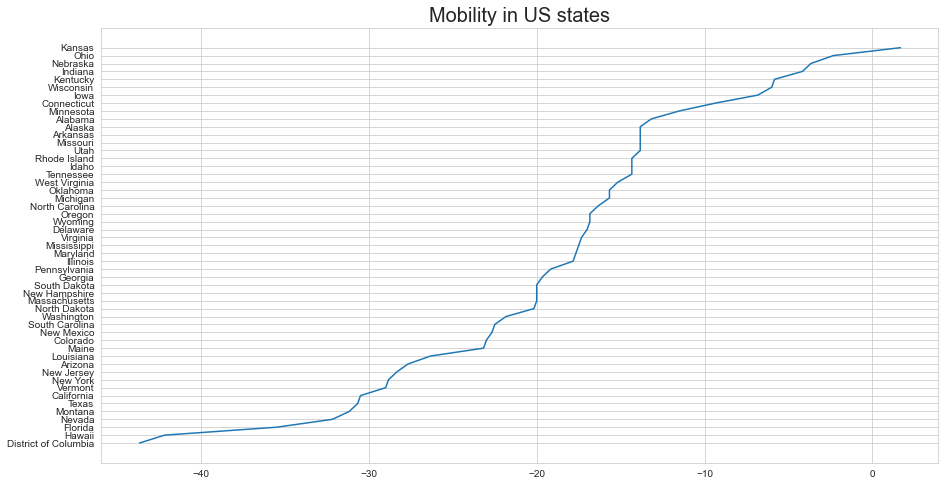

In [343]:
plt.figure(figsize=(15, 8))
plt.plot(US_mobility['mean'], US_mobility['State'])
plt.title('Mobility in US states', fontsize = 20)

In [344]:
US = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_US.csv')

In [345]:
US_deaths = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_US.csv')
US_deaths.drop(US_deaths.columns[[0, 1, 2, 3, 4, 5,7,8,9,10,11]], axis = 1, inplace = True)
US_deaths

,Province_State,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
0,American Samoa,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Guam,0,0,0,0,0,0,0,0,0,...,5,5,5,5,5,5,5,5,5,5
2,Northern Mariana Islands,0,0,0,0,0,0,0,0,0,...,2,2,2,2,2,2,2,2,2,2
3,Puerto Rico,0,0,0,0,0,0,0,0,0,...,92,94,95,97,97,99,99,102,107,108
4,Virgin Islands,0,0,0,0,0,0,0,0,0,...,4,4,4,4,4,4,4,4,4,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3256,Utah,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3257,Utah,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3258,Utah,0,0,0,0,0,0,0,0,0,...,2,2,2,2,2,3,3,3,3,3
3259,Utah,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [346]:
US.drop(US.columns[[0, 1, 2, 3, 4, 5,7,8,9]], axis = 1, inplace = True)
US.drop(US.columns[[1]], axis = 1, inplace = True)
US.head()

,Province_State,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
0,American Samoa,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Guam,0,0,0,0,0,0,0,0,0,...,145,145,145,145,145,145,149,149,151,151
2,Northern Mariana Islands,0,0,0,0,0,0,0,0,0,...,14,14,14,14,14,14,15,15,15,16
3,Puerto Rico,0,0,0,0,0,0,0,0,0,...,1539,1575,1757,1808,1843,1924,1968,2031,2156,2173
4,Virgin Islands,0,0,0,0,0,0,0,0,0,...,66,66,66,66,66,66,66,66,68,68


In this context, recovery rate denotes at what rate (in terms of number of recoveries) are the recoveries increasing everyday.

In [347]:
def rate(df): # Function to return growth rate when a dataframe is passed to the function
    df.drop(df.columns[[0]], axis = 1, inplace = True)
    df2 = df.copy()
    column_list = []
    length = len(df.columns) 
    length2 = length - 25
    for i in range(length):
        if(i>0):
            df2.iloc[0,i] = df2.iloc[0,i] - df.iloc[0,i-1]
    df3 = df2.copy()
    df3.drop(df3.iloc[:, 0:25], inplace = True, axis = 1)
    df2.drop(df2.iloc[:, 0:25], inplace = True, axis = 1)
    df.drop(df.iloc[:, 0:25], inplace = True, axis = 1)
    for i in range(length2):
        if(i>0):
            df3.iloc[0,i] = df3.iloc[0,i] - df2.iloc[0,i-1]
            
    df3.drop(df3.iloc[:, 0:34], inplace = True, axis = 1) 
    df3.drop(df3.iloc[:, 16:len(df3.columns)], inplace = True, axis = 1)     

    Mean_df_growth_rate = df3.sum(axis=1)/len(df3.columns)
    
    return(Mean_df_growth_rate)

In [348]:
df = US.loc[US['Province_State'] == 'Connecticut']
df.loc['Total']= df.sum()
df = df.iloc[10:]
df.drop(df.columns[[0]], axis = 1, inplace = True)
df2 = df.copy()
column_list = []
length = len(df.columns) 
length2 = length - 25
for i in range(length):
    if(i>0):
        df2.iloc[0,i] = df2.iloc[0,i] - df.iloc[0,i-1]
df3 = df2.copy()
df3.drop(df3.iloc[:, 0:25], inplace = True, axis = 1)
df2.drop(df2.iloc[:, 0:25], inplace = True, axis = 1)
df.drop(df.iloc[:, 0:25], inplace = True, axis = 1)
for i in range(length2):
    if(i>0):
        df3.iloc[0,i] = df3.iloc[0,i] - df2.iloc[0,i-1]
            
df3.drop(df3.iloc[:, 0:34], inplace = True, axis = 1) 
df3.drop(df3.iloc[:, 16:len(df3.columns)], inplace = True, axis = 1)
df3

C:\Users\User\Anaconda3\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,3/21/20,3/22/20,3/23/20,3/24/20,3/25/20,3/26/20,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,4/5/20
Total,-35,133,-45,115,54,-120,142,-46,236,109,-21,-128,-162,823,-728,37


In [349]:
def dat(df):
    df.drop(df.columns[[0]], axis = 1, inplace = True)
    df2 = df.copy()
    column_list = []
    length = len(df.columns) 
    length2 = length - 25
    for i in range(length):
        if(i>0):
            df2.iloc[0,i] = df2.iloc[0,i] - df.iloc[0,i-1]
    df3 = df2.copy()
    df3.drop(df3.iloc[:, 0:25], inplace = True, axis = 1)
    df2.drop(df2.iloc[:, 0:25], inplace = True, axis = 1)
    df.drop(df.iloc[:, 0:25], inplace = True, axis = 1)
    for i in range(length2):
        if(i>0):
            df3.iloc[0,i] = ((df3.iloc[0,i] - df2.iloc[0,i-1]) / (df.iloc[0,i]))
        
   

    Mean_df_growth_rate = df3.sum(axis=1)/len(df3.columns)
    date = df3.keys()
    date2 = np.array([i for i in range(len(date))]).reshape(-1, 1)
    return(date2)

In [350]:
def cases(df):
    df.drop(df.columns[[0]], axis = 1, inplace = True)
    df2 = df.copy()
    column_list = []
    length = len(df.columns) 
    length2 = length - 25
    for i in range(length):
        if(i>0):
            df2.iloc[0,i] = df2.iloc[0,i] - df.iloc[0,i-1]
    
    df2.drop(df2.iloc[:, 0:25], inplace = True, axis = 1)
    df.drop(df.iloc[:, 0:25], inplace = True, axis = 1)
    
    Mean_df_growth_rate = df2.sum(axis=1)/len(df2.columns)
    date = df2.keys()
    date2 = np.array([i for i in range(len(date))]).reshape(-1, 1)
    df2_cases = []
    for i in date:
        confirmed_sum_df = df2[i].sum()
        df2_cases.append(confirmed_sum_df)
    
    return(df2_cases)

In [351]:
state_pop = pd.read_csv('https://raw.githubusercontent.com/debanjandas9999/Coronavirus_Analysis/master/states_population.csv')
state_pop

,State Name,State_Code,2019 Estimate
0,.Alabama,AL,4903185
1,.Alaska,AK,731545
2,.Arizona,AZ,7278717
3,.Arkansas,AR,3017804
4,.California,CA,39512223
5,.Colorado,CO,5758736
6,.Connecticut,CT,3565287
7,.Delaware,DE,973764
8,.District of Columbia,DC,705749
9,.Florida,FL,21477737


In [352]:
Connecticut = US.loc[US['Province_State'] == 'Connecticut']
Connecticut.loc['Total']= Connecticut.sum()
Connecticut = Connecticut.iloc[10:]
Mean_connecticut_growth_rate = rate(Connecticut)
Mean_connecticut_growth_rate

Total    22.75
dtype: float64

In [353]:
Connecticut2 = US_deaths.loc[US_deaths['Province_State'] == 'Connecticut']
Connecticut2.loc['Total']= Connecticut2.sum()
Connecticut2 = Connecticut2.iloc[10:]
val = state_pop.loc[state_pop['State_Code'] == 'CT', '2019 Estimate'].to_numpy()
Connecticut3 = Connecticut2.copy()
Connecticut3.iloc[0,len(Connecticut3.columns)-1] = Connecticut3.iloc[0,len(Connecticut3.columns)-1] 
Connecticut3

,Province_State,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
Total,ConnecticutConnecticutConnecticutConnecticutCo...,0,0,0,0,0,0,0,0,0,...,2257,2339,2436,2436,2556,2633,2718,2797,2874,2932


In [354]:
Mean_connecticut_death_rate2 = Connecticut3.iloc[0,len(Connecticut3.columns)-1]
Mean_connecticut_death_rate2
Mean_connecticut_growth_rate = rate(Connecticut)
Mean_connecticut_growth_rate
Mean_connecticut_death_rate = rate(Connecticut2)
Mean_connecticut_death_rate

Total    1.4375
dtype: float64

In [355]:
Connecticut = US.loc[US['Province_State'] == 'Connecticut']
Connecticut.loc['Total']= Connecticut.sum()
Connecticut = Connecticut.iloc[10:]

Connecticut_dates = dat(Connecticut)

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning:

invalid value encountered in longlong_scalars



In [356]:
Connecticut = US.loc[US['Province_State'] == 'Connecticut']
Connecticut.loc['Total']= Connecticut.sum()
Connecticut = Connecticut.iloc[10:]
connecticut_cases = []
connecticut_cases = cases(Connecticut)
connecticut_deaths = []
connecticut_deaths = cases(Connecticut2)

In [357]:
# Getting the growth rate, death rate

New_Hampshire = US.loc[US['Province_State'] == 'New Hampshire']
New_Hampshire.loc['Total']= New_Hampshire.sum()
New_Hampshire = New_Hampshire.iloc[len(New_Hampshire)-1:]

New_Hampshire2 = US_deaths.loc[US_deaths['Province_State'] == 'New Hampshire']
New_Hampshire2.loc['Total']= New_Hampshire2.sum()
New_Hampshire2 = New_Hampshire2.iloc[len(New_Hampshire2)-1:]

val = state_pop.loc[state_pop['State_Code'] == 'NH', '2019 Estimate'].to_numpy()
New_Hampshire3 = New_Hampshire2.copy()
New_Hampshire3.iloc[0,len(New_Hampshire3.columns)-1] = New_Hampshire3.iloc[0,len(New_Hampshire3.columns)-1] / New_Hampshire.iloc[0,len(New_Hampshire.columns)-1]

Mean_New_Hampshire_growth_rate = rate(New_Hampshire)
Mean_New_Hampshire_death_rate = rate(New_Hampshire2)
Mean_New_Hampshire_death_rate2 = New_Hampshire3.iloc[0,len(New_Hampshire3.columns)-1]
Mean_New_Hampshire_death_rate2

0.04350714048488874

In [358]:
# Getting the list for cases and dates

New_Hampshire = US.loc[US['Province_State'] == 'New Hampshire']
New_Hampshire.loc['Total']= New_Hampshire.sum()
New_Hampshire = New_Hampshire.iloc[len(New_Hampshire)-1:]

New_Hampshire2 = US_deaths.loc[US_deaths['Province_State'] == 'New Hampshire']
New_Hampshire2.loc['Total']= New_Hampshire2.sum()
New_Hampshire2 = New_Hampshire2.iloc[len(New_Hampshire2)-1:]

New_Hampshire_dates = dat(New_Hampshire)

New_Hampshire = US.loc[US['Province_State'] == 'New Hampshire']
New_Hampshire.loc['Total']= New_Hampshire.sum()
New_Hampshire = New_Hampshire.iloc[len(New_Hampshire)-1:]

New_Hampshiret_cases = []
New_Hampshire_cases = cases(New_Hampshire)

New_Hampshiret_deaths = []
New_Hampshire_deaths = cases(New_Hampshire2)

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning:

invalid value encountered in longlong_scalars



In [359]:
# Getting the growth rate, death rate
Florida = US.loc[US['Province_State'] == 'Florida']
Florida.loc['Total']= Florida.sum()
Florida = Florida.iloc[69:]

Florida2 = US_deaths.loc[US_deaths['Province_State'] == 'Florida']
Florida2.loc['Total']= Florida2.sum()
Florida2 = Florida2.iloc[69:]

val = state_pop.loc[state_pop['State_Code'] == 'FL', '2019 Estimate'].to_numpy()
Florida3 = Florida2.copy()
Florida3.iloc[0,len(Florida3.columns)-1] = Florida3.iloc[0,len(Florida3.columns)-1] / Florida.iloc[0,len(Florida.columns)-1]

Mean_Florida_growth_rate = rate(Florida)
Mean_Florida_death_rate = rate(Florida2)
Mean_Florida_death_rate2 = Florida3.iloc[0,len(Florida3.columns)-1]
Mean_Florida_death_rate2

0.042873928151796206

In [360]:
Florida = US.loc[US['Province_State'] == 'Florida']
Florida.loc['Total']= Florida.sum()
Florida = Florida.iloc[69:]

Florida2 = US_deaths.loc[US_deaths['Province_State'] == 'Florida']
Florida2.loc['Total']= Florida2.sum()
Florida2 = Florida2.iloc[69:]

Florida_dates = dat(Florida)
Florida = US.loc[US['Province_State'] == 'Florida']
Florida.loc['Total']= Florida.sum()
Florida = Florida.iloc[69:]
Florida_cases = cases(Florida)
Florida_deaths = cases(Florida2)

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning:

invalid value encountered in longlong_scalars



In [361]:
# Getting the growth rate, death rate, list cases and dates
Mississippi = US.loc[US['Province_State'] == 'Mississippi']
Mississippi
Mississippi.loc['Total']= Mississippi.sum()
Mississippi = Mississippi.iloc[84:]

Mississippi2 = US_deaths.loc[US_deaths['Province_State'] == 'Mississippi']
Mississippi2.loc['Total']= Mississippi2.sum()
Mississippi2 = Mississippi2.iloc[84:]

val = state_pop.loc[state_pop['State_Code'] == 'MS', '2019 Estimate'].to_numpy()
Mississippi3 = Mississippi2.copy()
Mississippi3.iloc[0,len(Mississippi3.columns)-1] = Mississippi3.iloc[0,len(Mississippi3.columns)-1] / Mississippi.iloc[0,len(Mississippi.columns)-1]

Mean_Mississippi_growth_rate = rate(Mississippi)
Mean_Mississippi_death_rate = rate(Mississippi2)
Mean_Mississippi_death_rate2 = Mississippi3.iloc[0,len(Mississippi3.columns)-1]

Mississippi = US.loc[US['Province_State'] == 'Mississippi']
Mississippi
Mississippi.loc['Total']= Mississippi.sum()
Mississippi = Mississippi.iloc[84:]

Mississippi2 = US_deaths.loc[US_deaths['Province_State'] == 'Mississippi']
Mississippi2.loc['Total']= Mississippi2.sum()
Mississippi2 = Mississippi2.iloc[84:]


Mississippi_dates = dat(Mississippi)

Mississippi = US.loc[US['Province_State'] == 'Mississippi']
Mississippi
Mississippi.loc['Total']= Mississippi.sum()
Mississippi = Mississippi.iloc[84:]

Mississippi_cases = cases(Mississippi)
Mississippi_deaths = cases(Mississippi2)

Mean_Mississippi_death_rate2

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning:

invalid value encountered in longlong_scalars



0.04489230113030497

In [362]:
# Getting the growth rate, death rate, list cases and dates

Tennessee = US.loc[US['Province_State'] == 'Tennessee']
Tennessee
Tennessee.loc['Total']= Tennessee.sum()
Tennessee = Tennessee.iloc[97:]

Tennessee2 = US_deaths.loc[US_deaths['Province_State'] == 'Tennessee']
Tennessee2
Tennessee2.loc['Total']= Tennessee2.sum()
Tennessee2 = Tennessee2.iloc[97:]

val = state_pop.loc[state_pop['State_Code'] == 'TN', '2019 Estimate'].to_numpy()
Tennessee3 = Tennessee2.copy()
Tennessee3.iloc[0,len(Tennessee3.columns)-1] = Tennessee3.iloc[0,len(Tennessee3.columns)-1] / Tennessee.iloc[0,len(Tennessee.columns)-1]

Mean_Tennessee_growth_rate = rate(Tennessee)
Mean_Tennessee_death_rate = rate(Tennessee2)
Mean_Tennessee_death_rate2 = Tennessee3.iloc[0,len(Tennessee3.columns)-1]

Tennessee = US.loc[US['Province_State'] == 'Tennessee']
Tennessee
Tennessee.loc['Total']= Tennessee.sum()
Tennessee = Tennessee.iloc[97:]

Tennessee2 = US_deaths.loc[US_deaths['Province_State'] == 'Tennessee']
Tennessee2
Tennessee2.loc['Total']= Tennessee2.sum()
Tennessee2 = Tennessee2.iloc[97:]

Tennessee_dates = dat(Tennessee)
Tennessee = US.loc[US['Province_State'] == 'Tennessee']
Tennessee
Tennessee.loc['Total']= Tennessee.sum()
Tennessee = Tennessee.iloc[97:]

Tennessee_cases = cases(Tennessee)
Tennessee_deaths = cases(Tennessee2)
Mean_Tennessee_death_rate2

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning:

invalid value encountered in longlong_scalars



0.016386782231852654

In [363]:
# Getting the growth rate, death rate, list cases and dates

Alabama = US.loc[US['Province_State'] == 'Alabama']
Alabama.loc['Total']= Alabama.sum()
Alabama = Alabama.iloc[69:]

Alabama2= US_deaths.loc[US_deaths['Province_State'] == 'Alabama']
Alabama2.loc['Total']= Alabama2.sum()
Alabama2 = Alabama2.iloc[69:]

val = state_pop.loc[state_pop['State_Code'] == 'AL', '2019 Estimate'].to_numpy()
Alabama3 = Alabama2.copy()
Alabama3.iloc[0,len(Alabama3.columns)-1] = Alabama3.iloc[0,len(Alabama3.columns)-1] / Alabama.iloc[0,len(Alabama.columns)-1]

Mean_Alabama_growth_rate = rate(Alabama)
Mean_Alabama_death_rate = rate(Alabama2)
Mean_Alabama_death_rate2 = Alabama3.iloc[0,len(Alabama3.columns)-1]

Alabama = US.loc[US['Province_State'] == 'Alabama']
Alabama.loc['Total']= Alabama.sum()
Alabama = Alabama.iloc[69:]

Alabama2= US_deaths.loc[US_deaths['Province_State'] == 'Alabama']
Alabama2.loc['Total']= Alabama2.sum()
Alabama2 = Alabama2.iloc[69:]

Alabama_dates = dat(Alabama)

Alabama = US.loc[US['Province_State'] == 'Alabama']
Alabama.loc['Total']= Alabama.sum()
Alabama = Alabama.iloc[69:]

Alabama_cases = cases(Alabama)
Alabama_deaths = cases(Alabama2)
Mean_Alabama_death_rate2

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning:

invalid value encountered in longlong_scalars



0.04033926354985519

In [364]:
# Getting the growth rate, death rate, list cases and dates

Ohio = US.loc[US['Province_State'] == 'Ohio']
Ohio.loc['Total']= Ohio.sum()
Ohio = Ohio.iloc[90:]

Ohio2 = US_deaths.loc[US_deaths['Province_State'] == 'Ohio']
Ohio2.loc['Total']= Ohio2.sum()
Ohio2 = Ohio2.iloc[90:]

val = state_pop.loc[state_pop['State_Code'] == 'OH', '2019 Estimate'].to_numpy()
Ohio3 = Ohio2.copy()
Ohio3.iloc[0,len(Ohio3.columns)-1] = Ohio3.iloc[0,len(Ohio3.columns)-1] / Ohio.iloc[0,len(Ohio.columns)-1]

Mean_Ohio_growth_rate = rate(Ohio)
Mean_Ohio_death_rate = rate(Ohio2)
Mean_Ohio_death_rate2 = Ohio3.iloc[0,len(Ohio3.columns)-1]

Ohio = US.loc[US['Province_State'] == 'Ohio']
Ohio.loc['Total']= Ohio.sum()
Ohio = Ohio.iloc[90:]

Ohio2 = US_deaths.loc[US_deaths['Province_State'] == 'Ohio']
Ohio2.loc['Total']= Ohio2.sum()
Ohio2 = Ohio2.iloc[90:]

Ohio_dates = dat(Ohio)

Ohio = US.loc[US['Province_State'] == 'Ohio']
Ohio.loc['Total']= Ohio.sum()
Ohio = Ohio.iloc[90:]

Ohio_cases = cases(Ohio)
Ohio_deaths = cases(Ohio2)
Mean_Ohio_death_rate2

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning:

invalid value encountered in longlong_scalars



0.05616744735620543

In [365]:
# Getting the growth rate, death rate, list cases and dates

Missouri = US.loc[US['Province_State'] == 'Missouri']
Missouri.loc['Total']= Missouri.sum()
Missouri = Missouri.iloc[118:]

Missouri2 = US_deaths.loc[US_deaths['Province_State'] == 'Missouri']
Missouri2.loc['Total']= Missouri2.sum()
Missouri2 = Missouri2.iloc[118:]

val = state_pop.loc[state_pop['State_Code'] == 'MO', '2019 Estimate'].to_numpy()
Missouri3 =Missouri2.copy()
Missouri3.iloc[0,len(Missouri3.columns)-1] =Missouri3.iloc[0,len(Missouri3.columns)-1] / Missouri.iloc[0,len(Missouri.columns)-1]


Mean_Missouri_growth_rate = rate(Missouri)
Mean_Missouri_death_rate = rate(Missouri2)
Mean_Missouri_death_rate2 = Missouri3.iloc[0,len(Missouri3.columns)-1]

Missouri = US.loc[US['Province_State'] == 'Missouri']
Missouri.loc['Total']= Missouri.sum()
Missouri = Missouri.iloc[118:]

Missouri2 = US_deaths.loc[US_deaths['Province_State'] == 'Missouri']
Missouri2.loc['Total']= Missouri2.sum()
Missouri2 = Missouri2.iloc[118:]

Missouri_dates = dat(Missouri)

Missouri = US.loc[US['Province_State'] == 'Missouri']
Missouri.loc['Total']= Missouri.sum()
Missouri = Missouri.iloc[118:]

Missouri_cases = cases(Missouri)
Missouri_deaths = cases(Missouri2)
Mean_Missouri_death_rate2

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning:

invalid value encountered in longlong_scalars



0.04984360811219857

In [366]:
# Getting the growth rate, death rate, list cases and dates

Vermont = US.loc[US['Province_State'] == 'Vermont']
Vermont.loc['Total']= Vermont.sum()
Vermont = Vermont.iloc[16:]

Vermont2 = US_deaths.loc[US_deaths['Province_State'] == 'Vermont']
Vermont2.loc['Total']= Vermont2.sum()
Vermont2 = Vermont2.iloc[16:]

val = state_pop.loc[state_pop['State_Code'] == 'VT', '2019 Estimate'].to_numpy()
Vermont3 =Vermont2.copy()
Vermont3.iloc[0,len(Vermont3.columns)-1] =Vermont3.iloc[0,len(Vermont3.columns)-1] / Vermont.iloc[0,len(Vermont.columns)-1]

Mean_Vermont_growth_rate = rate(Vermont)
Mean_Vermont_death_rate = rate(Vermont2)
Mean_Vermont_death_rate2 = Vermont3.iloc[0,len(Vermont3.columns)-1]

Vermont = US.loc[US['Province_State'] == 'Vermont']
Vermont.loc['Total']= Vermont.sum()
Vermont = Vermont.iloc[16:]

Vermont2 = US_deaths.loc[US_deaths['Province_State'] == 'Vermont']
Vermont2.loc['Total']= Vermont2.sum()
Vermont2 = Vermont2.iloc[16:]

Vermont_dates = dat(Vermont)

Vermont = US.loc[US['Province_State'] == 'Vermont']
Vermont.loc['Total']= Vermont.sum()
Vermont = Vermont.iloc[16:]

Vermont_cases = cases(Vermont)
Vermont_deaths = cases(Vermont2)
Mean_Vermont_death_rate2

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning:

invalid value encountered in longlong_scalars



0.05754614549402823

In [367]:
# Getting the growth rate, death rate, list cases and dates

Hawaii = US.loc[US['Province_State'] == 'Hawaii']
Hawaii.loc['Total']= Hawaii.sum()
Hawaii = Hawaii.iloc[7:]

Hawaii2 = US_deaths.loc[US_deaths['Province_State'] == 'Hawaii']
Hawaii2.loc['Total']= Hawaii2.sum()
Hawaii2 = Hawaii2.iloc[7:]

val = state_pop.loc[state_pop['State_Code'] == 'HI', '2019 Estimate'].to_numpy()
Hawaii3 =Hawaii2.copy()
Hawaii3.iloc[0,len(Hawaii3.columns)-1] =Hawaii3.iloc[0,len(Hawaii3.columns)-1] / Hawaii.iloc[0,len(Hawaii.columns)-1]


Mean_Hawaii_growth_rate = rate(Hawaii)
Mean_Hawaii_death_rate = rate(Hawaii2)
Mean_Hawaii_death_rate2 = Hawaii3.iloc[0,len(Hawaii3.columns)-1]

Hawaii = US.loc[US['Province_State'] == 'Hawaii']
Hawaii.loc['Total']= Hawaii.sum()
Hawaii = Hawaii.iloc[7:]

Hawaii2 = US_deaths.loc[US_deaths['Province_State'] == 'Hawaii']
Hawaii2.loc['Total']= Hawaii2.sum()
Hawaii2 = Hawaii2.iloc[7:]

Hawaii_dates = dat(Hawaii)


Hawaii = US.loc[US['Province_State'] == 'Hawaii']
Hawaii.loc['Total']= Hawaii.sum()
Hawaii = Hawaii.iloc[7:]


Hawaii_cases = cases(Hawaii)
Hawaii_deaths = cases(Hawaii2)
Mean_Hawaii_death_rate

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning:

invalid value encountered in longlong_scalars



Total    0.0625
dtype: float64

In [368]:
Hawaii2 = US_deaths.loc[US_deaths['Province_State'] == 'Hawaii']
Hawaii2.loc['Total']= Hawaii2.sum()
Hawaii2 = Hawaii2.iloc[7:]
Hawaii2

,Province_State,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,...,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20
Total,HawaiiHawaiiHawaiiHawaiiHawaiiHawaiiHawaii,0,0,0,0,0,0,0,0,0,...,16,16,16,17,17,17,17,17,17,17


In [369]:
# Getting the growth rate, death rate, list cases and dates

Massachusetts = US.loc[US['Province_State'] == 'Massachusetts']
Massachusetts.loc['Total']= Massachusetts.sum()
Massachusetts = Massachusetts.iloc[17:]

Massachusetts2 = US_deaths.loc[US_deaths['Province_State'] == 'Massachusetts']
Massachusetts2.loc['Total']= Massachusetts2.sum()
Massachusetts2 = Massachusetts2.iloc[17:]

val = state_pop.loc[state_pop['State_Code'] == 'MA', '2019 Estimate'].to_numpy()
Massachusetts3 =Massachusetts2.copy()
Massachusetts3.iloc[0,len(Massachusetts3.columns)-1] =Massachusetts3.iloc[0,len(Massachusetts3.columns)-1] / Massachusetts.iloc[0,len(Massachusetts.columns)-1]

Mean_Massachusetts_growth_rate = rate(Massachusetts)
Mean_Massachusetts_death_rate = rate(Massachusetts2)
Mean_Massachusetts_death_rate2 = Massachusetts3.iloc[0,len(Hawaii3.columns)-1]

Massachusetts = US.loc[US['Province_State'] == 'Massachusetts']
Massachusetts.loc['Total']= Massachusetts.sum()
Massachusetts = Massachusetts.iloc[17:]

Massachusetts2 = US_deaths.loc[US_deaths['Province_State'] == 'Massachusetts']
Massachusetts2.loc['Total']= Massachusetts2.sum()
Massachusetts2 = Massachusetts2.iloc[17:]

Massachusetts_dates = dat(Massachusetts)
Massachusetts_deaths = cases(Massachusetts2)

Massachusetts = US.loc[US['Province_State'] == 'Massachusetts']
Massachusetts.loc['Total']= Massachusetts.sum()
Massachusetts = Massachusetts.iloc[17:]

Massachusetts_cases = cases(Massachusetts)
Mean_Massachusetts_death_rate2

0.0630676413483966

In [370]:
# Getting the growth rate, death rate, list cases and dates

Minnesota = US.loc[US['Province_State'] == 'Minnesota']
Minnesota.loc['Total']= Minnesota.sum()
Minnesota= Minnesota.iloc[89:]

Minnesota2 = US_deaths.loc[US_deaths['Province_State'] == 'Minnesota']
Minnesota2.loc['Total']= Minnesota2.sum()
Minnesota2= Minnesota2.iloc[89:]

val = state_pop.loc[state_pop['State_Code'] == 'MN', '2019 Estimate'].to_numpy()
Minnesota3 =Minnesota2.copy()
Minnesota3.iloc[0,len(Minnesota3.columns)-1] =Minnesota3.iloc[0,len(Minnesota3.columns)-1] / Minnesota.iloc[0,len(Minnesota.columns)-1]

Mean_Minnesota_growth_rate = rate(Minnesota)
Mean_Minnesota_death_rate = rate(Minnesota2)
Mean_Minnesota_death_rate2 = Minnesota3.iloc[0,len(Minnesota3.columns)-1]

Minnesota = US.loc[US['Province_State'] == 'Minnesota']
Minnesota.loc['Total']= Minnesota.sum()
Minnesota= Minnesota.iloc[89:]

Minnesota2 = US_deaths.loc[US_deaths['Province_State'] == 'Minnesota']
Minnesota2.loc['Total']= Minnesota2.sum()
Minnesota2= Minnesota2.iloc[89:]


Minnesota_dates = dat(Minnesota)

Minnesota = US.loc[US['Province_State'] == 'Minnesota']
Minnesota.loc['Total']= Minnesota.sum()
Minnesota= Minnesota.iloc[89:]

Minnesota_cases = cases(Minnesota)
Minnesota_deaths = cases(Minnesota2)
Mean_Minnesota_death_rate2

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning:

invalid value encountered in longlong_scalars



0.051714550509731234

In [371]:
# Getting the growth rate, death rate, list cases and dates

Rhode_Island = US.loc[US['Province_State'] == 'Rhode Island']
Rhode_Island.loc['Total']= Rhode_Island.sum()
Rhode_Island= Rhode_Island.iloc[7:]

Rhode_Island2 = US_deaths.loc[US_deaths['Province_State'] == 'Rhode Island']
Rhode_Island2.loc['Total']= Rhode_Island2.sum()
Rhode_Island2= Rhode_Island2.iloc[7:]

val = state_pop.loc[state_pop['State_Code'] == 'RI', '2019 Estimate'].to_numpy()
Rhode_Island3 =Rhode_Island2.copy()
Rhode_Island3.iloc[0,len(Rhode_Island3.columns)-1] =Rhode_Island3.iloc[0,len(Rhode_Island3.columns)-1] / Rhode_Island.iloc[0,len(Rhode_Island.columns)-1]

Mean_Rhode_Island_growth_rate = rate(Rhode_Island)
Mean_Rhode_Island_death_rate = rate(Rhode_Island2)
Mean_Rhode_Island_death_rate2 = Rhode_Island3.iloc[0,len(Rhode_Island3.columns)-1]

Rhode_Island = US.loc[US['Province_State'] == 'Rhode Island']
Rhode_Island.loc['Total']= Rhode_Island.sum()
Rhode_Island= Rhode_Island.iloc[7:]

Rhode_Island2 = US_deaths.loc[US_deaths['Province_State'] == 'Rhode Island']
Rhode_Island2.loc['Total']= Rhode_Island2.sum()
Rhode_Island2= Rhode_Island2.iloc[7:]

Rhode_Island_dates = dat(Rhode_Island)

Rhode_Island = US.loc[US['Province_State'] == 'Rhode Island']
Rhode_Island.loc['Total']= Rhode_Island.sum()
Rhode_Island= Rhode_Island.iloc[7:]

Rhode_Island_cases = cases(Rhode_Island)
Rhode_Island_deaths = cases(Rhode_Island2)
Mean_Rhode_Island_death_rate2

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning:

invalid value encountered in longlong_scalars



0.03803803803803804

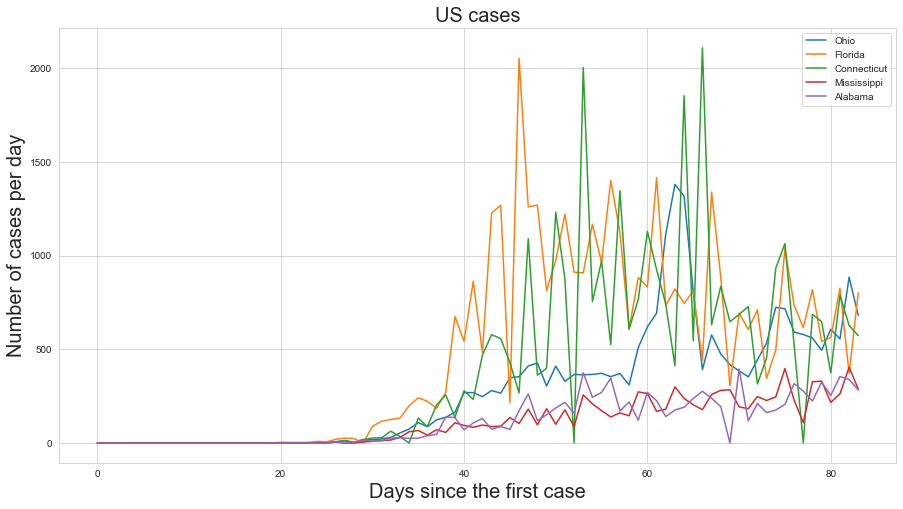

In [372]:
plt.figure(figsize=(15, 8))
plt.title('US cases', fontsize=20)
plt.ylabel('Number of cases per day', fontsize=20)
plt.xlabel('Days since the first case', fontsize=20)
plt.plot(Ohio_dates, Ohio_cases)
plt.plot(Florida_dates,Florida_cases)
plt.plot(Connecticut_dates, connecticut_cases)
plt.plot(Mississippi_dates, Mississippi_cases)
plt.plot(Alabama_dates, Alabama_cases)
plt.legend(['Ohio', 'Florida', 'Connecticut', 'Mississippi', 'Alabama'])

In [373]:
def mobility_rate(string): # Return the mobility rate of a state
    df = US_mobility.loc[US_mobility['State'] == string]
    mob_rate = df['mean'].to_numpy()
    return mob_rate

In [374]:
# Extracting testing data for US states from an API
import json
import urllib
from urllib.request import urlopen
url = 'https://covidtracking.com/api/states/daily'
res = urllib.request.urlopen(url)
rawjson = res.read().decode("utf-8")
datajson = json.loads(rawjson)
datajson

[{'date': 20200510,
  'state': 'AK',
  'positive': 379,
  'negative': 26985,
  'pending': None,
  'hospitalizedCurrently': 8,
  'hospitalizedCumulative': None,
  'inIcuCurrently': None,
  'inIcuCumulative': None,
  'onVentilatorCurrently': None,
  'onVentilatorCumulative': None,
  'recovered': 324,
  'dataQualityGrade': 'C',
  'lastUpdateEt': '5/10/2020 14:00',
  'hash': 'c326467537b8aa4035125d086454fe043009b85a',
  'dateChecked': '2020-05-10T20:00:00Z',
  'death': 10,
  'hospitalized': None,
  'total': 27364,
  'totalTestResults': 27364,
  'posNeg': 27364,
  'fips': '02',
  'deathIncrease': 0,
  'hospitalizedIncrease': 0,
  'negativeIncrease': 914,
  'positiveIncrease': 1,
  'totalTestResultsIncrease': 915},
 {'date': 20200510,
  'state': 'AL',
  'positive': 9777,
  'negative': 117644,
  'pending': None,
  'hospitalizedCurrently': None,
  'hospitalizedCumulative': 1240,
  'inIcuCurrently': None,
  'inIcuCumulative': 460,
  'onVentilatorCurrently': None,
  'onVentilatorCumulative': 274

In [375]:
states_daily = pd.DataFrame(datajson)
states_daily['date'] = pd.to_datetime(states_daily['date'],format="%Y%m%d")
states_daily

,date,state,positive,negative,pending,hospitalizedCurrently,hospitalizedCumulative,inIcuCurrently,inIcuCumulative,onVentilatorCurrently,...,hospitalized,total,totalTestResults,posNeg,fips,deathIncrease,hospitalizedIncrease,negativeIncrease,positiveIncrease,totalTestResultsIncrease
0,2020-05-10,AK,379.0,26985.0,NaN,8.0,NaN,NaN,NaN,NaN,...,NaN,27364,27364,27364,02,0.0,0.0,914.0,1.0,915.0
1,2020-05-10,AL,9777.0,117644.0,NaN,NaN,1240.0,NaN,460.0,NaN,...,1240.0,127421,127421,127421,01,5.0,12.0,1717.0,210.0,1927.0
2,2020-05-10,AR,3747.0,61781.0,NaN,64.0,471.0,NaN,NaN,14.0,...,471.0,65528,65528,65528,05,0.0,0.0,0.0,0.0,0.0
3,2020-05-10,AS,0.0,83.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,83,83,83,60,0.0,0.0,0.0,0.0,0.0
4,2020-05-10,AZ,11119.0,126620.0,NaN,713.0,1528.0,300.0,NaN,195.0,...,1528.0,137739,137739,137739,04,4.0,14.0,8640.0,159.0,8799.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3708,2020-01-26,WA,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,1,1,1,53,0.0,0.0,0.0,0.0,0.0
3709,2020-01-25,WA,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,1,1,1,53,0.0,0.0,0.0,0.0,0.0
3710,2020-01-24,WA,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,1,1,1,53,0.0,0.0,0.0,0.0,0.0
3711,2020-01-23,WA,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,1,1,1,53,0.0,0.0,0.0,0.0,0.0


In [376]:
states_daily = states_daily[(states_daily['date'] < '2020-03-24')] 

In [377]:
states_daily['pos_rate'] = states_daily['positive'] / (states_daily['positive'] + states_daily['negative'])

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [378]:
state_pops = (
                state_pop
                .rename(columns={'State_Code': 'Name', '2019 Estimate': 'Pop'})
                .set_index('Name')
                .loc[:, 'Pop'].to_dict()
)

In [379]:
states_daily['date'] = pd.to_datetime(states_daily['date'],format="%Y%m%d")
states_total_by_dates = states_daily.pivot_table(index='date', columns='state', values='totalTestResults')
states_pos_rate_by_dates = states_daily.pivot_table(index='date', columns='state', values='pos_rate')

C:\Users\User\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [380]:
drop_states = [x for x in states_total_by_dates.columns if x not in list(state_pops.keys())]
states_tests_norm_by_pop = states_total_by_dates.drop(drop_states, axis=1).copy(deep=True)
for state, pop in state_pops.items():
    states_tests_norm_by_pop.loc[:, state] = states_tests_norm_by_pop.loc[:, state] / pop * 1e6

In [381]:
states_tests_norm_by_pop.iloc[3:51,:]

state,AK,AL,AR,AZ,CA,CO,CT,DC,DE,FL,...,SD,TN,TX,UT,VA,VT,WA,WI,WV,WY
date,,,,,,,,,,,,,,,,,,,,,
2020-01-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.131322,NaN,NaN,NaN
2020-01-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.131322,NaN,NaN,NaN
2020-01-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.131322,NaN,NaN,NaN
2020-01-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.131322,NaN,NaN,NaN
2020-01-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.131322,NaN,NaN,NaN
2020-01-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.131322,NaN,NaN,NaN
2020-01-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.131322,NaN,NaN,NaN
2020-02-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.131322,NaN,NaN,NaN
2020-02-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.131322,NaN,NaN,NaN


Text(0.5, 1.0, 'Testing per Million in US states')

<Figure size 720x360 with 0 Axes>

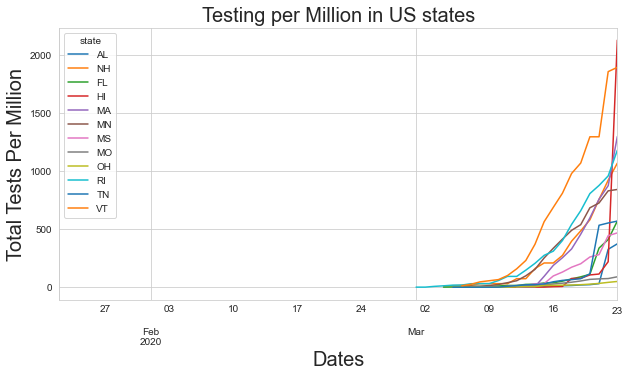

In [382]:
plt.figure(figsize=(10,5))
ax = states_tests_norm_by_pop.loc[:, ['AL', 'NH', 'FL', 'HI', 'MA', 'MN', 'MS', 'MO', 'OH', 'RI', 'TN', 'VT']].plot(figsize=(10,5))
ax.set_xlabel('Dates', fontsize = 20)
ax.set_ylabel('Total Tests Per Million', fontsize = 20)
plt.title('Testing per Million in US states', fontsize=20)

In [383]:
# Mean testing normalized by their population 

states_total_mean = states_tests_norm_by_pop.copy()
states_total_mean.loc['mean'] = states_total_mean.mean()
states_total_mean = states_total_mean.iloc[len(states_total_mean) - 1:]
states_total_mean

state,AK,AL,AR,AZ,CA,CO,CT,DC,DE,FL,...,SD,TN,TX,UT,VA,VT,WA,WI,WV,WY
date,,,,,,,,,,,,,,,,,,,,,
mean,399.231155,49.007761,81.092815,21.672776,121.714235,237.122576,207.820907,324.254239,45.584853,91.748493,...,386.390156,111.310371,62.827889,295.222392,110.880317,639.701448,835.01904,252.58337,60.510909,252.87372


In [384]:
testing_Connecticut = states_total_mean['CT'].to_numpy()
testing_Florida = states_total_mean['FL'].to_numpy()
testing_Alabama = states_total_mean['AL'].to_numpy()
testing_Mississippi = states_total_mean['MS'].to_numpy()
testing_Ohio = states_total_mean['OH'].to_numpy()
testing_Rhode_Island = states_total_mean['RI'].to_numpy()
testing_Massachusetts = states_total_mean['MA'].to_numpy()
testing_Missouri = states_total_mean['MO'].to_numpy()
testing_Tennessee = states_total_mean['TN'].to_numpy()
testing_New_Hampshire = states_total_mean['NH'].to_numpy()
testing_Minnesota = states_total_mean['MN'].to_numpy()
testing_Vermont = states_total_mean['VT'].to_numpy()
testing_Hawaii = states_total_mean['HI'].to_numpy()

<b> Collective Analysis <b>

In [385]:
data = {'States':['Ohio', 'Missouri', 'Mississippi', 'Tennessee', 'Alabama', 'Minnesota', 'Florida', 'Rhode Island','New Hampshire', 'Massachusetts', 'Hawaii', 'Vermont'],
        'Mean GrowthRate of cases':[Mean_Ohio_growth_rate.to_numpy(), Mean_Missouri_growth_rate.to_numpy(), Mean_Mississippi_growth_rate.to_numpy(),Mean_Tennessee_growth_rate.to_numpy(), Mean_Alabama_growth_rate.to_numpy(), Mean_Minnesota_growth_rate.to_numpy(), Mean_Florida_growth_rate.to_numpy(), Mean_Rhode_Island_growth_rate.to_numpy(), Mean_New_Hampshire_growth_rate.to_numpy(), Mean_Massachusetts_growth_rate.to_numpy(), Mean_Hawaii_growth_rate.to_numpy(), Mean_Vermont_growth_rate.to_numpy()],
        'Mobility rate':[mobility_rate('Ohio'), mobility_rate('Missouri'),mobility_rate('Mississippi'), mobility_rate('Tennessee'), mobility_rate('Alabama'), mobility_rate('Minnesota'), mobility_rate('Florida'), mobility_rate('Rhode Island'), mobility_rate('New Hampshire'), mobility_rate('Massachusetts'), mobility_rate('Hawaii'), mobility_rate('Vermont')],
        'Testing':[testing_Ohio, testing_Missouri, testing_Mississippi, testing_Tennessee, testing_Alabama, testing_Minnesota, testing_Florida, testing_Rhode_Island, testing_New_Hampshire, testing_Massachusetts, testing_Hawaii, testing_Vermont],
        'Death Growth Rate':[Mean_Ohio_death_rate.to_numpy(), Mean_Missouri_death_rate.to_numpy(), Mean_Mississippi_death_rate.to_numpy(),Mean_Tennessee_death_rate.to_numpy(), Mean_Alabama_death_rate.to_numpy(), Mean_Minnesota_death_rate.to_numpy(), Mean_Florida_death_rate.to_numpy(), Mean_Rhode_Island_death_rate.to_numpy(), Mean_New_Hampshire_death_rate.to_numpy(), Mean_Massachusetts_death_rate.to_numpy(), Mean_Hawaii_death_rate.to_numpy(), Mean_Vermont_death_rate.to_numpy()]}



mobility_comparison = pd.DataFrame(data) #Loading data to a dataframe 
mobility_comparison

,States,Mean GrowthRate of cases,Mobility rate,Testing,Death Growth Rate
0,Ohio,[15.625],[-2.3333333333333335],[13.863567903341348],[0.875]
1,Missouri,[0.1875],[-13.833333333333334],[30.81382739786496],[0.5625]
2,Mississippi,[9.5625],[-17.5],[126.63423536293934],[0.5]
3,Tennessee,[15.125],[-14.333333333333334],[111.31037146466645],[0.125]
4,Alabama,[7.6875],[-13.166666666666666],[49.007760801817355],[0.0625]
5,Minnesota,[2.875],[-11.5],[306.7083494494361],[0.3125]
6,Florida,[42.5625],[-35.5],[91.74849286961657],[1.5]
7,Rhode Island,[6.625],[-14.333333333333334],[293.6963271090862],[0.5]
8,New Hampshire,[4.375],[-20.0],[269.24839175383596],[0.125]
9,Massachusetts,[42.4375],[-20.0],[404.7876366539122],[0.875]


In [386]:
mobility_comparison = mobility_comparison.set_index('States')
mobility_comparison = mobility_comparison.sort_values(by = 'Mobility rate')
mobility_comparison['Mean GrowthRate of cases'] = pd.to_numeric(mobility_comparison['Mean GrowthRate of cases'].str[0])
mobility_comparison['Mobility rate'] = pd.to_numeric(mobility_comparison['Mobility rate'].str[0])
mobility_comparison['Testing'] = pd.to_numeric(mobility_comparison['Testing'].str[0])
mobility_comparison['Death Growth Rate'] = pd.to_numeric(mobility_comparison['Death Growth Rate'].str[0])
mobility_comparison

,Mean GrowthRate of cases,Mobility rate,Testing,Death Growth Rate
States,,,,
Hawaii,0.5625,-42.166667,161.280780,0.0625
Florida,42.5625,-35.500000,91.748493,1.5000
Vermont,2.7500,-29.000000,639.701448,0.1250
New Hampshire,4.3750,-20.000000,269.248392,0.1250
Massachusetts,42.4375,-20.000000,404.787637,0.8750
Mississippi,9.5625,-17.500000,126.634235,0.5000
Tennessee,15.1250,-14.333333,111.310371,0.1250
Rhode Island,6.6250,-14.333333,293.696327,0.5000
Missouri,0.1875,-13.833333,30.813827,0.5625


In [387]:
mobility_comparison = mobility_comparison.sort_values(by = 'Mean GrowthRate of cases') #Sorting by growthrate
mobility_comparison

,Mean GrowthRate of cases,Mobility rate,Testing,Death Growth Rate
States,,,,
Missouri,0.1875,-13.833333,30.813827,0.5625
Hawaii,0.5625,-42.166667,161.280780,0.0625
Vermont,2.7500,-29.000000,639.701448,0.1250
Minnesota,2.8750,-11.500000,306.708349,0.3125
New Hampshire,4.3750,-20.000000,269.248392,0.1250
Rhode Island,6.6250,-14.333333,293.696327,0.5000
Alabama,7.6875,-13.166667,49.007761,0.0625
Mississippi,9.5625,-17.500000,126.634235,0.5000
Tennessee,15.1250,-14.333333,111.310371,0.1250


In [388]:
mobility_comparison = mobility_comparison.fillna(0)

In [389]:
import seaborn as sns

cm = sns.light_palette("yellow", as_cmap=True)

s = mobility_comparison.style.background_gradient(cmap=cm)
s

,Mean GrowthRate of cases,Mobility rate,Testing,Death Growth Rate
States,,,,
Missouri,0.1875,-13.8333,30.8138,0.5625
Hawaii,0.5625,-42.1667,161.281,0.0625
Vermont,2.75,-29,639.701,0.125
Minnesota,2.875,-11.5,306.708,0.3125
New Hampshire,4.375,-20,269.248,0.125
Rhode Island,6.625,-14.3333,293.696,0.5
Alabama,7.6875,-13.1667,49.0078,0.0625
Mississippi,9.5625,-17.5,126.634,0.5
Tennessee,15.125,-14.3333,111.31,0.125


In [390]:
mobility_comparison2 = mobility_comparison.copy()

In [391]:
mobility_comparison2 = mobility_comparison2.reset_index()
mobility_comparison2 = mobility_comparison2.set_index('States')
mobility_comparison2 = mobility_comparison2.drop([ 'Massachusetts', 'Florida'])

In [392]:
#Normalizing the dataset

from sklearn import preprocessing

x = mobility_comparison2.values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
mobility_comparison2 = pd.DataFrame(x_scaled)

In [393]:
mobility_comparison = mobility_comparison.reset_index()
mobility_comparison2['States'] = mobility_comparison['States']
mobility_comparison2 = mobility_comparison2.rename({0: 'Mean GrowthRate of cases', 1: 'Mobility rate', 2: 'Testing', 3: 'Death Growth Rate'}, axis='columns')
mobility_comparison2 = mobility_comparison2.set_index('States')
mobility_comparison2 = mobility_comparison2.sort_values(by='Mobility rate')

Text(0.5, 0, 'Mobility Rate')

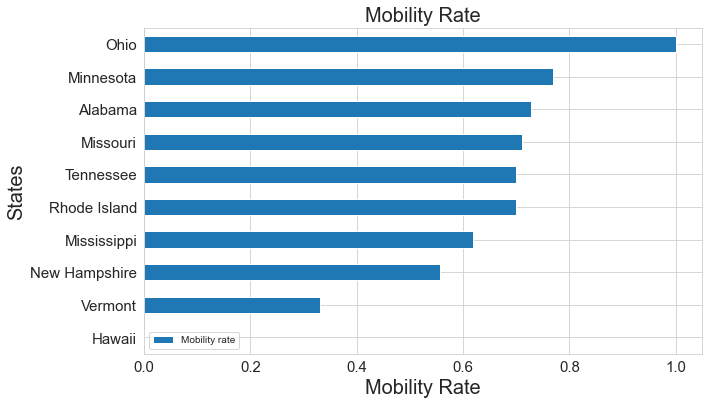

In [394]:
mobility_comparison2.plot.barh(y='Mobility rate', figsize = (10,6), fontsize = 15)
plt.title('Mobility Rate', fontsize = 20)
plt.ylabel('States', fontsize = 20)
plt.xlabel('Mobility Rate', fontsize = 20)

Text(0.5, 0, 'Mean GrowthRate of cases')

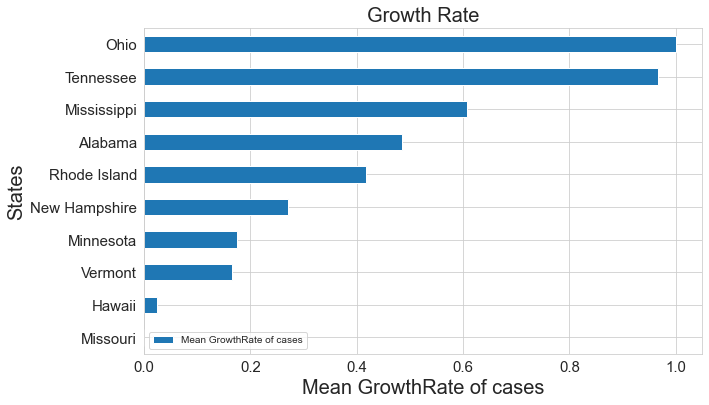

In [395]:
mobility_comparison2 = mobility_comparison2.sort_values(by = 'Mean GrowthRate of cases')
mobility_comparison2.plot.barh(y='Mean GrowthRate of cases', figsize = (10,6), fontsize = 15)
plt.title('Growth Rate', fontsize = 20)
plt.ylabel('States', fontsize = 20)
plt.xlabel('Mean GrowthRate of cases', fontsize = 20)

Text(0.5, 0, 'Tests Per Million')

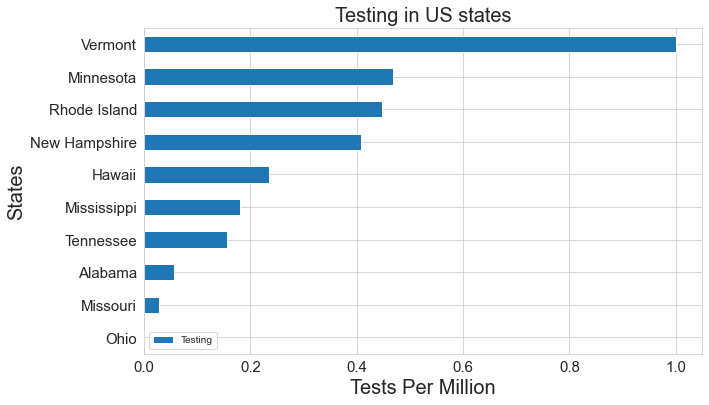

In [396]:
mobility_comparison2 = mobility_comparison2.sort_values(by = 'Testing')
mobility_comparison2.plot.barh(y='Testing', figsize = (10,6), fontsize = 15)
plt.title('Testing in US states', fontsize = 20)
plt.ylabel('States', fontsize = 20)
plt.xlabel('Tests Per Million', fontsize = 20)

In [397]:
mobility_comparison3 = mobility_comparison2.copy() 
mobility_comparison3

,Mean GrowthRate of cases,Mobility rate,Testing,Death Growth Rate
States,,,,
Ohio,1.000000,1.000000,0.000000,1.000000
Missouri,0.000000,0.711297,0.027084,0.615385
Alabama,0.485830,0.728033,0.056155,0.000000
Tennessee,0.967611,0.698745,0.155706,0.076923
Mississippi,0.607287,0.619247,0.180192,0.538462
Hawaii,0.024291,0.000000,0.235552,0.000000
New Hampshire,0.271255,0.556485,0.408069,0.076923
Rhode Island,0.417004,0.698745,0.447133,0.538462
Minnesota,0.174089,0.769874,0.467924,0.307692


In [398]:
mobility_comparison2.sort_values(by='Mobility rate') # Sorting the dataframw mobility rate 

,Mean GrowthRate of cases,Mobility rate,Testing,Death Growth Rate
States,,,,
Hawaii,0.024291,0.000000,0.235552,0.000000
Vermont,0.165992,0.330544,1.000000,0.076923
New Hampshire,0.271255,0.556485,0.408069,0.076923
Mississippi,0.607287,0.619247,0.180192,0.538462
Tennessee,0.967611,0.698745,0.155706,0.076923
Rhode Island,0.417004,0.698745,0.447133,0.538462
Missouri,0.000000,0.711297,0.027084,0.615385
Alabama,0.485830,0.728033,0.056155,0.000000
Minnesota,0.174089,0.769874,0.467924,0.307692


In [399]:
mobility_comparison3 = mobility_comparison3.reset_index()

In [400]:
mobility_comparison4 = mobility_comparison3.copy()
mobility_comparison4 = mobility_comparison4.set_index('States')
#mobility_comparison4 = mobility_comparison4.drop(['Florida','Massachusetts'])
mobility_comparison4.index

Index(['Ohio', 'Missouri', 'Alabama', 'Tennessee', 'Mississippi', 'Hawaii',
       'New Hampshire', 'Rhode Island', 'Minnesota', 'Vermont'],
      dtype='object', name='States')

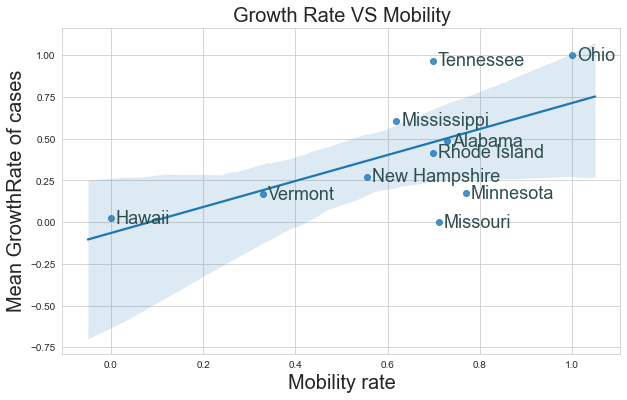

In [401]:
mobility_comparison4 = mobility_comparison4.reset_index()
x= mobility_comparison4['Mobility rate']
y= mobility_comparison4['Mean GrowthRate of cases']
n = mobility_comparison4['States']


plt.figure(figsize = (10,6))
fig = sns.regplot(x="Mobility rate", y="Mean GrowthRate of cases", data=mobility_comparison4);


plt.title("Growth Rate VS Mobility", fontsize=20)
plt.xlabel("Mobility rate", fontsize=20)
plt.ylabel("Mean GrowthRate of cases", fontsize=20)
for i, txt in enumerate(n):
    fig.annotate(txt, (x[i], y[i]),xytext=(5,-5), textcoords='offset points',family='sans-serif', fontsize=18, color='darkslategrey')

There is a trend observed that with higher mobility rate, a state tends to have higher growth rate.

In [402]:
mobility_comparison2 = mobility_comparison2.reset_index()
mobility_comparison2 = mobility_comparison2.set_index('States')
mobility_comparison2 = mobility_comparison2.reset_index()

In [403]:
mobility_comparison2 = mobility_comparison2.set_index('States')
mobility_comparison2 = mobility_comparison2.reset_index()

In [404]:
mobility_comparison4

,States,Mean GrowthRate of cases,Mobility rate,Testing,Death Growth Rate
0,Ohio,1.000000,1.000000,0.000000,1.000000
1,Missouri,0.000000,0.711297,0.027084,0.615385
2,Alabama,0.485830,0.728033,0.056155,0.000000
3,Tennessee,0.967611,0.698745,0.155706,0.076923
4,Mississippi,0.607287,0.619247,0.180192,0.538462
5,Hawaii,0.024291,0.000000,0.235552,0.000000
6,New Hampshire,0.271255,0.556485,0.408069,0.076923
7,Rhode Island,0.417004,0.698745,0.447133,0.538462
8,Minnesota,0.174089,0.769874,0.467924,0.307692
9,Vermont,0.165992,0.330544,1.000000,0.076923


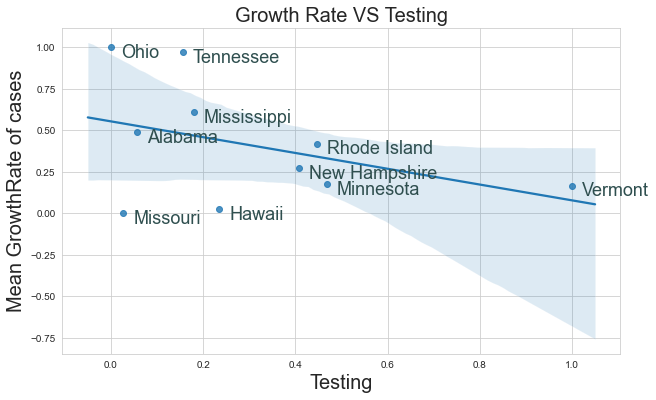

In [405]:
x= mobility_comparison4['Testing']
y= mobility_comparison4['Mean GrowthRate of cases']
n = mobility_comparison4['States']


plt.figure(figsize = (10,6))
fig = sns.regplot(x="Testing", y="Mean GrowthRate of cases", data=mobility_comparison4);


plt.title("Growth Rate VS Testing", fontsize=20)
plt.xlabel("Testing", fontsize=20)
plt.ylabel("Mean GrowthRate of cases", fontsize=20)
for i, txt in enumerate(n):
    fig.annotate(txt, (x[i], y[i]),xytext=(10,-10), textcoords='offset points',family='sans-serif', fontsize=18, color='darkslategrey')

We can see there is a slight tendency that a country would have a higher growth rate of cases if they have done low testing.

Text(0.5, 0, 'Testing')

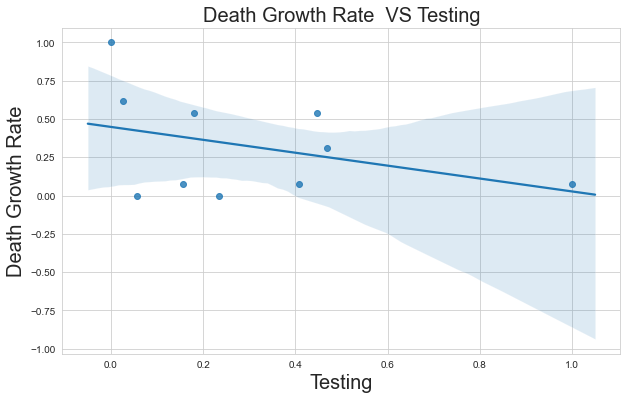

In [406]:
plt.figure(figsize = (10,6))
fig = sns.regplot(x="Testing", y="Death Growth Rate", data=mobility_comparison2);
plt.title("Death Growth Rate  VS Testing", fontsize=20)
plt.ylabel('Death Growth Rate', fontsize=20)
plt.xlabel('Testing', fontsize = 20)


Text(0.5, 1.0, 'Impact of factors on each other')

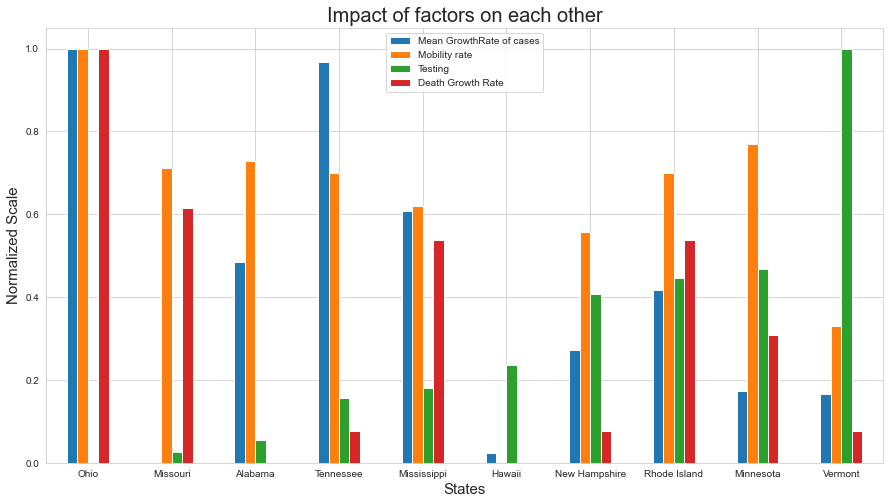

In [407]:
mobility_comparison2 = mobility_comparison2.set_index('States')
mobility_comparison2.plot.bar(rot=0, figsize=(15, 8))
mobility_comparison2 = mobility_comparison2.reset_index()
plt.xlabel('States', fontsize =15)
plt.ylabel('Normalized Scale', fontsize = 15)
plt.title('Impact of factors on each other', fontsize =20)

Different Factors can be seen influencing each other. 

Text(0, 0.5, 'Total tests per million')

<Figure size 720x360 with 0 Axes>

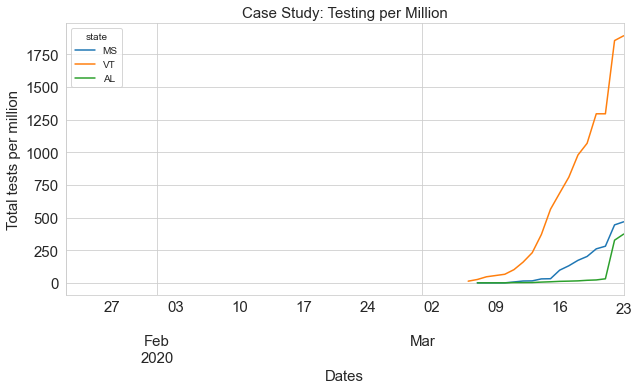

In [408]:
plt.figure(figsize=(10,5))
ax = states_tests_norm_by_pop.loc[:, ['MS','VT', 'AL']].plot(figsize=(10,5), fontsize = 15)
ax.set_xlabel('Dates')
ax.set_ylabel('Total Tests Per Million')
plt.title('Case Study: Testing per Million', fontsize = 15)
plt.xlabel('Dates', fontsize = 15)
plt.ylabel('Total tests per million', fontsize = 15)

Case Study of three states: It is noticed a state with high testing has a low growth rate. The graph is given below.

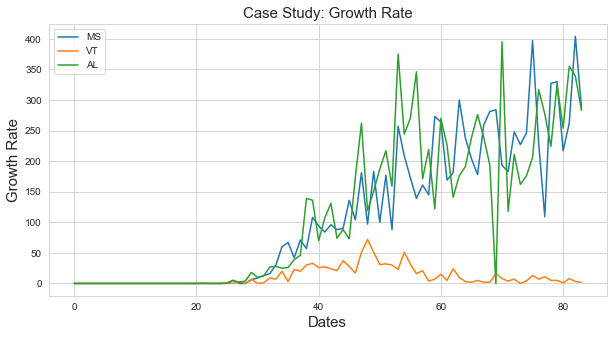

In [409]:
plt.figure(figsize=(10,5))
plt.plot(Mississippi_dates, Mississippi_cases)
plt.plot(Vermont_dates, Vermont_cases)
plt.plot(Alabama_dates, Alabama_cases)
plt.title('Case Study: Growth Rate', fontsize = 15)
plt.xlabel('Dates', fontsize = 15)
plt.ylabel('Growth Rate', fontsize = 15)
plt.legend(['MS','VT', 'AL'])

In [410]:
mob_comp = mobility_comparison2.copy()
mob_comp = mob_comp.set_index('States')
#mob_comp.drop(["Mississippi"], inplace = True) #Dropping the extreme outliers
mob_comp

,Mean GrowthRate of cases,Mobility rate,Testing,Death Growth Rate
States,,,,
Ohio,1.000000,1.000000,0.000000,1.000000
Missouri,0.000000,0.711297,0.027084,0.615385
Alabama,0.485830,0.728033,0.056155,0.000000
Tennessee,0.967611,0.698745,0.155706,0.076923
Mississippi,0.607287,0.619247,0.180192,0.538462
Hawaii,0.024291,0.000000,0.235552,0.000000
New Hampshire,0.271255,0.556485,0.408069,0.076923
Rhode Island,0.417004,0.698745,0.447133,0.538462
Minnesota,0.174089,0.769874,0.467924,0.307692


In [411]:
mob_comp = mob_comp.fillna(0)

In [412]:
mob_comp = mob_comp.drop(['Death Growth Rate'], axis=1)

In [413]:
exp = mob_comp.iloc[:, 0:4]
print(exp.describe())

       Mean GrowthRate of cases  Mobility rate    Testing
count                 10.000000      10.000000  10.000000
mean                   0.411336       0.611297   0.297781
std                    0.358244       0.272994   0.300878
min                    0.000000       0.000000   0.000000
25%                    0.168016       0.572176   0.081043
50%                    0.344130       0.698745   0.207872
75%                    0.576923       0.723849   0.437367
max                    1.000000       1.000000   1.000000


In [414]:
X =exp.iloc[:,exp.columns != 'Mean GrowthRate of cases']
Y = exp.iloc[:, 0]
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state= 0)

In [415]:
#Running multiple linear regression 

model = linear_model.LinearRegression()
model.fit(X_train, Y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [416]:
coeff_df = pd.DataFrame(model.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Mobility rate,0.846825
Testing,-0.098116


In [417]:
data = pd.read_csv("data_csv.csv") #Reading csv with country codes
data

,Name,Code
0,Afghanistan,AF
1,Åland Islands,AX
2,Albania,AL
3,Algeria,DZ
4,American Samoa,AS
...,...,...
244,Wallis and Futuna,WF
245,Western Sahara,EH
246,Yemen,YE
247,Zambia,ZM


In [418]:

mobility_world = pd.read_csv("mobility_total_world.csv")
mobility_world = mobility_world.rename({"Country": 'Code'}, axis='columns')
mobility_world

,Code,Date,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,Residential
0,AE,2020-03-29,-55.0,-26.0,-53.0,-69.0,-45.0,26.0
1,AF,2020-03-29,-38.0,-21.0,-13.0,-34.0,-33.0,10.0
2,AG,2020-03-29,-46.0,-21.0,-30.0,-67.0,-48.0,NaN
3,AO,2020-03-29,-61.0,-40.0,-39.0,-57.0,-11.0,22.0
4,AR,2020-03-29,-86.0,-61.0,-89.0,-80.0,-57.0,27.0
...,...,...,...,...,...,...,...,...
257,VN,2020-04-11,-59.0,-33.0,-43.0,-58.0,-29.0,21.0
258,YE,2020-04-11,-9.0,-1.0,-8.0,-13.0,-6.0,6.0
259,ZA,2020-04-11,-75.0,-46.0,-58.0,-78.0,-56.0,27.0
260,ZM,2020-04-11,-26.0,-16.0,-4.0,-28.0,-16.0,13.0


In [419]:
mobility_world = mobility_world[-131:]
mobility_world

,Code,Date,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,Residential
131,AE,2020-04-11,-64.0,-32.0,-77.0,-79.0,-45.0,24.0
132,AF,2020-04-11,-46.0,-32.0,-12.0,-50.0,-38.0,16.0
133,AG,2020-04-11,-70.0,-45.0,-56.0,-83.0,-68.0,NaN
134,AO,2020-04-11,-53.0,-32.0,-37.0,-44.0,-31.0,22.0
135,AR,2020-04-11,-84.0,-34.0,-80.0,-67.0,-52.0,27.0
...,...,...,...,...,...,...,...,...
257,VN,2020-04-11,-59.0,-33.0,-43.0,-58.0,-29.0,21.0
258,YE,2020-04-11,-9.0,-1.0,-8.0,-13.0,-6.0,6.0
259,ZA,2020-04-11,-75.0,-46.0,-58.0,-78.0,-56.0,27.0
260,ZM,2020-04-11,-26.0,-16.0,-4.0,-28.0,-16.0,13.0


In [420]:
mobility_world = pd.merge(mobility_world, data, on = "Code") #Merging dataset
mobility_world

,Code,Date,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,Residential,Name
0,AE,2020-04-11,-64.0,-32.0,-77.0,-79.0,-45.0,24.0,United Arab Emirates
1,AF,2020-04-11,-46.0,-32.0,-12.0,-50.0,-38.0,16.0,Afghanistan
2,AG,2020-04-11,-70.0,-45.0,-56.0,-83.0,-68.0,NaN,Antigua and Barbuda
3,AO,2020-04-11,-53.0,-32.0,-37.0,-44.0,-31.0,22.0,Angola
4,AR,2020-04-11,-84.0,-34.0,-80.0,-67.0,-52.0,27.0,Argentina
...,...,...,...,...,...,...,...,...,...
126,VN,2020-04-11,-59.0,-33.0,-43.0,-58.0,-29.0,21.0,Viet Nam
127,YE,2020-04-11,-9.0,-1.0,-8.0,-13.0,-6.0,6.0,Yemen
128,ZA,2020-04-11,-75.0,-46.0,-58.0,-78.0,-56.0,27.0,South Africa
129,ZM,2020-04-11,-26.0,-16.0,-4.0,-28.0,-16.0,13.0,Zambia


In [421]:
mobility_world = mobility_world.drop(['Code','Date'], axis = 1)
mobility_world

,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,Residential,Name
0,-64.0,-32.0,-77.0,-79.0,-45.0,24.0,United Arab Emirates
1,-46.0,-32.0,-12.0,-50.0,-38.0,16.0,Afghanistan
2,-70.0,-45.0,-56.0,-83.0,-68.0,NaN,Antigua and Barbuda
3,-53.0,-32.0,-37.0,-44.0,-31.0,22.0,Angola
4,-84.0,-34.0,-80.0,-67.0,-52.0,27.0,Argentina
...,...,...,...,...,...,...,...
126,-59.0,-33.0,-43.0,-58.0,-29.0,21.0,Viet Nam
127,-9.0,-1.0,-8.0,-13.0,-6.0,6.0,Yemen
128,-75.0,-46.0,-58.0,-78.0,-56.0,27.0,South Africa
129,-26.0,-16.0,-4.0,-28.0,-16.0,13.0,Zambia


In [422]:
mobility_world =mobility_world.drop(['Residential'], axis = 1)
mobility_world = mobility_world.set_index('Name')
mobility_world['mean'] = mobility_world.mean(axis=1) #Calculating mean mobility
mobility_world

,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,mean
Name,,,,,,
United Arab Emirates,-64.0,-32.0,-77.0,-79.0,-45.0,-59.4
Afghanistan,-46.0,-32.0,-12.0,-50.0,-38.0,-35.6
Antigua and Barbuda,-70.0,-45.0,-56.0,-83.0,-68.0,-64.4
Angola,-53.0,-32.0,-37.0,-44.0,-31.0,-39.4
Argentina,-84.0,-34.0,-80.0,-67.0,-52.0,-63.4
...,...,...,...,...,...,...
Viet Nam,-59.0,-33.0,-43.0,-58.0,-29.0,-44.4
Yemen,-9.0,-1.0,-8.0,-13.0,-6.0,-7.4
South Africa,-75.0,-46.0,-58.0,-78.0,-56.0,-62.6


In [423]:
mobility_world =mobility_world.sort_values(by='mean') #Sorting by mean
mobility_world

,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,mean
Name,,,,,,
Bahamas,-97.0,-97.0,-84.0,-95.0,-79.0,-90.4
Panama,-96.0,-95.0,-86.0,-91.0,-84.0,-90.4
"Macedonia, the Former Yugoslav Republic of",-95.0,-95.0,-79.0,-93.0,-82.0,-88.8
Jordan,-93.0,-89.0,-78.0,-95.0,-81.0,-87.2
Turkey,-92.0,-83.0,-81.0,-90.0,-78.0,-84.8
...,...,...,...,...,...,...
Yemen,-9.0,-1.0,-8.0,-13.0,-6.0,-7.4
Sweden,-41.0,-15.0,84.0,-36.0,-24.0,-6.4
Tajikistan,-9.0,-8.0,-14.0,-15.0,15.0,-6.2


In [424]:
mobility_world = mobility_world.fillna(0) #Cleaning the data 
mobility_world

,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,mean
Name,,,,,,
Bahamas,-97.0,-97.0,-84.0,-95.0,-79.0,-90.4
Panama,-96.0,-95.0,-86.0,-91.0,-84.0,-90.4
"Macedonia, the Former Yugoslav Republic of",-95.0,-95.0,-79.0,-93.0,-82.0,-88.8
Jordan,-93.0,-89.0,-78.0,-95.0,-81.0,-87.2
Turkey,-92.0,-83.0,-81.0,-90.0,-78.0,-84.8
...,...,...,...,...,...,...
Yemen,-9.0,-1.0,-8.0,-13.0,-6.0,-7.4
Sweden,-41.0,-15.0,84.0,-36.0,-24.0,-6.4
Tajikistan,-9.0,-8.0,-14.0,-15.0,15.0,-6.2


In [425]:
import geopandas as gpd
#Read shapefile using Geopandas
gdf = gpd.read_file('Countries_WGS84.shp')[['CNTRY_NAME', 'geometry']]
#Rename columns.
gdf.columns = ['country', 'geometry']
gdf

,country,geometry
0,Aruba,"POLYGON ((-69.88223 12.41111, -69.94695 12.436..."
1,Antigua and Barbuda,"MULTIPOLYGON (((-61.73889 17.54055, -61.75195 ..."
2,Afghanistan,"POLYGON ((61.27656 35.60725, 61.29638 35.62853..."
3,Algeria,"POLYGON ((-5.15213 30.18047, -5.13917 30.19236..."
4,Azerbaijan,"MULTIPOLYGON (((45.02583 41.03055, 45.00999 41..."
...,...,...
246,Western Samoa,"MULTIPOLYGON (((-172.59650 -13.50911, -172.551..."
247,Swaziland,"POLYGON ((30.89944 -26.77195, 30.88028 -26.793..."
248,Yemen,"MULTIPOLYGON (((48.68639 14.03750, 48.61000 14..."
249,Zambia,"POLYGON ((30.21302 -14.98172, 30.21917 -15.096..."


In [426]:
gdf = gdf.drop(gdf.index[14])
merged = gdf.merge(mobility_world, left_on = 'country', right_on = 'Name', how = 'left')
merged.fillna('No data', inplace = True)
import json
#Read data to json.
merged_json = json.loads(merged.to_json())
#Convert to String like object.
json_data = json.dumps(merged_json)

In [427]:
merged

,country,geometry,Retail & recreation,Grocery & pharmacy,Parks,Transit stations,Workplaces,mean
0,Aruba,"POLYGON ((-69.88223 12.41111, -69.94695 12.436...",-71,-18,-52,-76,-64,-56.2
1,Antigua and Barbuda,"MULTIPOLYGON (((-61.73889 17.54055, -61.75195 ...",-70,-45,-56,-83,-68,-64.4
2,Afghanistan,"POLYGON ((61.27656 35.60725, 61.29638 35.62853...",-46,-32,-12,-50,-38,-35.6
3,Algeria,"POLYGON ((-5.15213 30.18047, -5.13917 30.19236...",No data,No data,No data,No data,No data,No data
4,Azerbaijan,"MULTIPOLYGON (((45.02583 41.03055, 45.00999 41...",No data,No data,No data,No data,No data,No data
...,...,...,...,...,...,...,...,...
245,Western Samoa,"MULTIPOLYGON (((-172.59650 -13.50911, -172.551...",No data,No data,No data,No data,No data,No data
246,Swaziland,"POLYGON ((30.89944 -26.77195, 30.88028 -26.793...",No data,No data,No data,No data,No data,No data
247,Yemen,"MULTIPOLYGON (((48.68639 14.03750, 48.61000 14...",-9,-1,-8,-13,-6,-7.4
248,Zambia,"POLYGON ((30.21302 -14.98172, 30.21917 -15.096...",-26,-16,-4,-28,-16,-18


In [428]:
from bokeh.io import output_notebook, show, output_file
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar
from bokeh.palettes import brewer
from bokeh.io import curdoc, output_notebook
from bokeh.models import Slider, HoverTool
from bokeh.layouts import widgetbox, row, column
#Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = json_data)
#Define a sequential multi-hue color palette.
palette = brewer['YlGnBu'][6]
#Reverse color order so that dark blue is highest obesity.
palette = palette[::-1]
#Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
color_mapper = LinearColorMapper(palette = palette, low = -60, high = -20, nan_color = '#d9d9d9')
#Define custom tick labels for color bar.
tick_labels = {'-20': '-20', '-30': '-30', '-40':'-40', '-50':'-50', '-55':'-55', '-60':'>60'}
#Create color bar. 
hover = HoverTool(tooltips = [ ('country','@country'),('Mobility', '@mean')])
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels)
#Create figure object.
p = figure(title = 'Mean Mobility across the globe', plot_height = 600 , plot_width = 950, toolbar_location = None, tools = [hover])
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None
#Add patch renderer to figure. 
p.patches('xs','ys', source = geosource,fill_color = {'field' :'mean', 'transform' : color_mapper},
          line_color = 'black', line_width = 0.25, fill_alpha = 1)
#Specify figure layout.
p.add_layout(color_bar, 'below')
#Display figure inline in Jupyter Notebook.
output_notebook()
#Display figure.
show(p)

Loading BokehJS ...

From this visualization of the world map above, We can see how bad US is doing even it terms of mobility. The mobility has decreased only by 31% as of 11th April. The darker the colour gets, the higher is basically the mobility rates.

In [429]:
world_testing = pd.read_csv("full-list-cumulative-total-tests-per-thousand (3).csv") #Reading testing per thousand people 
world_testing['Date'] = pd.to_datetime(world_testing['Date'])
world_testing = world_testing.drop(['Code'], axis = 1)

Germany = world_testing.loc[world_testing['Entity'] == 'Germany']
Germany

,Entity,Date,Total tests per thousand
925,Germany,2020-03-08,1.511
926,Germany,2020-03-15,3.055
927,Germany,2020-03-22,7.279
928,Germany,2020-03-29,11.657
929,Germany,2020-04-05,16.602
930,Germany,2020-04-12,21.192
931,Germany,2020-04-19,25.111


In [430]:
Germany.columns

Index(['Entity', 'Date', 'Total tests per thousand'], dtype='object')

In [431]:
Australia = world_testing.loc[world_testing['Entity'] == 'Australia']
Canada = world_testing.loc[world_testing['Entity'] == 'Canada']
Denmark = world_testing.loc[world_testing['Entity'] == 'Denmark']
Ireland = world_testing.loc[world_testing['Entity'] == 'Ireland']
Italy = world_testing.loc[world_testing['Entity'] == 'Italy']
New_Zealand = world_testing.loc[world_testing['Entity'] == 'New Zealand']
Singapore = world_testing.loc[world_testing['Entity'] == 'Singapore']
South_Korea = world_testing.loc[world_testing['Entity'] == 'South Korea']
Spain = world_testing.loc[world_testing['Entity'] == 'Spain']
United_States = world_testing.loc[world_testing['Entity'] == 'United States']

In [432]:
UK = world_testing.loc[world_testing['Entity'] == 'United Kingdom']
UK

,Entity,Date,Total tests per thousand
3133,United Kingdom,2020-01-26,0.001
3134,United Kingdom,2020-01-27,0.001
3135,United Kingdom,2020-01-28,0.001
3136,United Kingdom,2020-01-29,0.002
3137,United Kingdom,2020-01-30,0.002
...,...,...,...
3220,United Kingdom,2020-04-22,6.107
3221,United Kingdom,2020-04-23,6.324
3222,United Kingdom,2020-04-24,6.597
3223,United Kingdom,2020-04-25,7.691


In [433]:
Ireland = Ireland.set_index('Date')
Germany = Germany.set_index('Date')
Italy = Italy.set_index('Date')
New_Zealand = New_Zealand.set_index('Date')
Singapore = Singapore.set_index('Date')
Spain = Spain.set_index('Date')
United_States = United_States.set_index('Date')

In [434]:
UK = UK.set_index('Date')

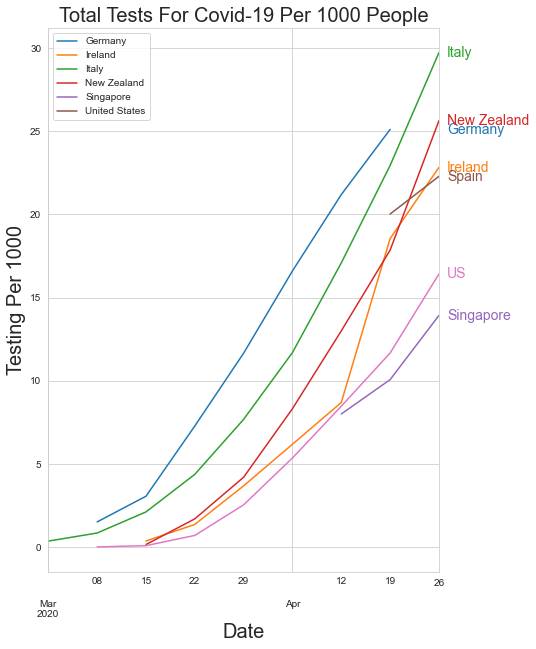

In [435]:
list_country = ['Germany', 'Ireland', 'Italy', 'New Zealand', 'Singapore', 'Spain', 'US']

ax = Germany.plot.line(figsize=(7,10))
#Australia.plot.line(ax=ax)
#Canada.plot.line(ax=ax)
#Denmark.plot.line(ax=ax)
Ireland.plot.line(ax=ax)
Italy.plot.line(ax=ax)
New_Zealand.plot.line(ax=ax)
Singapore.plot.line(ax=ax)
Spain.plot.line(ax=ax)
United_States.plot.line(ax=ax)
plt.title('Total Tests For Covid-19 Per 1000 People', fontsize =20)
plt.legend(['Germany', 'Ireland', 'Italy', 'New Zealand', 'Singapore', 'United States'])
plt.xlabel('Date', fontsize =20)
plt.ylabel('Testing Per 1000', fontsize =20)

for line, name in zip(ax.lines, list_country):
    y = line.get_ydata()[-1]
    ax.annotate(name, xy=(1,y), xytext=(8,0), color=line.get_color(), 
                xycoords = ax.get_yaxis_transform(), textcoords="offset points",
                size=14, va="center")


We can see how far is US lagging behind in testing compared to few other affected countries.

In [436]:
import plotly.express as px
import plotly.graph_objects as go
United_States = United_States.reset_index()
fig = px.line(United_States, x='Date', y='Total tests per thousand', title = 'Total Tests For Covid-19 Per 1000 People in US')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

In this graph above, it is noticed that testing started very late in US. Until 23rd March, less than 1 test per 1000 people were conducted.

In [437]:
import plotly.express as px
import plotly.graph_objects as go
UK = UK.reset_index()
fig = px.line(UK, x='Date', y='Total tests per thousand', title = 'Total Tests For Covid-19 Per 1000 People in UK')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

# Conclusion

## Ethical Considerations

1. No personal identity (like names, date of birth) has been revealed. 
2. Data taken from an opensource framework and verified sources.
3. Research projects are subject to risk when it comes to getting misused. 
4. Confusion might arise between co-relation and causation. 

## Data Reproducibility and Data Quality

1. Can be used further to check how some of the factors are behaving.
2. With so much COVID-19 data flying around, it’s best to take the data with a grain of salt as it might have been influenced by political reasons. 
3. Enough sources of data to use those ranges of prediction in order to establish some level of confidence. 


## Final Takeaway

1. Some factors like testing and mobility observed affecting the severity of the outbreak globally. 
2. Testing and Mobility found to have a co-relation with growth rate. 
3. Higher the testing, the lesser the growth rate is likely to be in future.
4. Similarly, a country with less mobility is likely to have a less growth rate.
5. These events should not be taken for granted as there are other factors at play.
